# Data description: 
This dataset describes the number of daily female births in California in 1959. The units are a count and there are 365 observations. The source of the dataset is credited to Newton (1988). 

# Workflow:
- Load the Time Series (TS) by Pandas Library

 # 1)  Exploration of Time Series:
- TS Line, Histogram & Probability plots
- TS Line & Box plots by intervals
- TS Lag plots
- Check the stationarity of TS, by:
     - Plotting rolling mean & standard deviation
     - Perform Dickey-Fuller test
     - Decomposition of TS into Trend, Seasonal part and residuals

 #  2) Seasonal ARIMA model:
- Build and evaluate the Seasonal ARIMA model: 
     - Grid-Search for the best ARIMA parameters
     - Fit the best ARIMA model
     - Evaluate model by in-sample prediction: Calculate RMSE

In [2]:
import numpy as np
from scipy import stats
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random as rn
%matplotlib inline

import os
os.environ['PYTHONHASHSEED'] = '0'

# for the reproducable results:
np.random.seed(42)
rn.seed(42)

import warnings
warnings.filterwarnings("ignore")

In [3]:
# Load data using Series.from_csv
from pandas import Series
#TS = Series.from_csv('C:/Users/rhash/Documents/Datasets/Time Series analysis/daily-total-female-births-in-cal.csv', header=0)

# Load data using pandas.read_csv
# in case, specify your own date parsing function and use the date_parser argument
from pandas import read_csv
TS = read_csv('C:/Users/rhash/Documents/Datasets/Time Series analysis/daily-total-female-births-in-cal.csv', header=0, parse_dates=[0], index_col=0, squeeze=True)

print(TS.head())

Date
1959-01-01    35
1959-01-02    32
1959-01-03    30
1959-01-04    31
1959-01-05    44
Name: Daily total female births in California, 1959, dtype: int64


In [4]:
TS.index

DatetimeIndex(['1959-01-01', '1959-01-02', '1959-01-03', '1959-01-04',
               '1959-01-05', '1959-01-06', '1959-01-07', '1959-01-08',
               '1959-01-09', '1959-01-10',
               ...
               '1959-12-22', '1959-12-23', '1959-12-24', '1959-12-25',
               '1959-12-26', '1959-12-27', '1959-12-28', '1959-12-29',
               '1959-12-30', '1959-12-31'],
              dtype='datetime64[ns]', name='Date', length=365, freq=None)

In [5]:
TS.describe()

count    365.000000
mean      41.980822
std        7.348257
min       23.000000
25%       37.000000
50%       42.000000
75%       46.000000
max       73.000000
Name: Daily total female births in California, 1959, dtype: float64

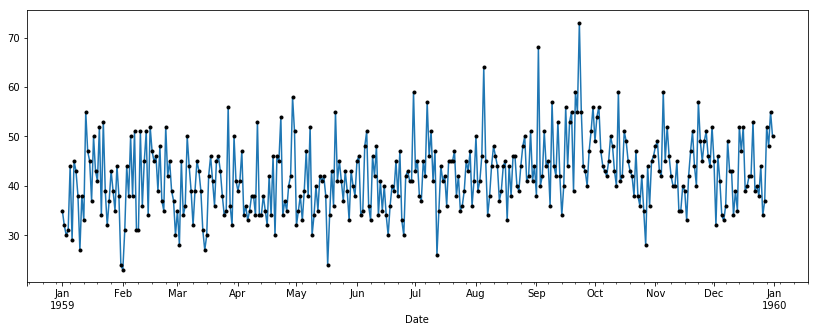

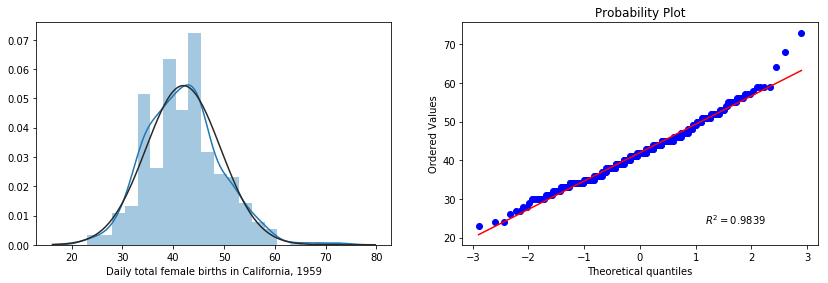

In [6]:
# Time Series Line Plot: _________________________________________
plt.figure(figsize=(14, 5))
TS.plot()
TS.plot(style="k.")
plt.show()

#Time Series Histogram and Density Plot:
fig = plt.figure(figsize=(14, 9))
ax1 = fig.add_subplot(221)
ax1=sns.distplot(TS, fit=stats.norm)
    
ax2 = fig.add_subplot(222)
res=stats.probplot(TS, plot=ax2, rvalue=True)

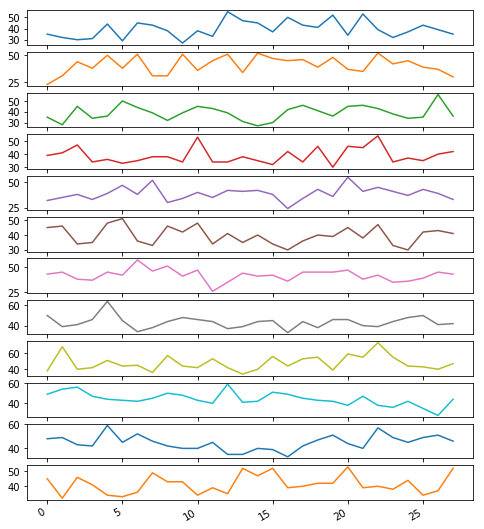

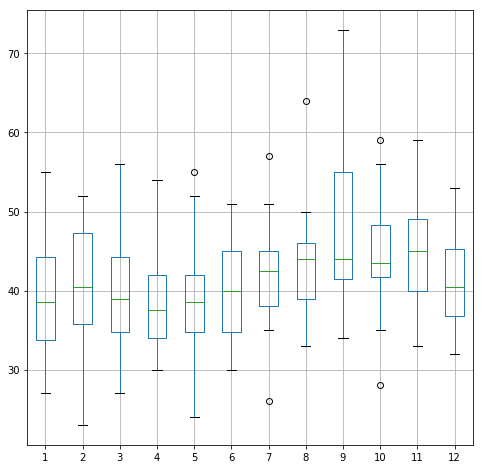

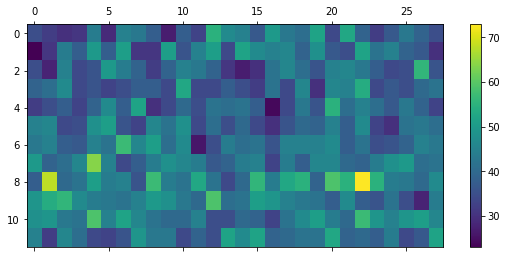

In [7]:
# Time Series Line, Box and Whisker Plots by Intervals: _________________________________________________
from pandas import Series
from pandas import DataFrame
from pandas import TimeGrouper

groups = TS.groupby(TimeGrouper('M'))
months = DataFrame()

for name, group in groups:
    months[ name.month]=group.values[0:28]
    
months.plot(subplots=True, legend=False, figsize=(8,10))
plt.show()

months.boxplot(figsize=(8,8))
plt.show()

plt.matshow(months.T, interpolation=None, aspect='auto')
plt.colorbar()
plt.show()

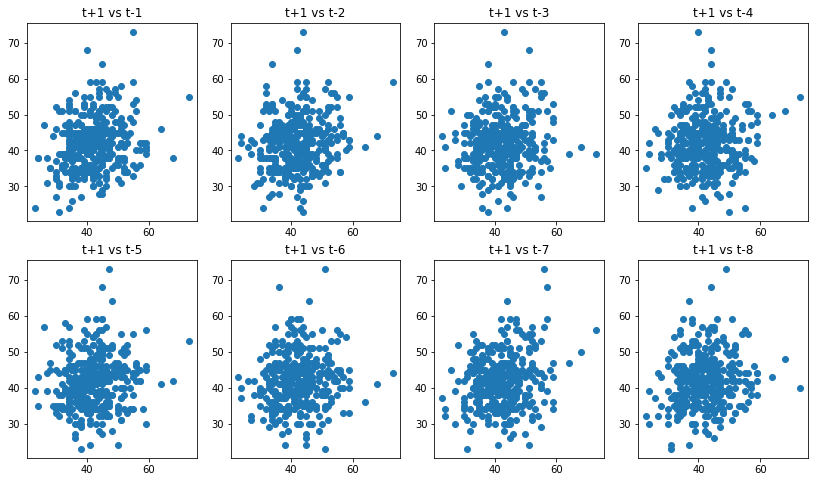

In [8]:
# Time Series Lag Scatter Plots: ____________________________________________________
from pandas import concat
from pandas.plotting import scatter_matrix

plt.figure(figsize=(14, 8))

values = DataFrame(TS.values)
lags = 8
columns = [values]
for i in range(1,(lags + 1)):
    columns.append(values.shift(i))
dataframe = concat(columns, axis=1)
columns = ['t+1']

for i in range(1,(lags + 1)):
    columns.append('t-' + str(i))
dataframe.columns = columns
plt.figure(1)

for i in range(1,(lags + 1)):
    ax = plt.subplot(240 + i)
    ax.set_title('t+1 vs t-' + str(i))
    plt.scatter(x=dataframe['t+1'].values, y=dataframe['t-'+str(i)].values)

plt.show()

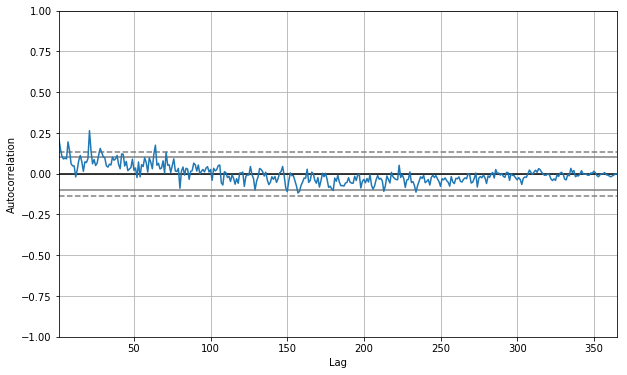

In [9]:
#Time Series Autocorrelation Plot: ________________________________________________________
from pandas.tools.plotting import autocorrelation_plot

plt.figure(figsize=(10, 6))
autocorrelation_plot(TS)
plt.show()

In [10]:
# To check the stationarity of Time Series: _________________________________________________
from statsmodels.tsa.stattools import adfuller

def test_stationarity(timeseries, win=12):
    
    #Determing rolling statistics
    rolmean = timeseries.rolling(window=win).mean()
    rolstd = timeseries.rolling(window=win).std()

    #Plot rolling statistics:
    plt.figure(figsize=(15, 5))
    orig = plt.plot(timeseries, color='blue',label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
        
    print(dfoutput)

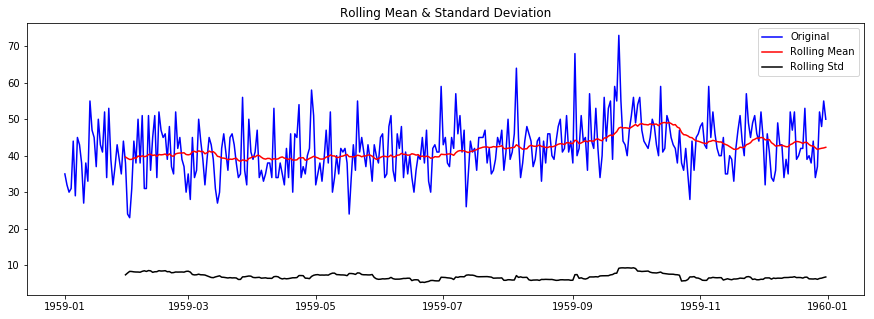

Results of Dickey-Fuller Test:
Test Statistic                  -4.808291
p-value                          0.000052
#Lags Used                       6.000000
Number of Observations Used    358.000000
Critical Value (1%)             -3.448749
Critical Value (5%)             -2.869647
Critical Value (10%)            -2.571089
dtype: float64


In [11]:
test_stationarity(TS, win=30)

In [15]:
import statsmodels.api as sm

# load passenger data set and save to DataFrame
df = pd.read_csv('C:/Users/rhash/Documents/Datasets/Time Series analysis/daily-total-female-births-in-cal.csv', header=0, index_col=0, parse_dates=True, sep=',')
 
# create Series object
y = df['Daily total female births in California, 1959']

y_train = y[:'1959-09']
y_test = y['1959-10':]

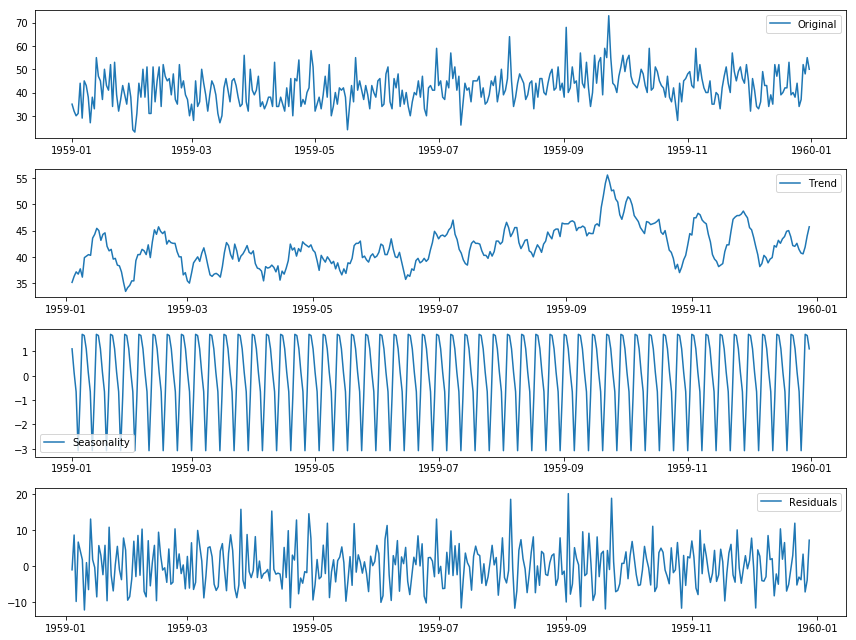

In [16]:
# Decomposition of TS into Trend, Seasonal part & Residuals:
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(y)

trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

plt.figure(figsize=(12, 9))
plt.subplot(411)
plt.plot(y, label='Original')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()

In [76]:
import itertools
# define the p, d and q parameters

# generate all different combinations of p, d and q triplets
pdq =[(i,j,k) for i in [1, 2, 7] for j in range(0, 2) for k in range(0, 2)]
 
# generate all different combinations of seasonal p, q and q triplets
seasonal_pdq = [(i, j, k, s) for i in [0, 1, 2, 7] for j in range(0, 2) for k in range(0, 2) for s in [4, 7, 14]]

In [77]:
# Grid-Search for the best ARIMA parameters:

import sys
import warnings
warnings.filterwarnings("ignore")
best_aic = np.inf
best_pdq = None
best_seasonal_pdq = None
tmp_model = None
best_mdl = None

from sklearn.metrics import mean_squared_error
L=[]

for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            tmp_mdl = sm.tsa.statespace.SARIMAX(y_train,
                                                order = param,
                                                seasonal_order = param_seasonal,
                                                enforce_stationarity=False,
                                                enforce_invertibility=True)
            res = tmp_mdl.fit(n_jobs=-1)
            pred = res.get_prediction(start=pd.to_datetime('1959-01-01'), 
                                       end=pd.to_datetime('1959-09-30'),
                                       dynamic=False)          
            RMSE= np.sqrt(mean_squared_error(y_train.values, pred.predicted_mean.values))
            
            Val_pred = res.get_prediction(start=pd.to_datetime('1959-10-01'), 
                          end=pd.to_datetime('1959-12-31'),
                          dynamic=False)
            
            Val_RMSE=np.sqrt(mean_squared_error(y['1959-10-01': ].values, Val_pred.predicted_mean.values))
            
            print('Val_RMSE= ', round(Val_RMSE, 2), ',  RMSE= ', round(RMSE, 2), ',  (p,d,q)= ', param,', (P,D,Q)= ', param_seasonal, sep='')
            
            L.append([round(Val_RMSE, 2), round(RMSE, 2), param, param_seasonal] )
            
            if res.aic < best_aic:
                best_aic = res.aic
                best_pdq = param
                best_seasonal_pdq = param_seasonal
                best_mdl = tmp_mdl
                
        except:
            continue
            
print("\n Best SARIMAX{}x{} model - AIC:{}".format(best_pdq, best_seasonal_pdq, best_aic))

Val_RMSE= 26.16,  RMSE= 9.8,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 0, 0, 4)
Val_RMSE= 26.16,  RMSE= 9.8,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 0, 0, 7)
Val_RMSE= 26.16,  RMSE= 9.8,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 0, 0, 14)
Val_RMSE= 26.47,  RMSE= 9.8,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 0, 1, 4)
Val_RMSE= 30.05,  RMSE= 9.73,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 0, 1, 7)
Val_RMSE= 27.68,  RMSE= 9.79,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 0, 1, 14)
Val_RMSE= 10.21,  RMSE= 10.85,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 1, 0, 4)
Val_RMSE= 9.21,  RMSE= 10.85,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 1, 0, 7)
Val_RMSE= 12.75,  RMSE= 12.99,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 1, 0, 14)
Val_RMSE= 6.76,  RMSE= 8.36,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 1, 1, 4)
Val_RMSE= 8.0,  RMSE= 9.08,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 1, 1, 7)
Val_RMSE= 7.35,  RMSE= 11.22,  (p,d,q)= (1, 0, 0), (P,D,Q)= (0, 1, 1, 14)
Val_RMSE= 26.41,  RMSE= 9.8,  (p,d,q)= (1, 0, 0), (P,D,Q)= (1, 0, 0, 4)
Val_RMSE= 8.48,  RMSE= 10.71,  (p,d,q)= (1, 0, 0), (P

Val_RMSE= 26.26,  RMSE= 10.28,  (p,d,q)= (1, 1, 0), (P,D,Q)= (1, 1, 0, 7)
Val_RMSE= 10.17,  RMSE= 10.27,  (p,d,q)= (1, 1, 0), (P,D,Q)= (1, 1, 0, 14)
Val_RMSE= 15.23,  RMSE= 9.01,  (p,d,q)= (1, 1, 0), (P,D,Q)= (1, 1, 1, 4)
Val_RMSE= 12.44,  RMSE= 8.93,  (p,d,q)= (1, 1, 0), (P,D,Q)= (1, 1, 1, 7)
Val_RMSE= 13.01,  RMSE= 9.49,  (p,d,q)= (1, 1, 0), (P,D,Q)= (1, 1, 1, 14)
Val_RMSE= 11.79,  RMSE= 8.74,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 0, 0, 4)
Val_RMSE= 10.81,  RMSE= 8.7,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 0, 0, 7)
Val_RMSE= 12.03,  RMSE= 8.73,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 0, 0, 14)
Val_RMSE= 11.83,  RMSE= 8.76,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 0, 1, 4)
Val_RMSE= 10.5,  RMSE= 8.69,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 0, 1, 7)
Val_RMSE= 12.05,  RMSE= 8.75,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 0, 1, 14)
Val_RMSE= 32.87,  RMSE= 10.11,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 1, 0, 4)
Val_RMSE= 8.78,  RMSE= 9.18,  (p,d,q)= (1, 1, 0), (P,D,Q)= (2, 1, 0, 7)
Val_RMSE= 18.57,  RMSE= 9.43,  (p,d,q)= (1, 1, 

Val_RMSE= 10.53,  RMSE= 11.63,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 0, 0, 7)
Val_RMSE= 9.83,  RMSE= 13.79,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 0, 0, 14)
Val_RMSE= 9.63,  RMSE= 8.93,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 0, 1, 4)
Val_RMSE= 10.47,  RMSE= 10.65,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 0, 1, 7)
Val_RMSE= 9.7,  RMSE= 12.77,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 0, 1, 14)
Val_RMSE= 8.21,  RMSE= 9.05,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 1, 0, 4)
Val_RMSE= 9.74,  RMSE= 9.7,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 1, 0, 7)
Val_RMSE= 8.37,  RMSE= 11.64,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 1, 0, 14)
Val_RMSE= 7.93,  RMSE= 8.59,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 1, 1, 4)
Val_RMSE= 9.79,  RMSE= 10.55,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 1, 1, 7)
Val_RMSE= 8.46,  RMSE= 11.8,  (p,d,q)= (2, 0, 0), (P,D,Q)= (7, 1, 1, 14)
Val_RMSE= 7.94,  RMSE= 7.52,  (p,d,q)= (2, 0, 1), (P,D,Q)= (0, 0, 0, 4)
Val_RMSE= 7.94,  RMSE= 7.52,  (p,d,q)= (2, 0, 1), (P,D,Q)= (0, 0, 0, 7)
Val_RMSE= 7.94,  RMSE= 7.52,  (p,d,q)= (2, 0, 1), (P,D

Val_RMSE= 7.5,  RMSE= 7.67,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 0, 1, 4)
Val_RMSE= 7.12,  RMSE= 7.58,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 0, 1, 7)
Val_RMSE= 7.4,  RMSE= 7.72,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 0, 1, 14)
Val_RMSE= 11.34,  RMSE= 8.9,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 1, 0, 4)
Val_RMSE= 11.94,  RMSE= 9.19,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 1, 0, 7)
Val_RMSE= 14.03,  RMSE= 9.04,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 1, 0, 14)
Val_RMSE= 8.82,  RMSE= 7.88,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 1, 1, 4)
Val_RMSE= 10.77,  RMSE= 7.96,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 1, 1, 7)
Val_RMSE= 10.0,  RMSE= 8.45,  (p,d,q)= (2, 1, 1), (P,D,Q)= (1, 1, 1, 14)
Val_RMSE= 7.44,  RMSE= 7.66,  (p,d,q)= (2, 1, 1), (P,D,Q)= (2, 0, 0, 4)
Val_RMSE= 7.22,  RMSE= 7.72,  (p,d,q)= (2, 1, 1), (P,D,Q)= (2, 0, 0, 7)
Val_RMSE= 7.86,  RMSE= 7.89,  (p,d,q)= (2, 1, 1), (P,D,Q)= (2, 0, 0, 14)
Val_RMSE= 7.28,  RMSE= 7.75,  (p,d,q)= (2, 1, 1), (P,D,Q)= (2, 0, 1, 4)
Val_RMSE= 7.19,  RMSE= 7.67,  (p,d,q)= (2, 1, 1), (P,D,Q)= 

Val_RMSE= 9.3,  RMSE= 9.78,  (p,d,q)= (7, 0, 1), (P,D,Q)= (2, 1, 1, 7)
Val_RMSE= 8.64,  RMSE= 10.34,  (p,d,q)= (7, 0, 1), (P,D,Q)= (2, 1, 1, 14)
Val_RMSE= 10.63,  RMSE= 9.69,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 0, 0, 4)
Val_RMSE= 11.14,  RMSE= 11.46,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 0, 0, 7)
Val_RMSE= 10.2,  RMSE= 9.21,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 0, 0, 14)
Val_RMSE= 9.66,  RMSE= 7.88,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 0, 1, 4)
Val_RMSE= 11.09,  RMSE= 15.3,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 0, 1, 7)
Val_RMSE= 15.67,  RMSE= 8.3,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 0, 1, 14)
Val_RMSE= 8.11,  RMSE= 9.17,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 1, 0, 4)
Val_RMSE= 9.77,  RMSE= 10.51,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 1, 0, 7)
Val_RMSE= 8.63,  RMSE= 9.49,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 1, 0, 14)
Val_RMSE= 8.12,  RMSE= 10.46,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 1, 1, 4)
Val_RMSE= 10.46,  RMSE= 9.54,  (p,d,q)= (7, 0, 1), (P,D,Q)= (7, 1, 1, 7)
Val_RMSE= 8.36,  RMSE= 9.8,  (p,d,q)= (7, 0, 1), (P,D

In [78]:
L.sort()
L[130:140]

[[8.22, 9.07, (1, 0, 1), (7, 1, 0, 4)],
 [8.22, 11.46, (1, 0, 0), (1, 1, 1, 14)],
 [8.23, 9.59, (7, 0, 1), (1, 1, 1, 7)],
 [8.27, 7.72, (2, 0, 1), (1, 0, 0, 14)],
 [8.33, 11.83, (1, 0, 0), (7, 1, 0, 14)],
 [8.33, 11.83, (1, 0, 0), (7, 1, 1, 14)],
 [8.34, 7.67, (7, 1, 0), (2, 0, 1, 14)],
 [8.35, 7.68, (7, 1, 0), (1, 0, 0, 14)],
 [8.36, 7.68, (7, 1, 0), (1, 0, 1, 14)],
 [8.36, 9.8, (7, 0, 1), (7, 1, 1, 14)]]

[6.55, 8.08, (7, 0, 1), (0, 1, 1, 4)]
RMSE:  6.547203193179098


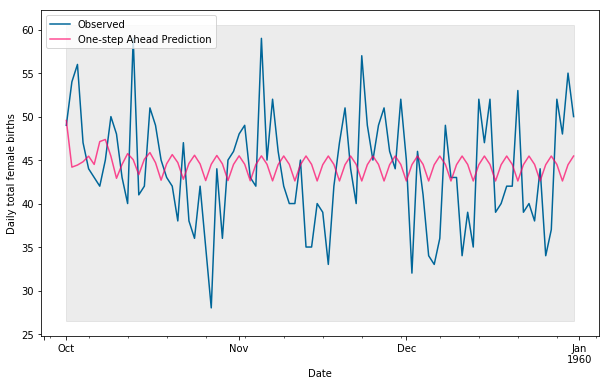

[6.63, 7.98, (1, 0, 1), (0, 1, 1, 4)]
RMSE:  6.6281824966940714


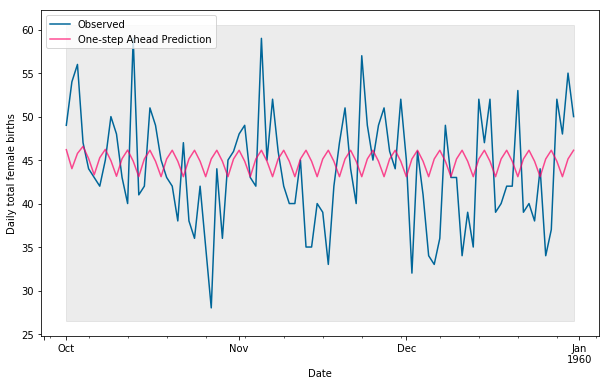

[6.63, 7.98, (1, 0, 1), (1, 1, 1, 4)]
RMSE:  6.628296840333077


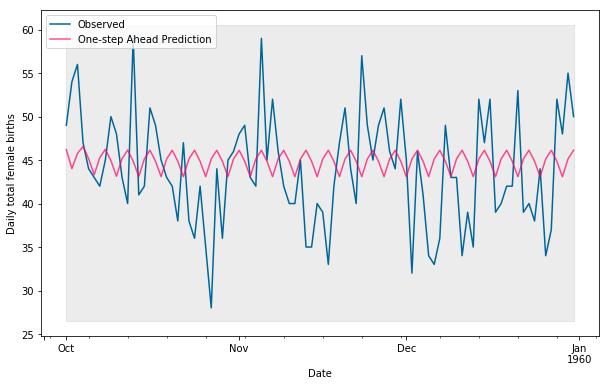

[6.64, 8.26, (7, 0, 0), (0, 1, 1, 4)]
RMSE:  6.643549645923101


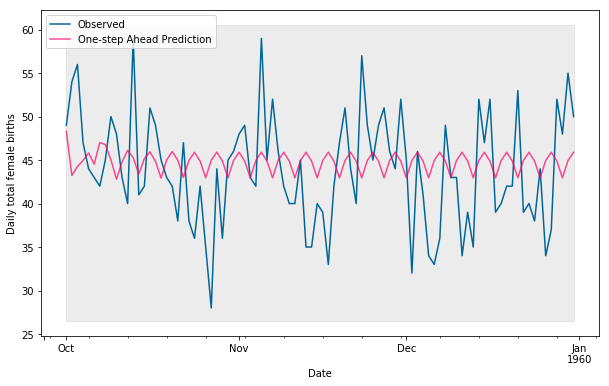

[6.64, 8.28, (7, 0, 0), (1, 1, 1, 4)]
RMSE:  6.644854834036952


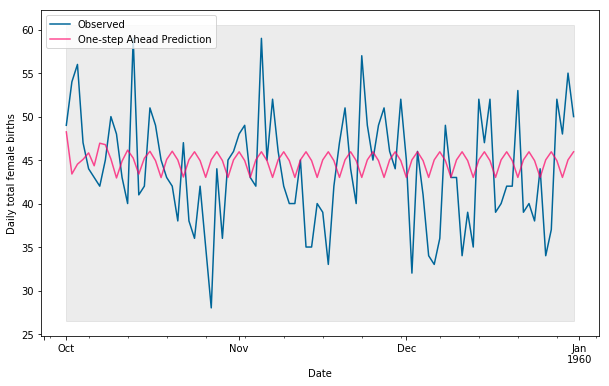

[6.67, 8.99, (7, 0, 1), (1, 1, 1, 4)]
RMSE:  6.672696194489188


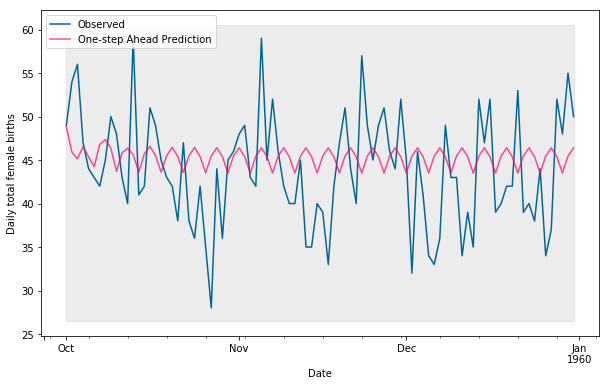

[6.69, 8.32, (2, 0, 0), (0, 1, 1, 4)]
RMSE:  6.689168764648697


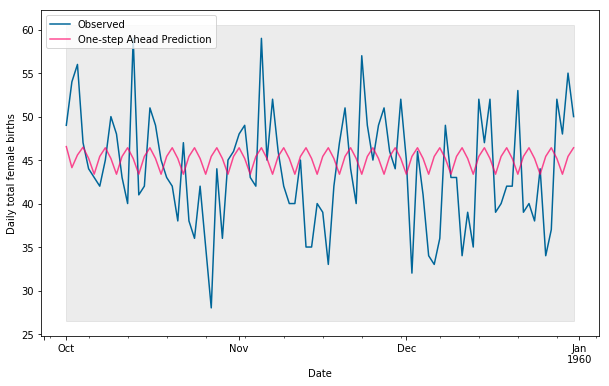

[6.69, 8.32, (2, 0, 0), (1, 1, 1, 4)]
RMSE:  6.687336810498031


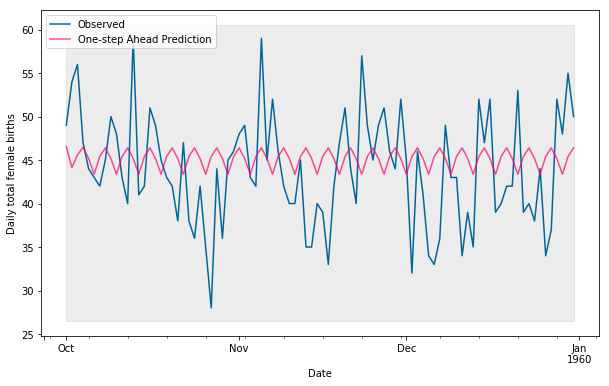

[6.72, 8.09, (1, 0, 1), (2, 1, 1, 4)]
RMSE:  6.717419117931221


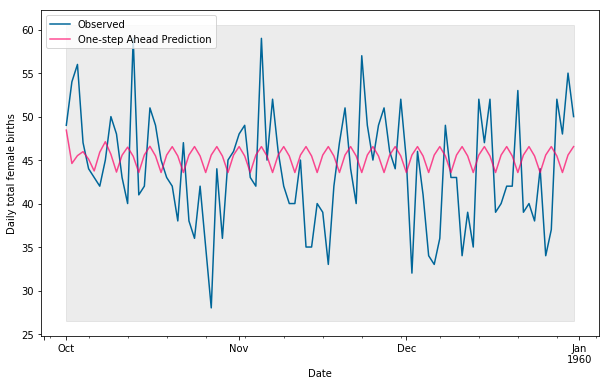

[6.74, 8.38, (2, 0, 0), (2, 1, 1, 4)]
RMSE:  6.74133868191949


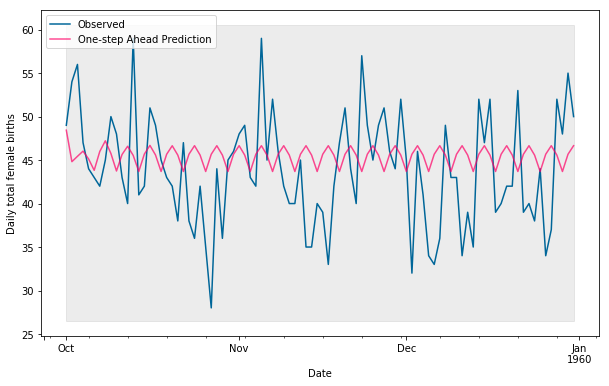

[6.75, 8.05, (7, 0, 1), (2, 1, 1, 4)]
RMSE:  6.751221859631205


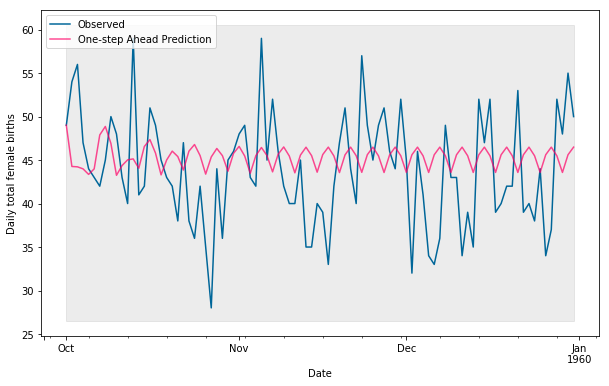

[6.76, 8.36, (1, 0, 0), (0, 1, 1, 4)]
RMSE:  6.75956776520673


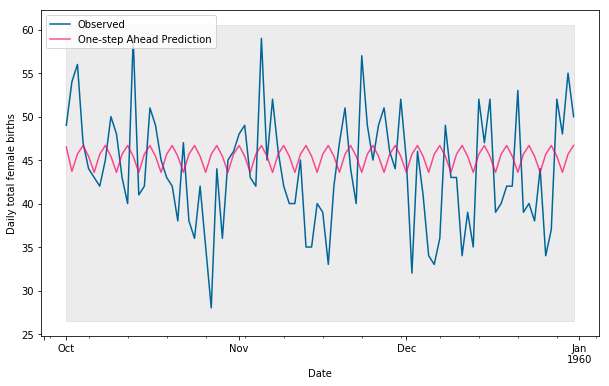

[6.76, 8.36, (1, 0, 0), (1, 1, 1, 4)]
RMSE:  6.7634682149939085


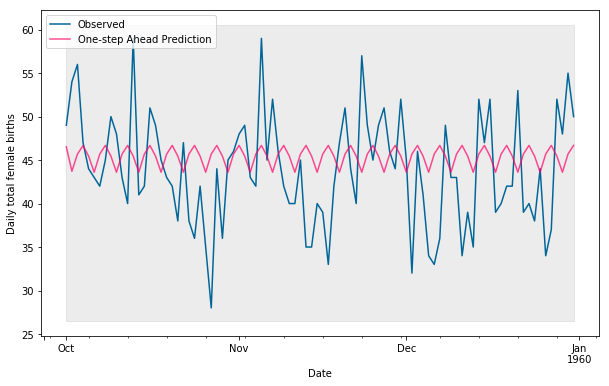

[6.78, 8.41, (1, 0, 0), (2, 1, 1, 4)]
RMSE:  6.78473987824804


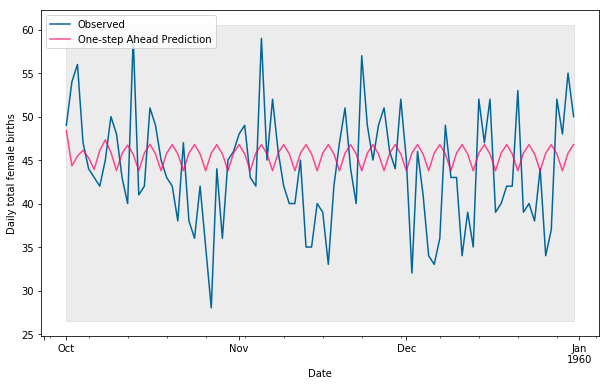

[6.88, 8.33, (7, 0, 0), (2, 1, 1, 4)]
RMSE:  6.8758537278657395


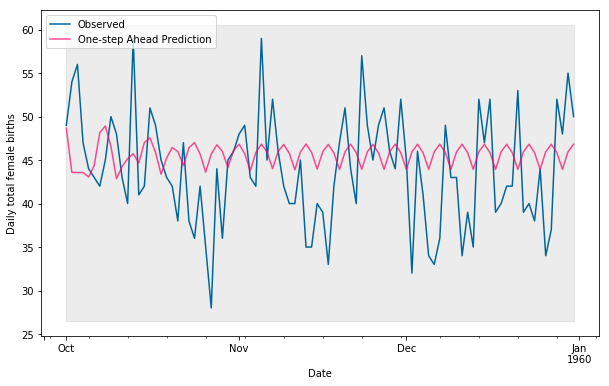

[7.12, 7.58, (2, 1, 1), (1, 0, 1, 7)]
RMSE:  7.122851001711304


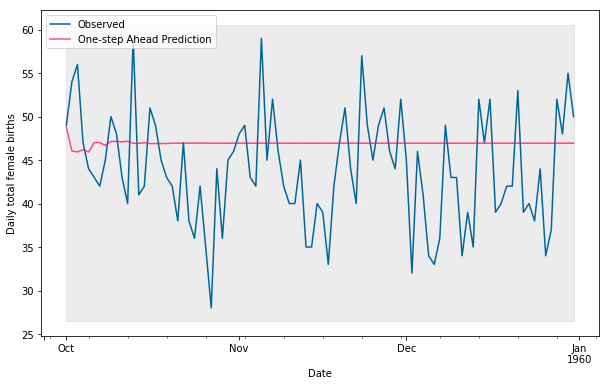

[7.13, 7.58, (1, 1, 1), (1, 0, 1, 7)]
RMSE:  7.127157772451069


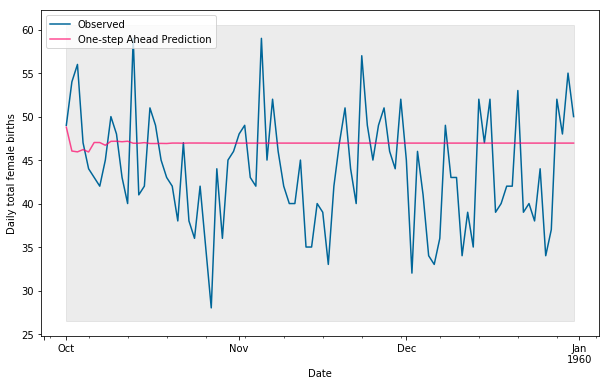

[7.16, 7.58, (2, 1, 1), (0, 0, 1, 7)]
RMSE:  7.161021347586677


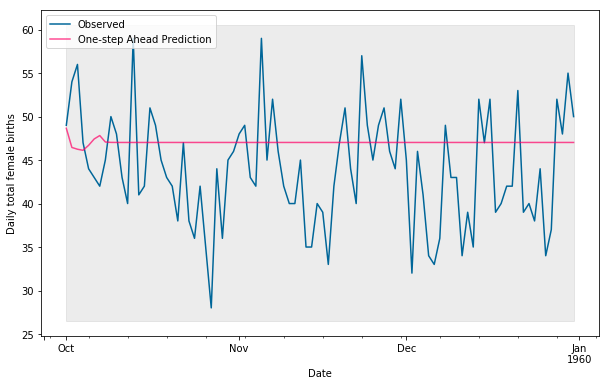

[7.17, 7.58, (1, 1, 1), (0, 0, 1, 7)]
RMSE:  7.16795521132511


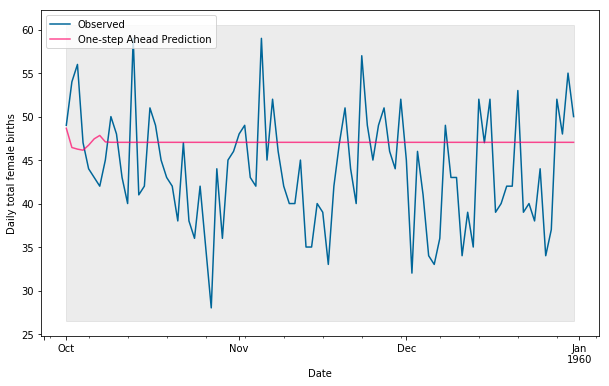

[7.18, 10.98, (7, 0, 1), (0, 1, 1, 14)]
RMSE:  7.176792765106918


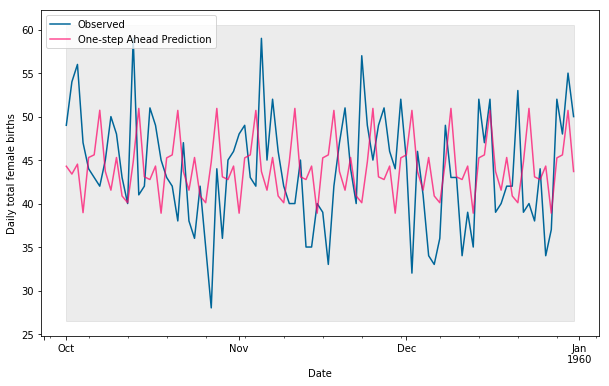

[7.19, 7.6, (1, 1, 1), (2, 0, 1, 7)]
RMSE:  7.19274233047163


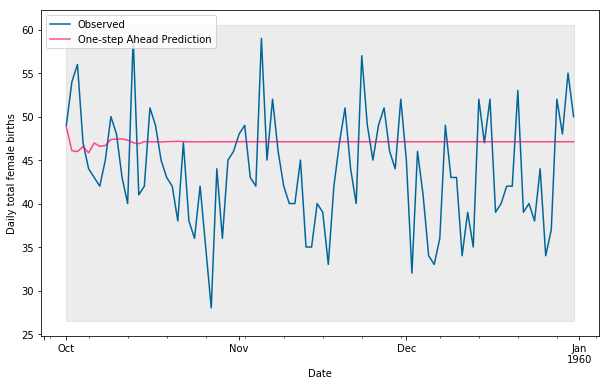

[7.19, 7.67, (2, 1, 1), (2, 0, 1, 7)]
RMSE:  7.192714756690783


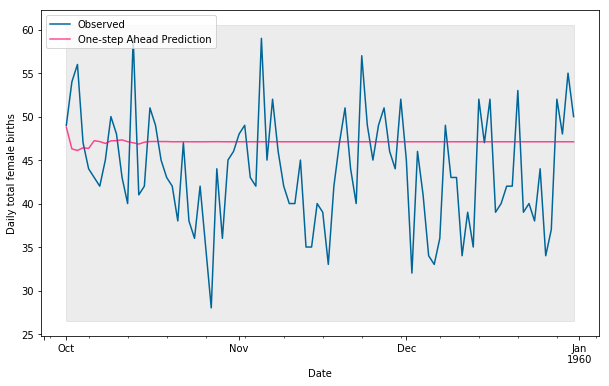

[7.19, 10.84, (7, 0, 0), (0, 1, 1, 14)]
RMSE:  7.188088077309713


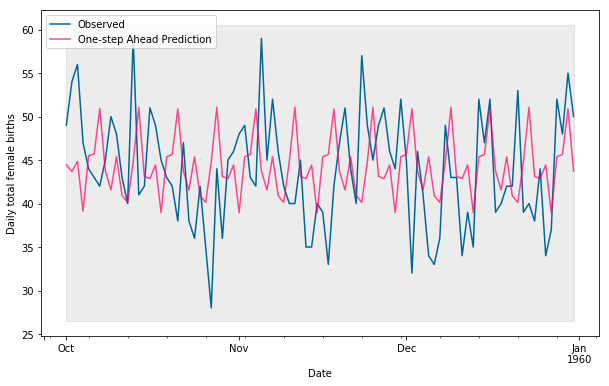

[7.22, 7.59, (2, 1, 1), (1, 0, 0, 7)]
RMSE:  7.22151244624994


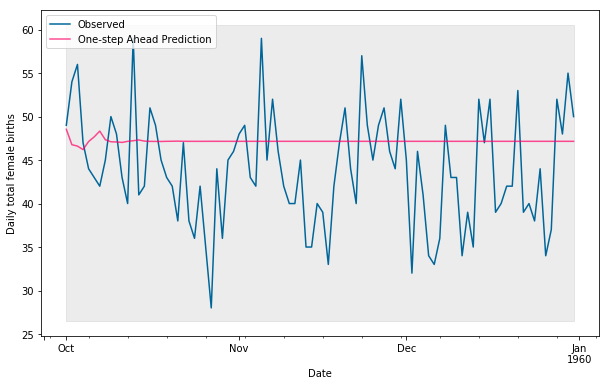

[7.22, 7.72, (2, 1, 1), (2, 0, 0, 7)]
RMSE:  7.219232451690534


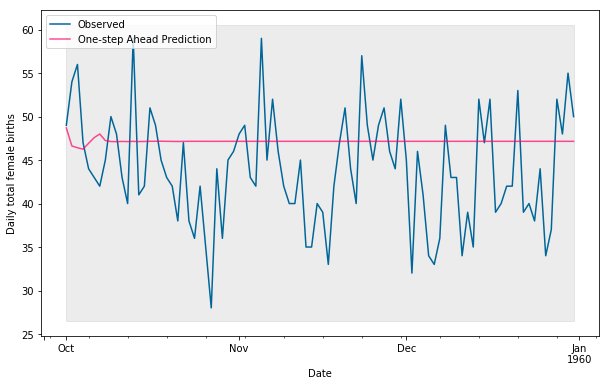

[7.24, 7.58, (1, 1, 1), (1, 0, 0, 7)]
RMSE:  7.242539429190572


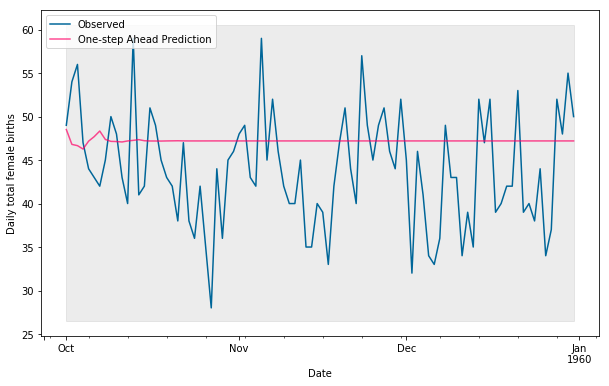

[7.24, 7.7, (1, 1, 1), (2, 0, 0, 7)]
RMSE:  7.235420259255371


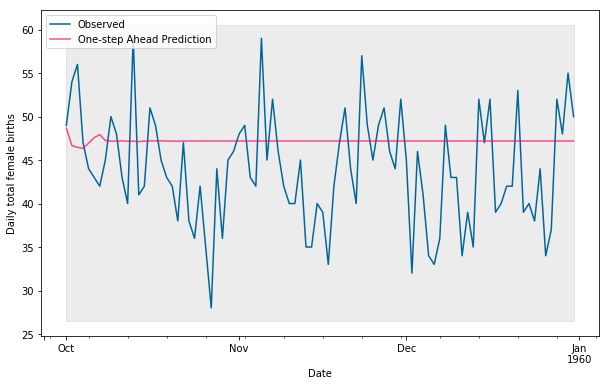

[7.26, 7.9, (1, 0, 1), (1, 0, 1, 4)]
RMSE:  7.263557739102357


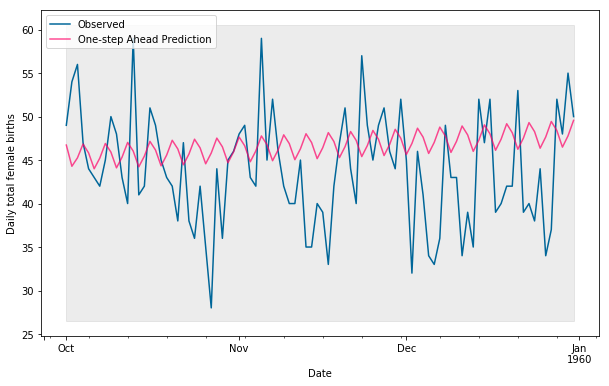

[7.26, 10.96, (2, 0, 0), (0, 1, 1, 14)]
RMSE:  7.256586109784917


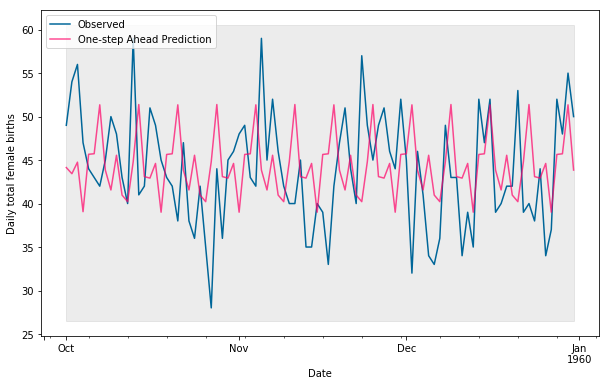

[7.27, 8.29, (1, 0, 0), (2, 0, 1, 4)]
RMSE:  7.266447244038631


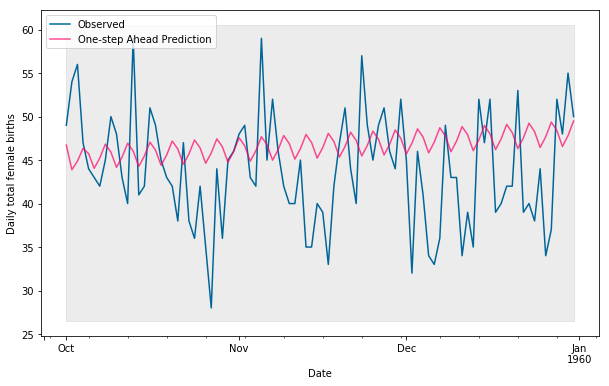

[7.28, 7.54, (7, 1, 1), (0, 0, 1, 7)]
RMSE:  7.2758233537175085


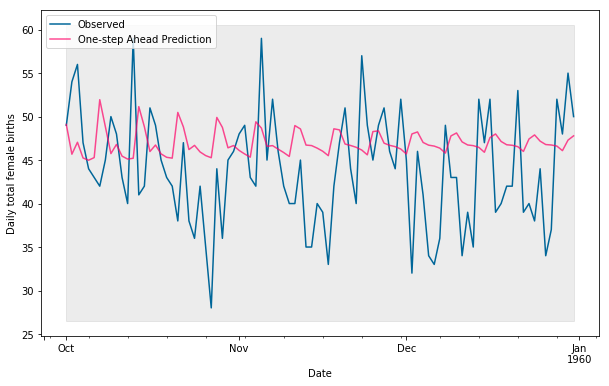

[7.28, 7.75, (2, 1, 1), (2, 0, 1, 4)]
RMSE:  7.277275383130873


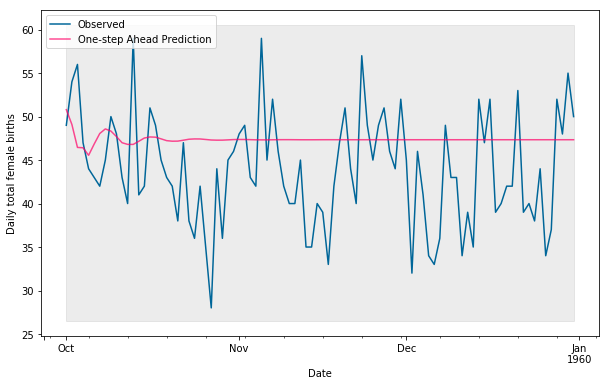

[7.3, 8.16, (2, 0, 0), (1, 0, 1, 4)]
RMSE:  7.298590535791564


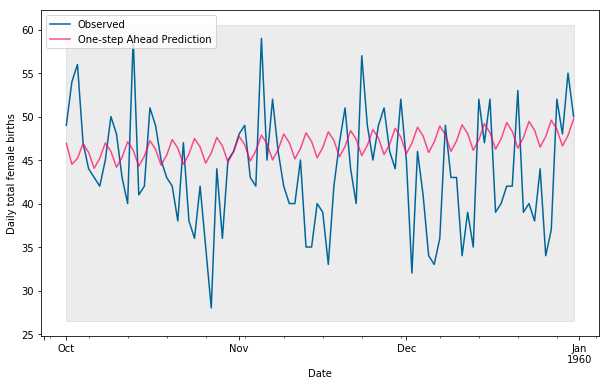

[7.31, 8.08, (2, 0, 1), (2, 0, 1, 4)]
RMSE:  7.30537471376


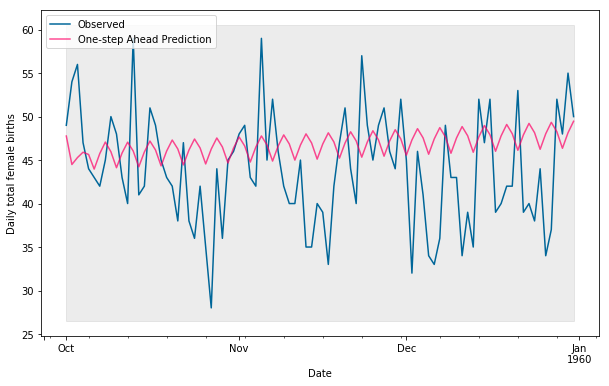

[7.35, 11.22, (1, 0, 0), (0, 1, 1, 14)]
RMSE:  7.347423085932447


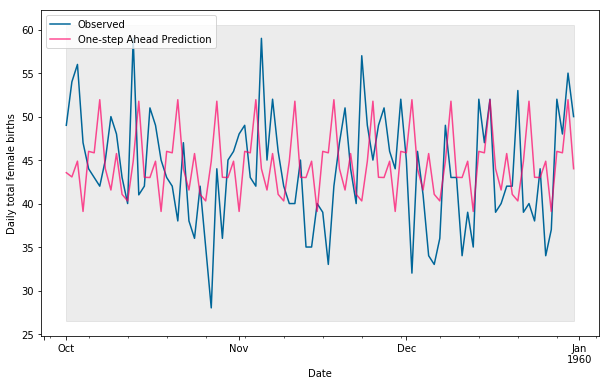

[7.38, 7.55, (1, 1, 1), (0, 0, 0, 4)]
RMSE:  7.377490853438627


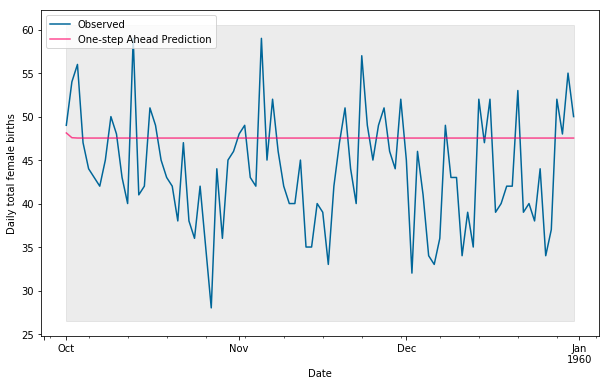

[7.38, 7.55, (1, 1, 1), (0, 0, 0, 7)]
RMSE:  7.377490853438627


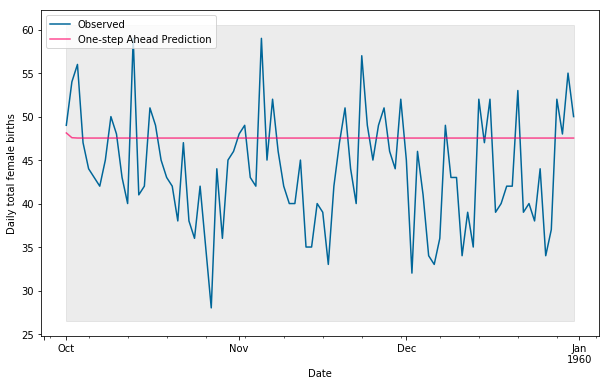

[7.38, 7.55, (1, 1, 1), (0, 0, 0, 14)]
RMSE:  7.377490853438627


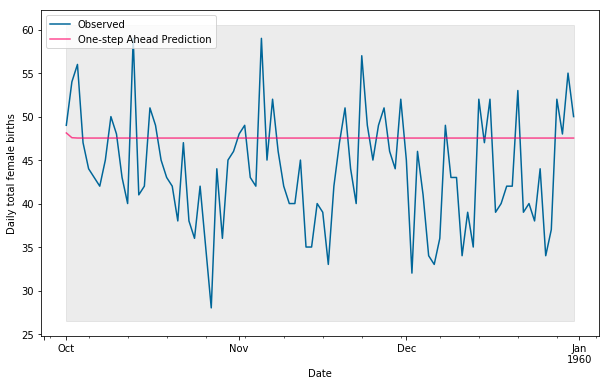

[7.39, 7.55, (2, 1, 1), (0, 0, 0, 4)]
RMSE:  7.394119573437022


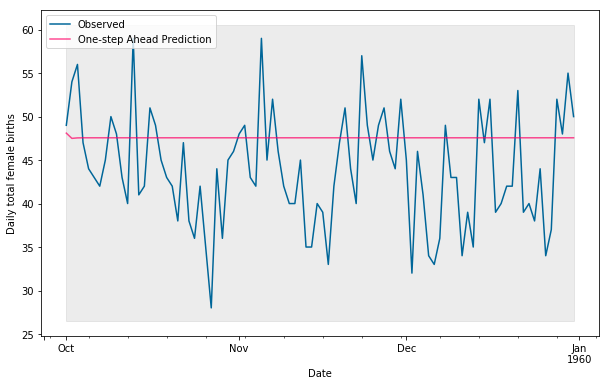

[7.39, 7.55, (2, 1, 1), (0, 0, 0, 7)]
RMSE:  7.394119573437022


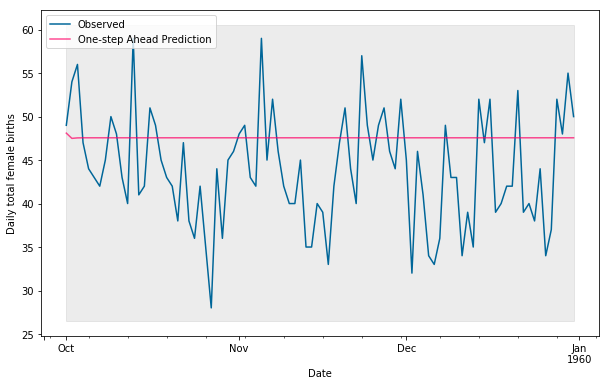

[7.39, 7.55, (2, 1, 1), (0, 0, 0, 14)]
RMSE:  7.394119573437022


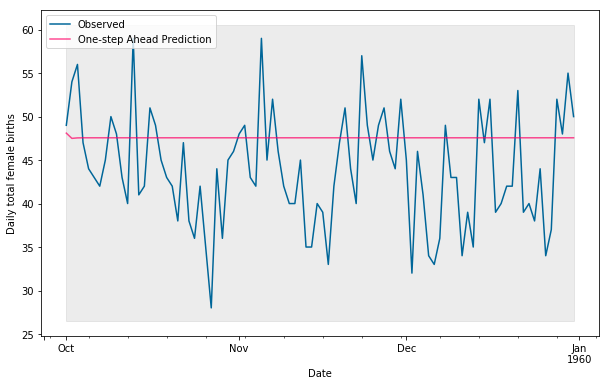

[7.39, 7.72, (1, 1, 1), (1, 0, 1, 14)]
RMSE:  7.394265253795123


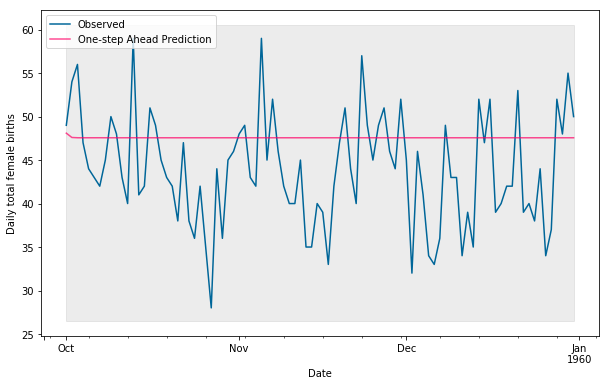

[7.4, 7.72, (2, 1, 1), (1, 0, 1, 14)]
RMSE:  7.401280337906927


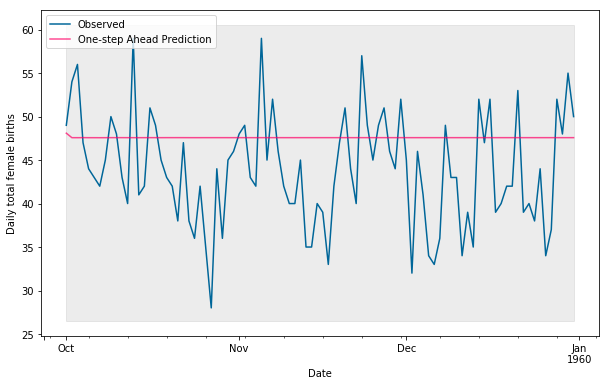

[7.43, 7.69, (7, 1, 1), (2, 0, 0, 4)]
RMSE:  7.42621443118525


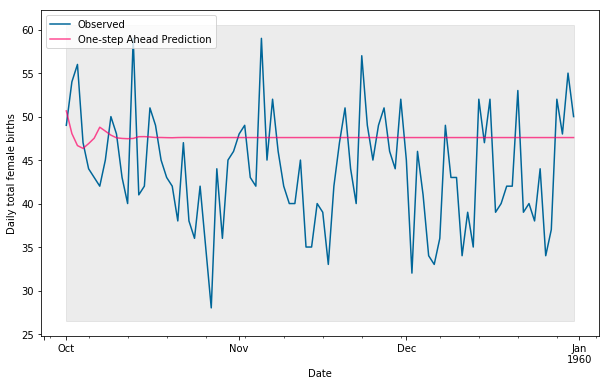

[7.43, 7.71, (1, 1, 1), (1, 0, 0, 14)]
RMSE:  7.426377572576104


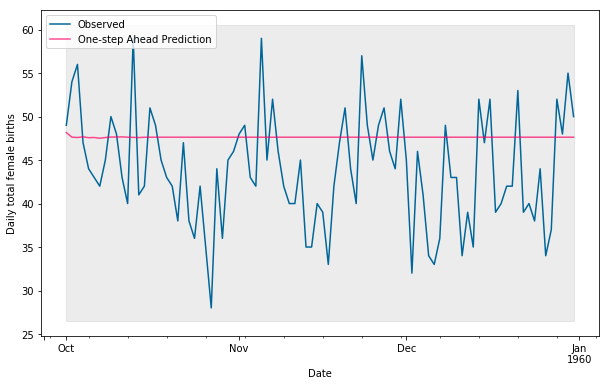

[7.43, 7.74, (1, 1, 1), (0, 0, 1, 14)]
RMSE:  7.430978622801643


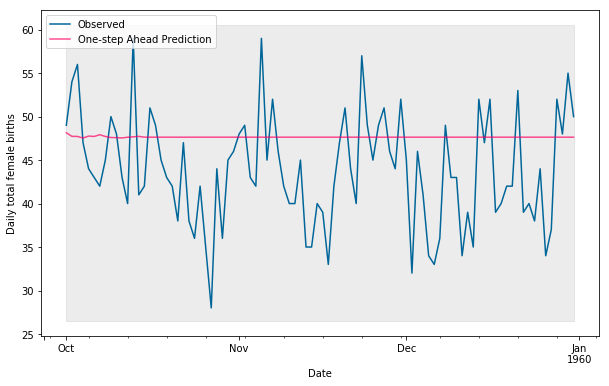

[7.43, 7.74, (2, 1, 1), (1, 0, 0, 14)]
RMSE:  7.433576596681295


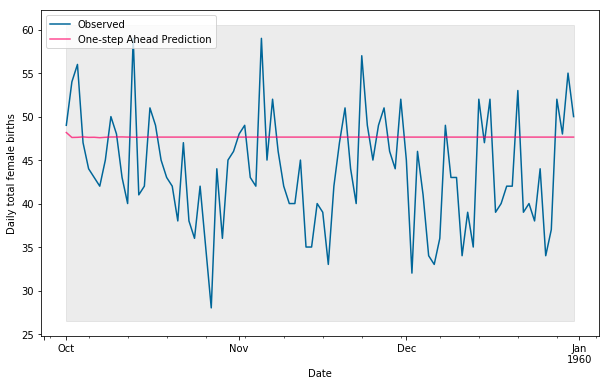

[7.44, 7.57, (7, 1, 0), (0, 0, 1, 7)]
RMSE:  7.444983912015644


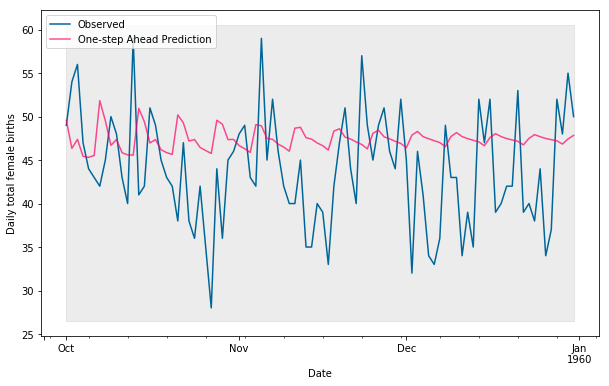

[7.44, 7.66, (2, 1, 1), (2, 0, 0, 4)]
RMSE:  7.43731527388241


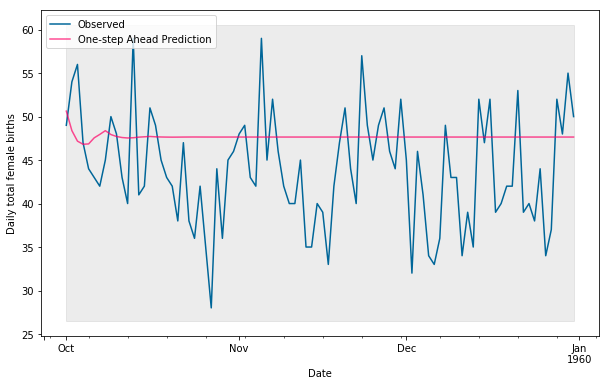

[7.44, 7.74, (2, 1, 1), (0, 0, 1, 14)]
RMSE:  7.441826908282976


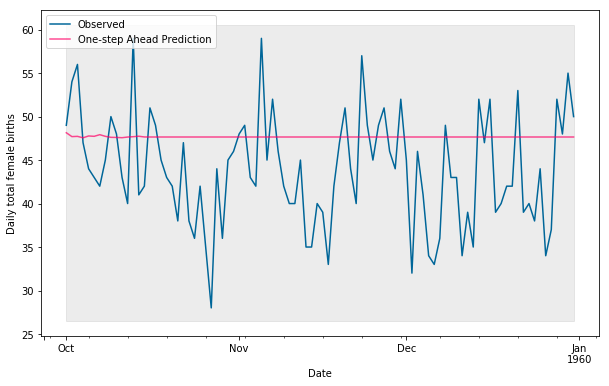

[7.45, 7.57, (7, 1, 1), (0, 0, 0, 4)]
RMSE:  7.454591174880596


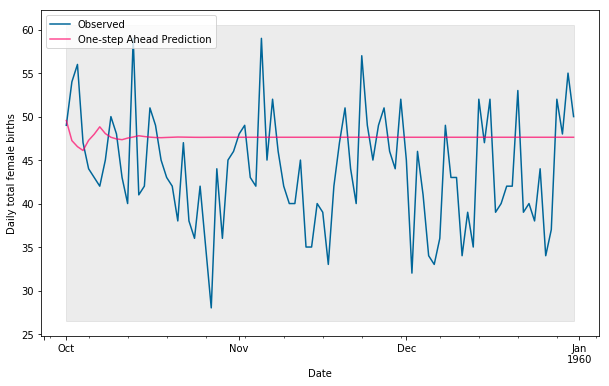

[7.45, 7.57, (7, 1, 1), (0, 0, 0, 7)]
RMSE:  7.454591174880596


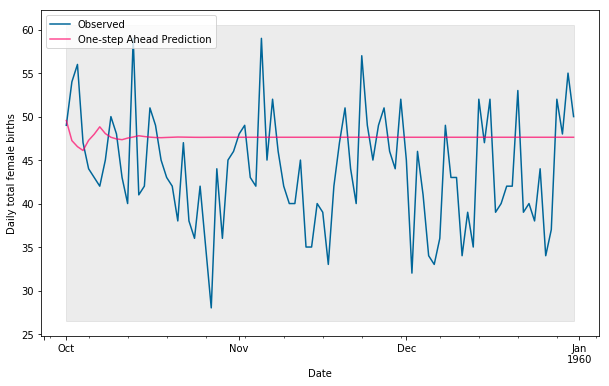

[7.45, 7.57, (7, 1, 1), (0, 0, 0, 14)]
RMSE:  7.454591174880596


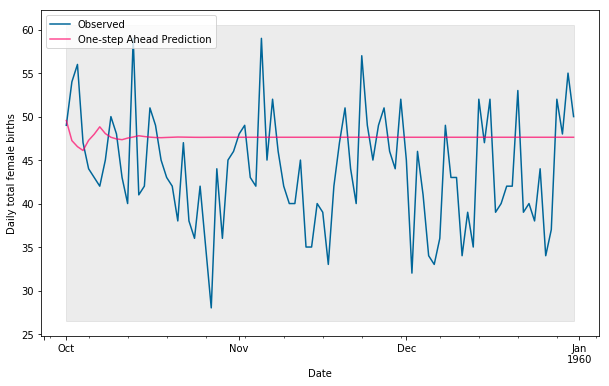

[7.46, 7.62, (1, 1, 1), (0, 0, 1, 4)]
RMSE:  7.455516461632966


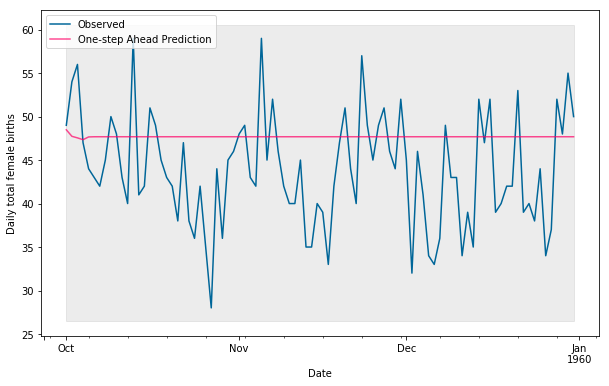

[7.47, 7.62, (2, 1, 1), (0, 0, 1, 4)]
RMSE:  7.4716204088671105


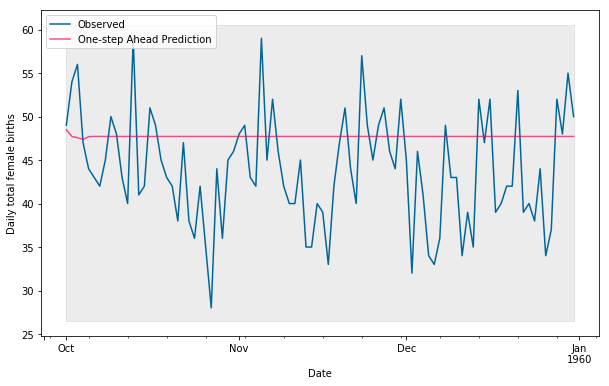

[7.47, 7.68, (1, 1, 1), (2, 0, 1, 4)]
RMSE:  7.471116811359315


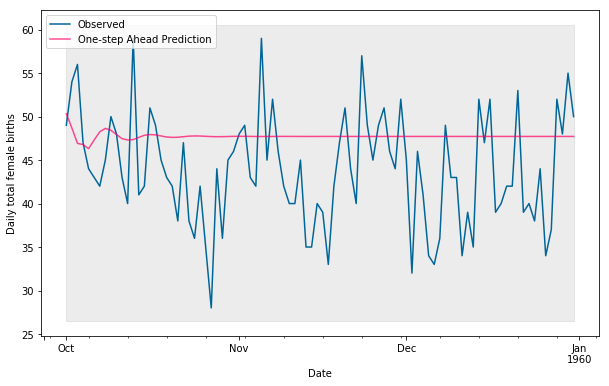

[7.48, 7.56, (1, 1, 1), (1, 0, 0, 4)]
RMSE:  7.483610191012859


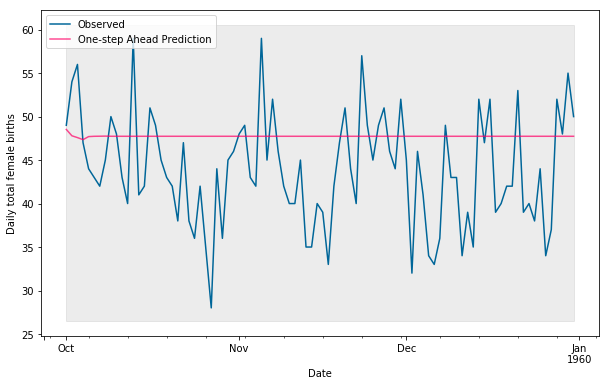

[7.48, 7.62, (2, 1, 1), (1, 0, 0, 4)]
RMSE:  7.4823717940866


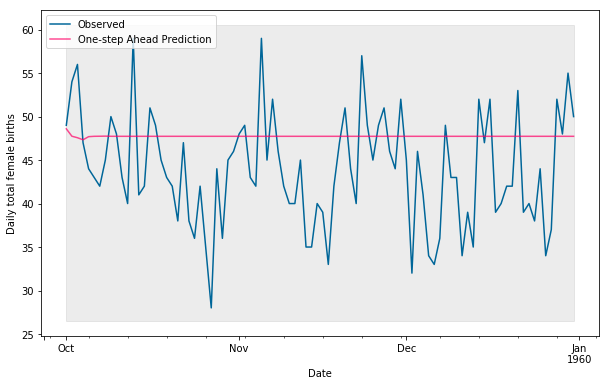

[7.49, 7.85, (2, 0, 1), (1, 0, 1, 4)]
RMSE:  7.4898381390655


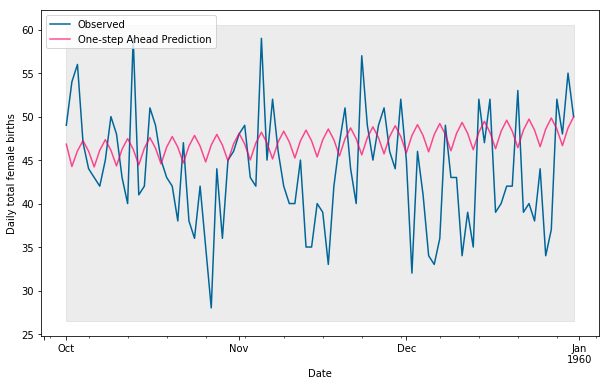

[7.5, 7.62, (1, 1, 1), (2, 0, 0, 4)]
RMSE:  7.5011320064954505


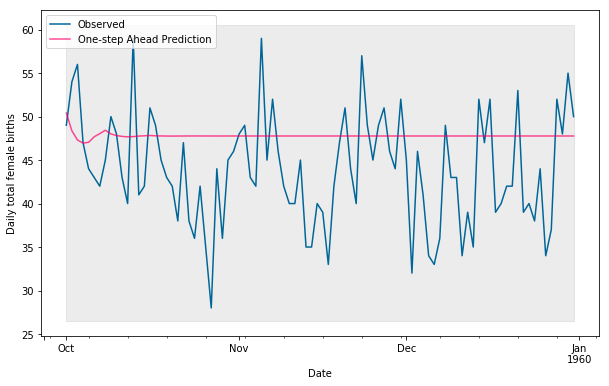

[7.5, 7.67, (1, 1, 1), (1, 0, 1, 4)]
RMSE:  7.500476385856751


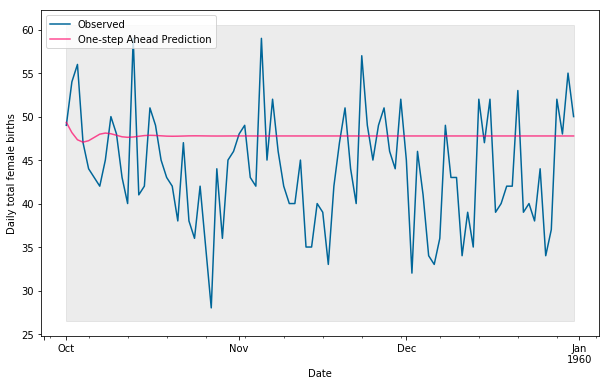

[7.5, 7.67, (2, 1, 1), (1, 0, 1, 4)]
RMSE:  7.5006734735017355


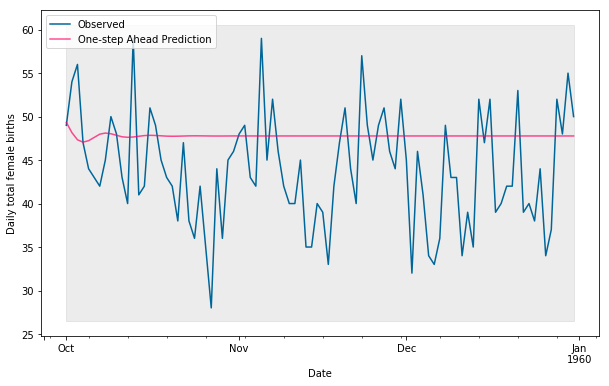

[7.5, 7.74, (7, 1, 1), (0, 0, 1, 14)]
RMSE:  7.499167028018362


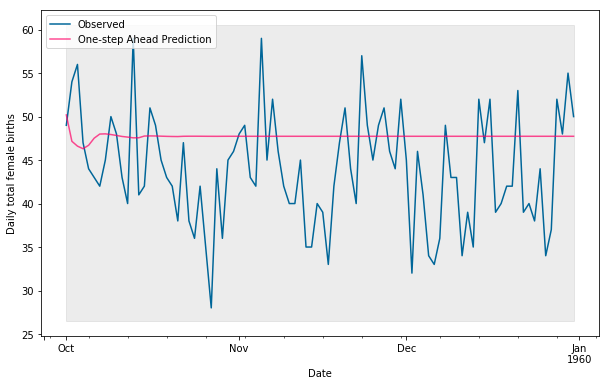

[7.51, 7.73, (7, 1, 1), (1, 0, 1, 4)]
RMSE:  7.5083808769623435


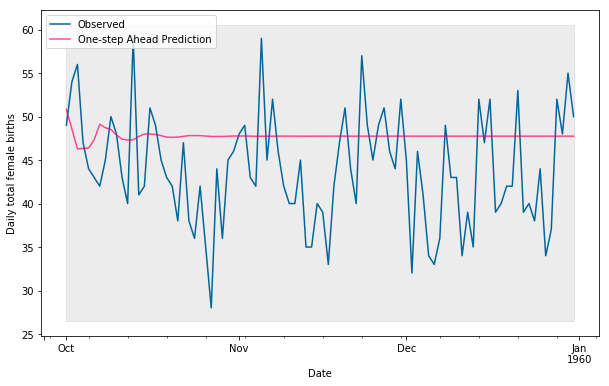

[7.52, 8.26, (2, 0, 0), (2, 0, 1, 4)]
RMSE:  7.519362285236356


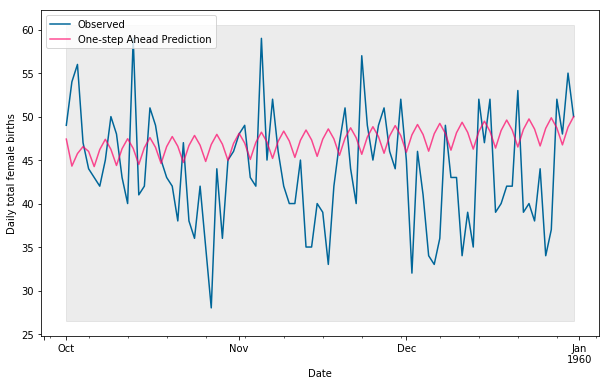

[7.52, 9.63, (2, 0, 0), (2, 0, 0, 4)]
RMSE:  7.517777037621481


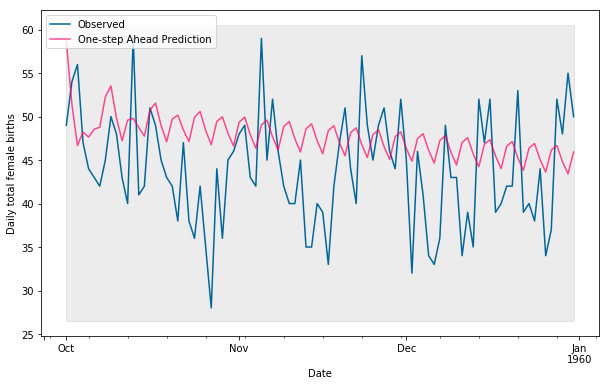

[7.54, 7.7, (7, 1, 1), (1, 0, 0, 7)]
RMSE:  7.54323620220052


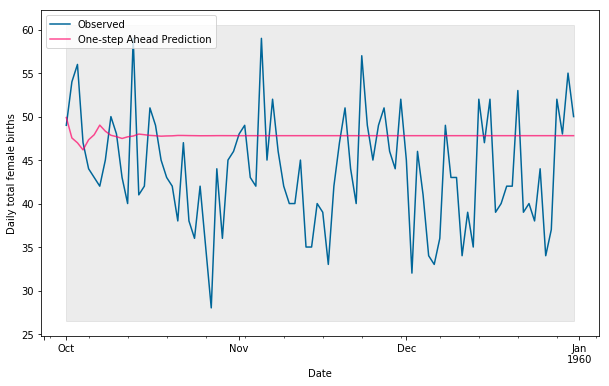

[7.59, 7.61, (7, 1, 1), (1, 0, 0, 4)]
RMSE:  7.592500562343967


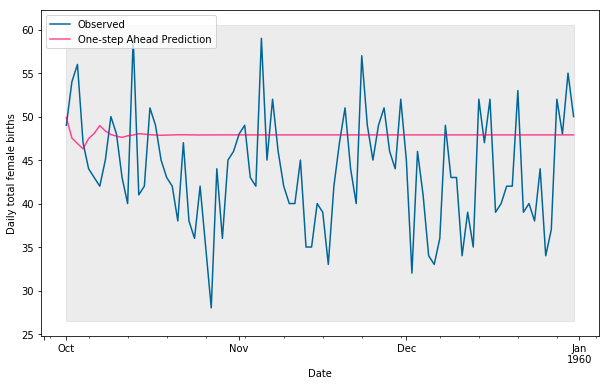

[7.62, 7.58, (7, 1, 0), (1, 0, 1, 7)]
RMSE:  7.622720316259757


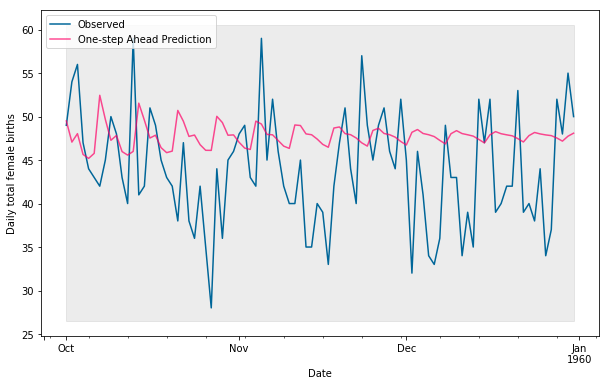

[7.63, 7.59, (7, 1, 1), (2, 0, 1, 4)]
RMSE:  7.627032236547026


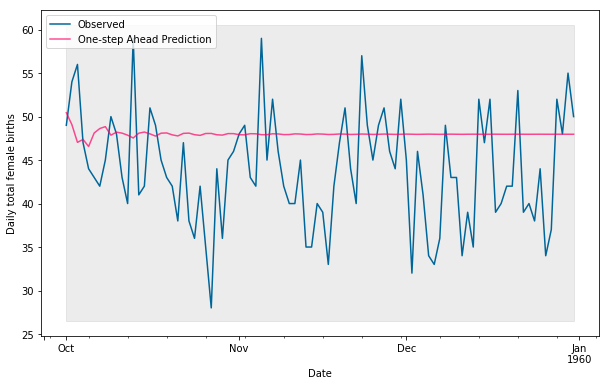

[7.63, 7.66, (7, 1, 1), (1, 0, 1, 7)]
RMSE:  7.633651968684102


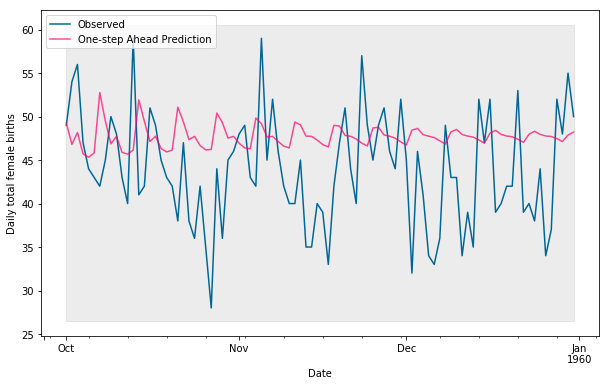

[7.64, 7.84, (7, 1, 1), (1, 0, 1, 14)]
RMSE:  7.640172234999035


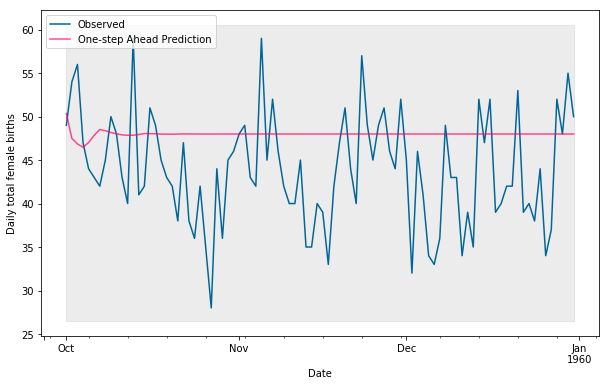

[7.65, 7.84, (7, 1, 1), (1, 0, 0, 14)]
RMSE:  7.650495291164205


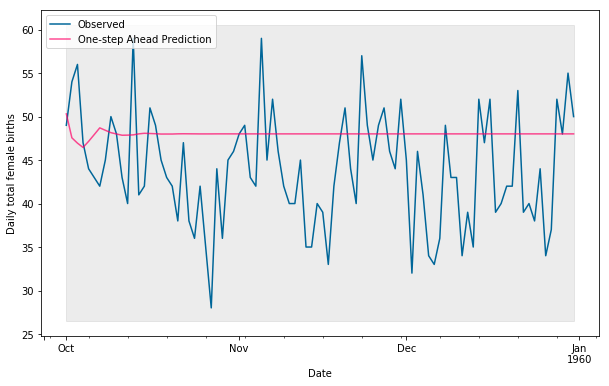

[7.65, 9.69, (1, 0, 0), (2, 0, 0, 4)]
RMSE:  7.64591539698075


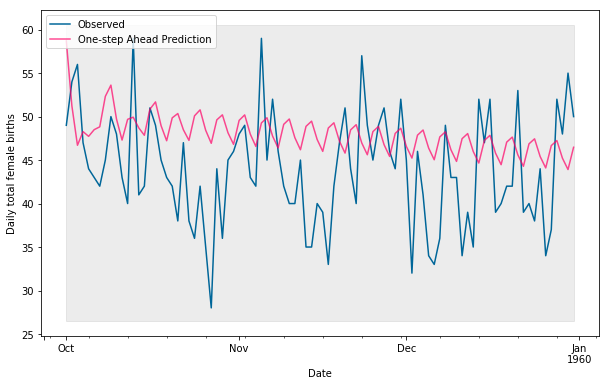

[7.68, 9.3, (7, 0, 1), (1, 1, 1, 14)]
RMSE:  7.681177717550002


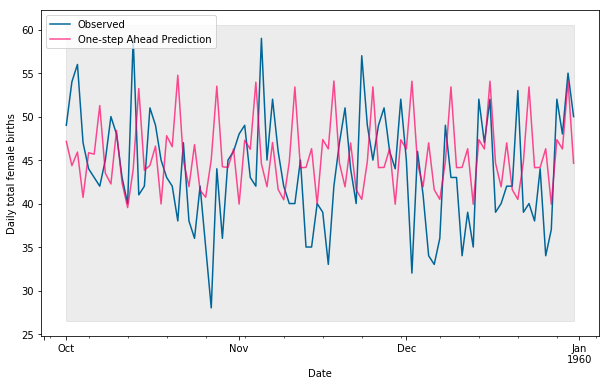

[7.69, 7.63, (7, 1, 0), (1, 0, 1, 4)]
RMSE:  7.693585704199276


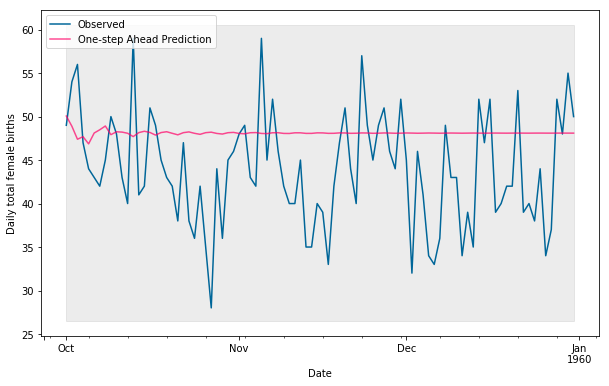

[7.69, 7.71, (1, 0, 1), (0, 0, 1, 14)]
RMSE:  7.692284485375786


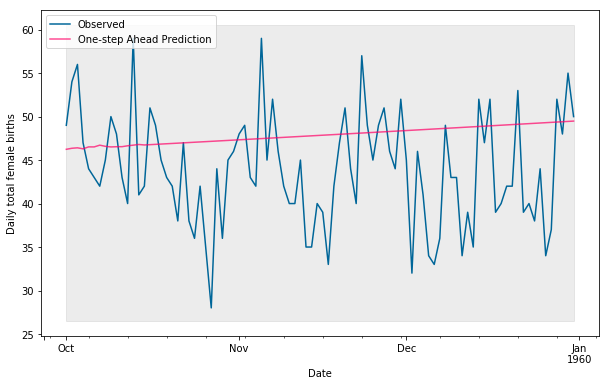

[7.72, 7.84, (1, 1, 1), (7, 0, 0, 4)]
RMSE:  7.724601673349614


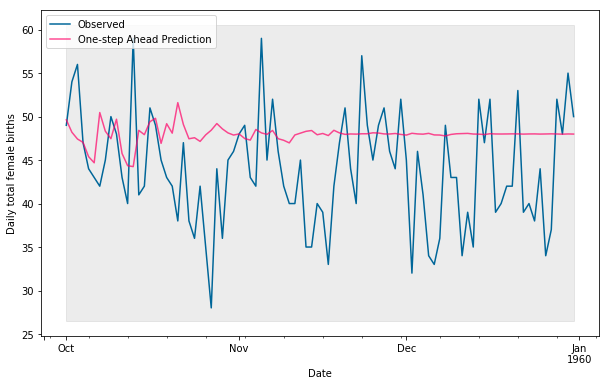

[7.73, 10.88, (7, 0, 0), (1, 1, 1, 14)]
RMSE:  7.73487624818483


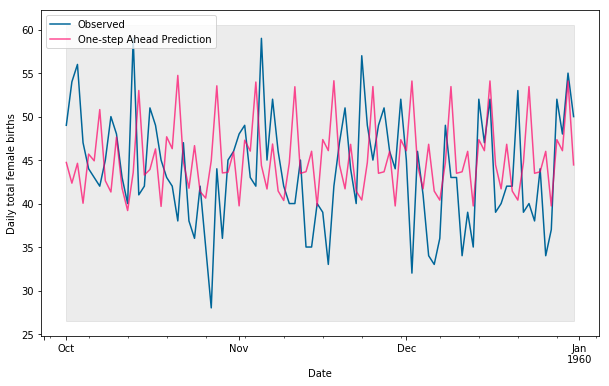

[7.76, 8.07, (7, 0, 0), (1, 0, 1, 4)]
RMSE:  7.762447278349405


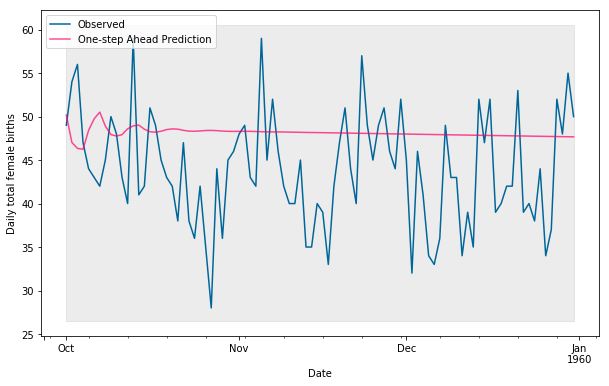

[7.76, 8.23, (1, 0, 0), (1, 0, 1, 4)]
RMSE:  7.764809972644165


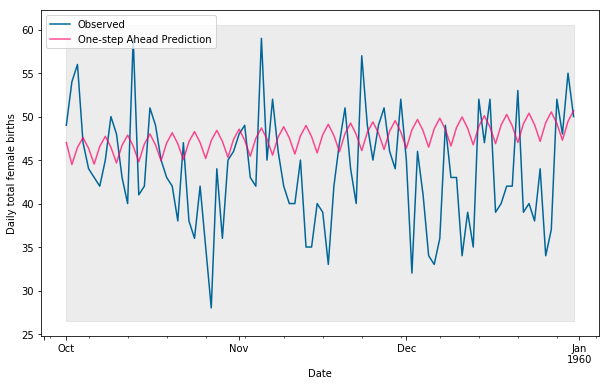

[7.77, 8.2, (7, 0, 0), (0, 0, 1, 14)]
RMSE:  7.767690831578071


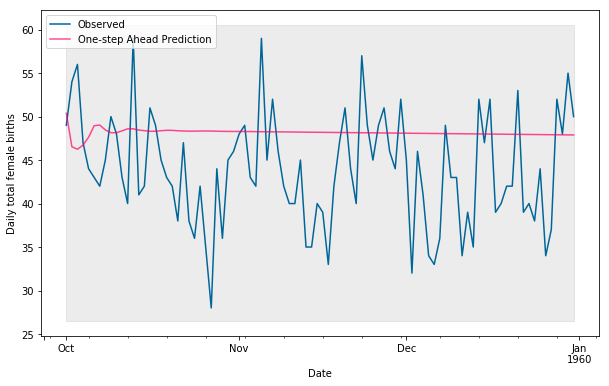

[7.78, 8.21, (7, 0, 0), (1, 0, 0, 14)]
RMSE:  7.783671875427479


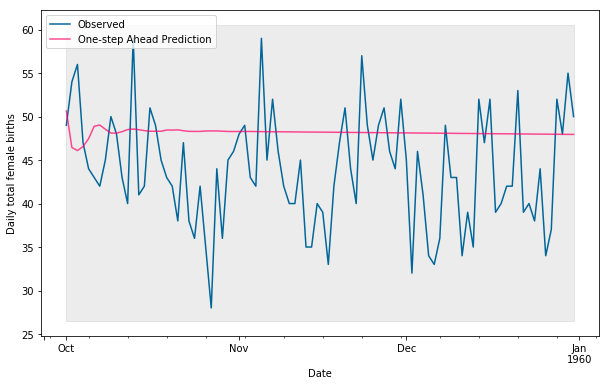

[7.79, 8.05, (1, 0, 1), (0, 1, 1, 7)]
RMSE:  7.785565796162172


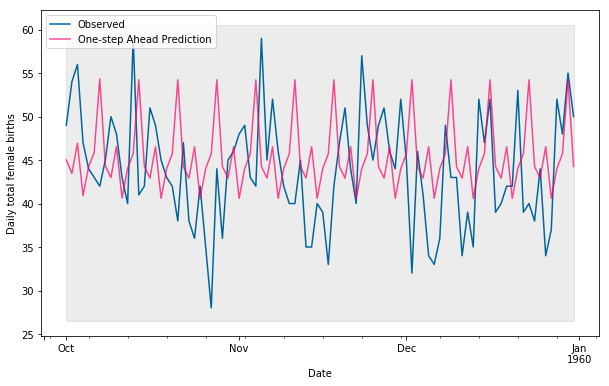

[7.79, 8.05, (1, 0, 1), (1, 1, 1, 7)]
RMSE:  7.787365098219083


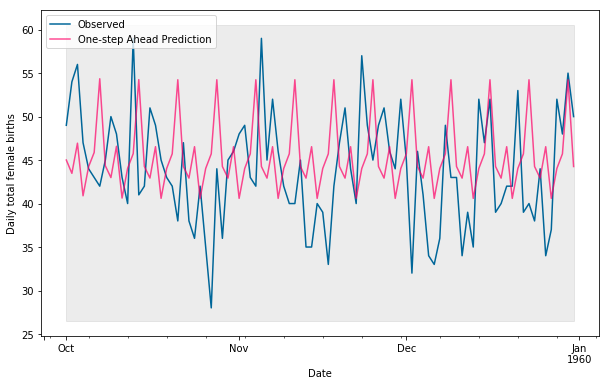

[7.79, 8.05, (2, 0, 1), (0, 1, 1, 7)]
RMSE:  7.785841243822567


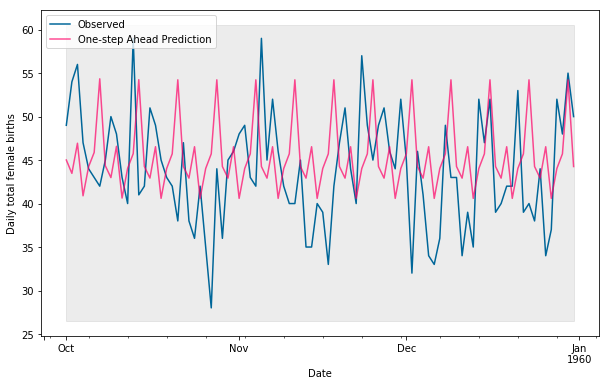

[7.79, 8.05, (2, 0, 1), (1, 1, 1, 7)]
RMSE:  7.787663590815046


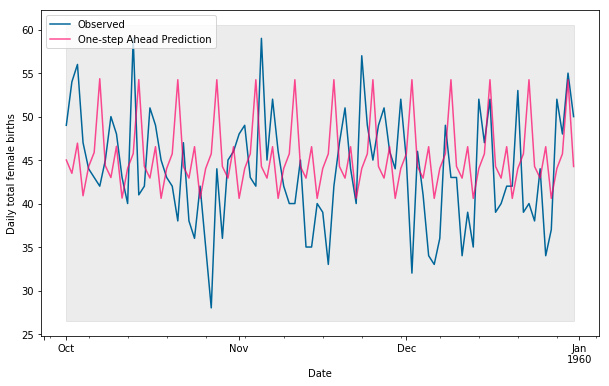

[7.8, 7.84, (2, 1, 1), (7, 0, 0, 4)]
RMSE:  7.803036799773183


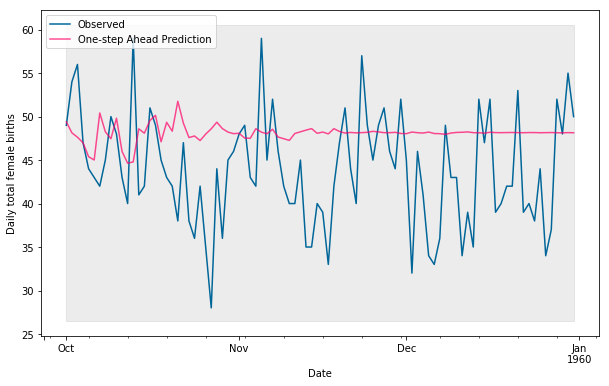

[7.8, 7.88, (1, 1, 1), (2, 0, 0, 14)]
RMSE:  7.801240918838361


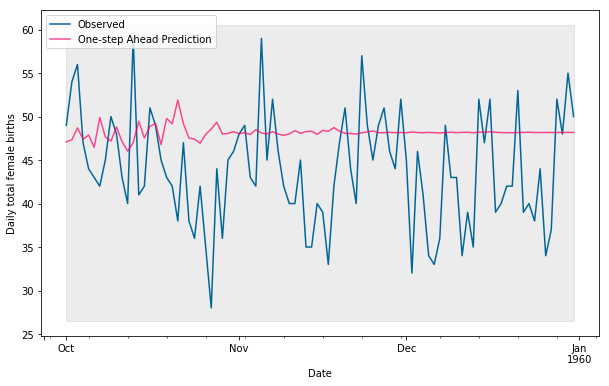

[7.83, 7.56, (2, 0, 1), (0, 0, 1, 7)]
RMSE:  7.8286379924119585


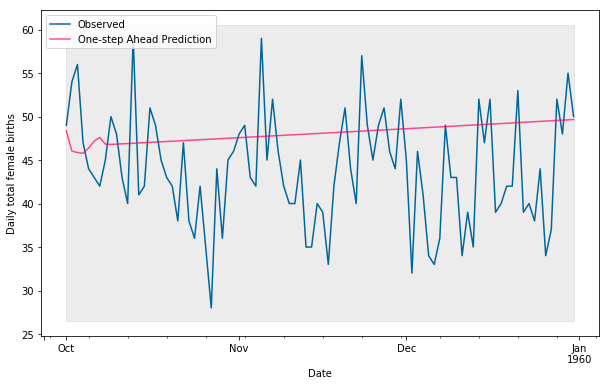

[7.84, 7.57, (1, 0, 1), (1, 0, 0, 7)]
RMSE:  7.837172273485694


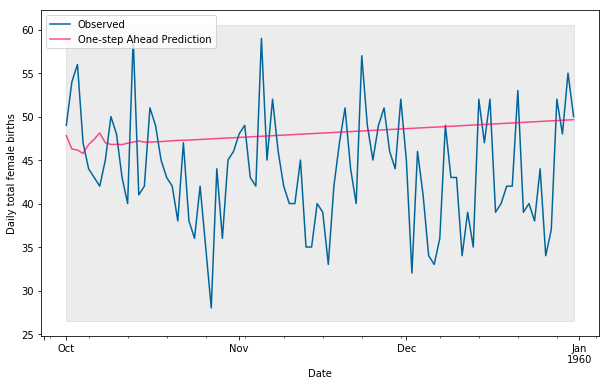

[7.85, 7.59, (7, 1, 0), (2, 0, 1, 4)]
RMSE:  7.850758162035254


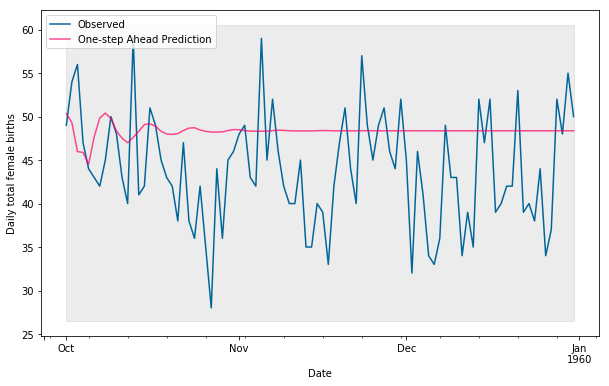

[7.86, 7.89, (2, 1, 1), (2, 0, 0, 14)]
RMSE:  7.8586915683437


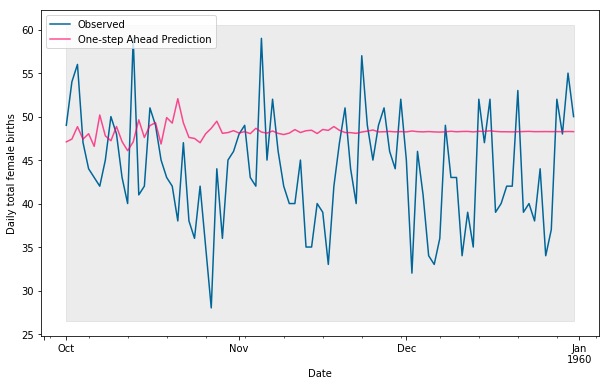

[7.87, 8.47, (7, 0, 0), (7, 1, 1, 4)]
RMSE:  7.8680147208085


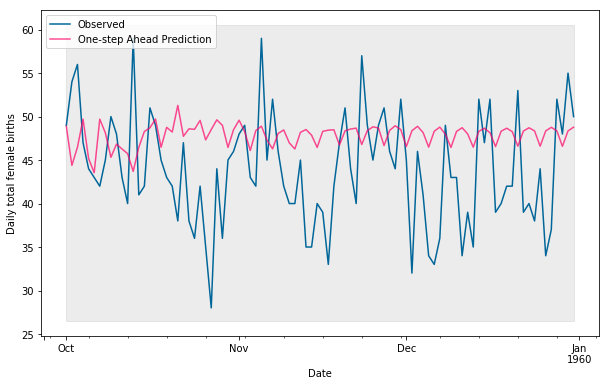

[7.88, 8.93, (7, 0, 0), (0, 1, 1, 7)]
RMSE:  7.879251410237871


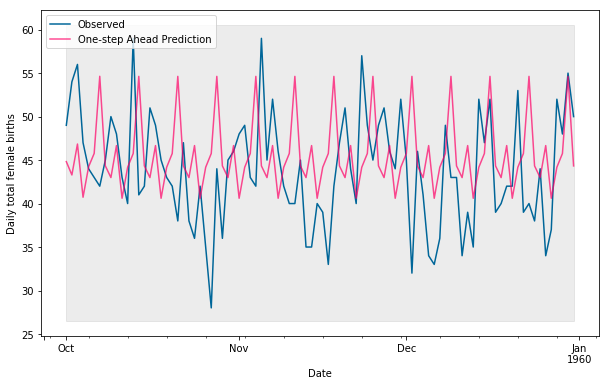

[7.89, 9.22, (7, 0, 1), (0, 1, 1, 7)]
RMSE:  7.892569346455405


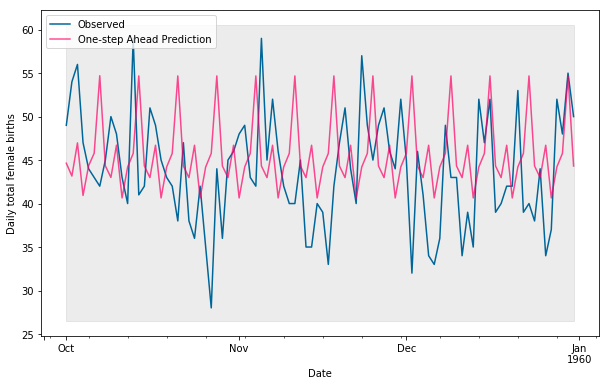

[7.9, 8.95, (2, 0, 0), (0, 1, 1, 7)]
RMSE:  7.901315671760734


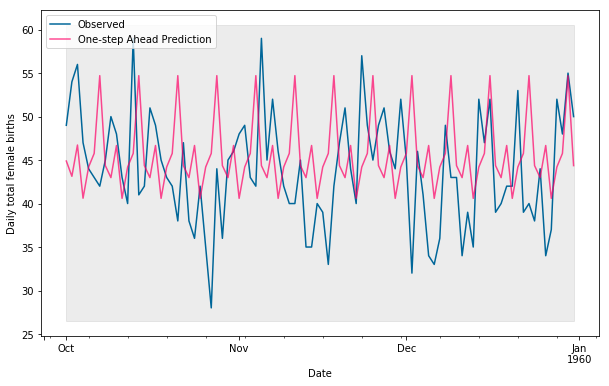

[7.91, 8.95, (2, 0, 0), (1, 1, 1, 7)]
RMSE:  7.910765251666885


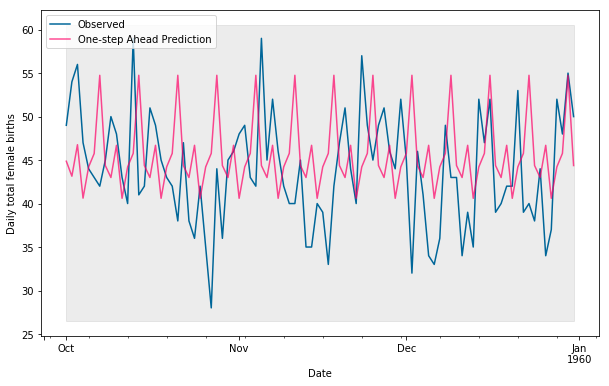

[7.93, 8.59, (2, 0, 0), (7, 1, 1, 4)]
RMSE:  7.9349449161121255


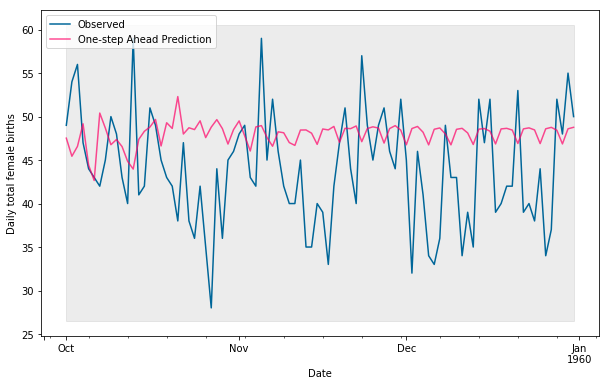

[7.94, 7.52, (2, 0, 1), (0, 0, 0, 4)]
RMSE:  7.94206972261074


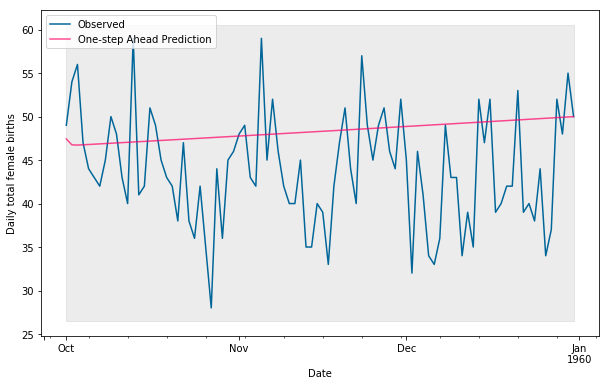

[7.94, 7.52, (2, 0, 1), (0, 0, 0, 7)]
RMSE:  7.94206972261074


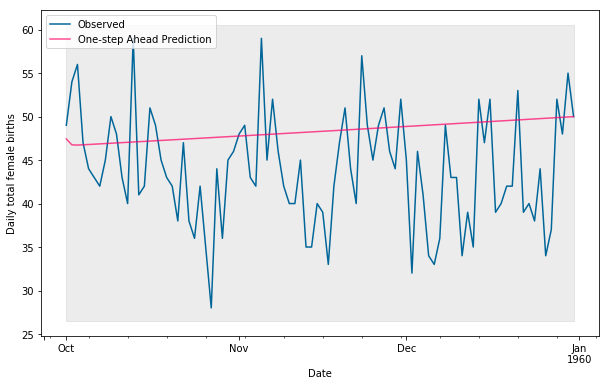

[7.94, 7.52, (2, 0, 1), (0, 0, 0, 14)]
RMSE:  7.94206972261074


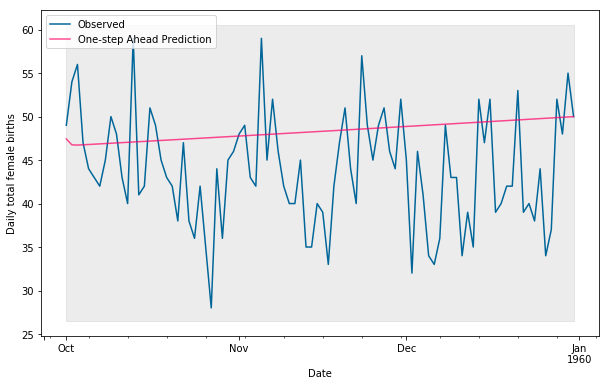

[7.94, 7.93, (1, 1, 1), (2, 0, 1, 14)]
RMSE:  7.937762736249658


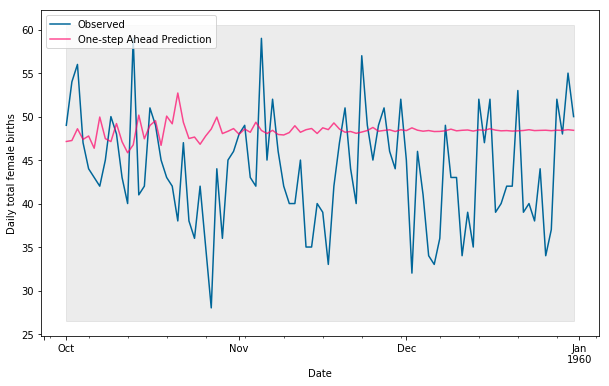

[7.94, 8.56, (1, 0, 1), (7, 1, 1, 4)]
RMSE:  7.943160512802854


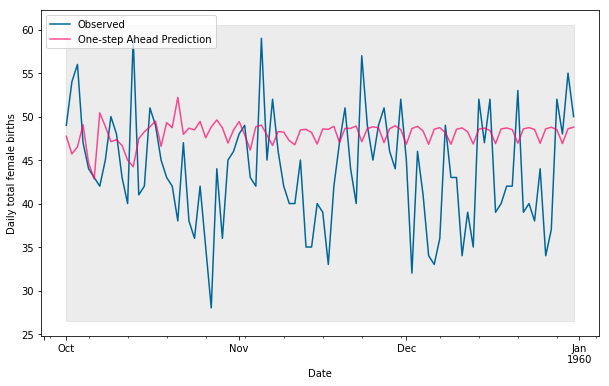

[7.94, 8.58, (1, 0, 0), (7, 1, 1, 4)]
RMSE:  7.943324344905348


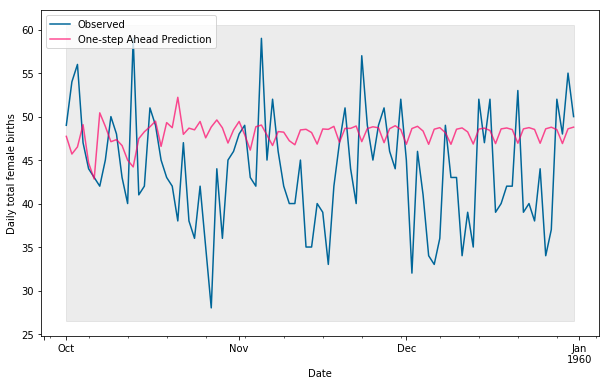

[7.97, 7.83, (2, 1, 1), (7, 0, 1, 4)]
RMSE:  7.973939402640525


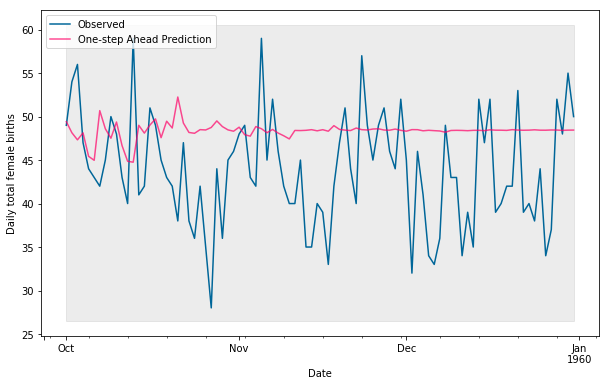

[7.99, 7.69, (1, 0, 1), (1, 0, 0, 14)]
RMSE:  7.9867608650528785


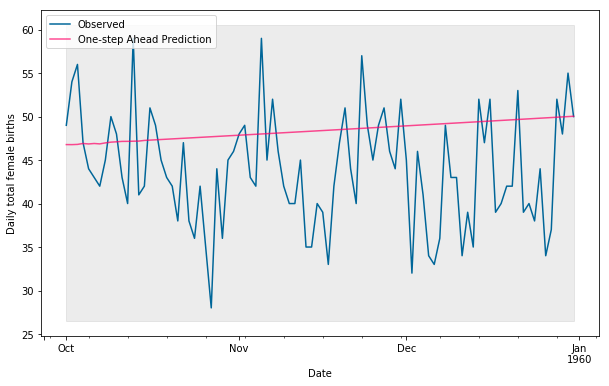

[7.99, 7.81, (7, 1, 1), (2, 0, 1, 14)]
RMSE:  7.9863765104485225


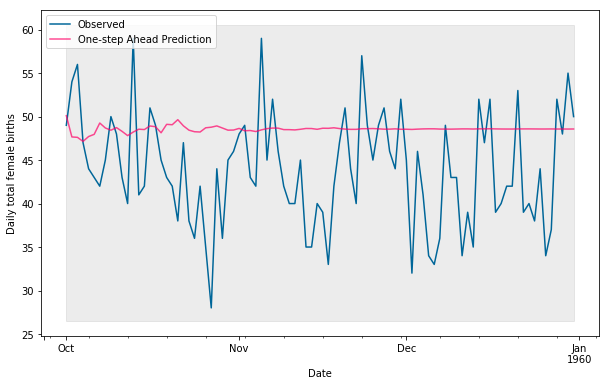

[8.0, 9.08, (1, 0, 0), (0, 1, 1, 7)]
RMSE:  7.998103595063731


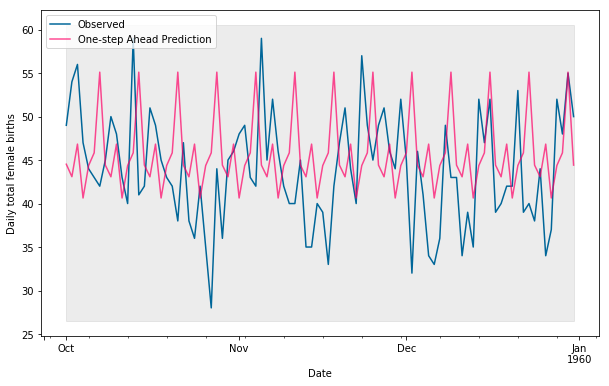

[8.02, 9.08, (1, 0, 0), (1, 1, 1, 7)]
RMSE:  8.020155916104844


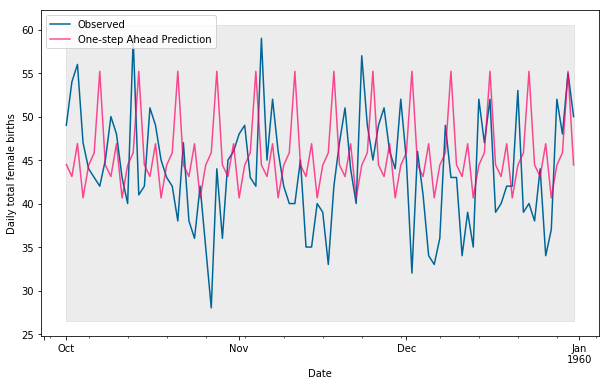

[8.03, 11.21, (2, 0, 0), (1, 1, 1, 14)]
RMSE:  8.03137390772915


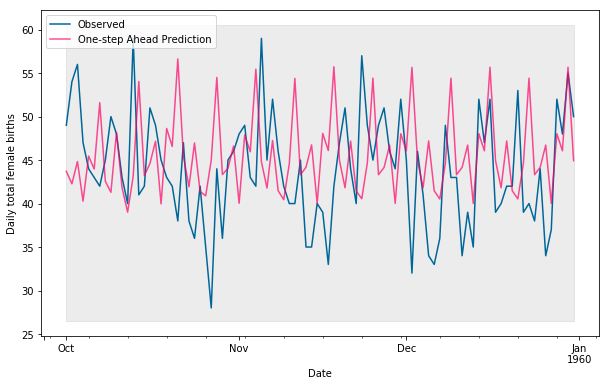

[8.04, 7.54, (7, 1, 0), (7, 0, 1, 4)]
RMSE:  8.044331922165219


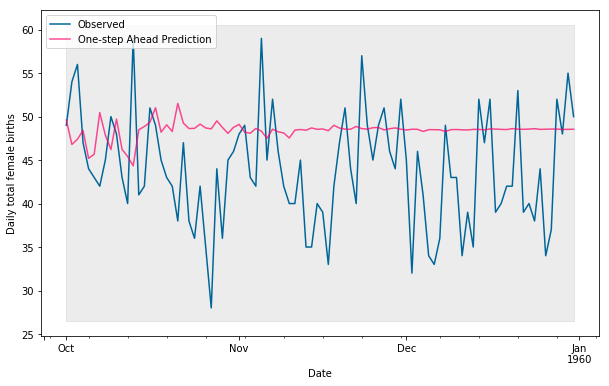

[8.04, 7.59, (7, 1, 1), (7, 0, 1, 4)]
RMSE:  8.041083611495864


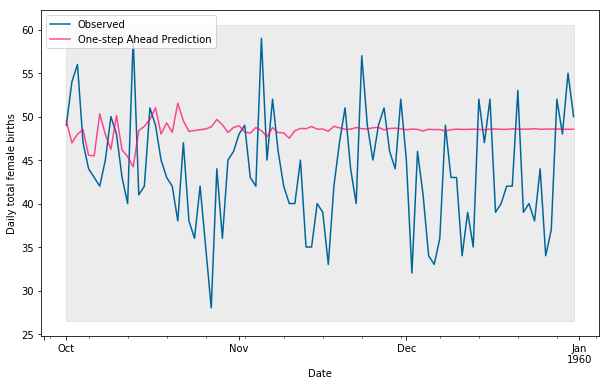

[8.05, 7.97, (2, 1, 1), (2, 0, 1, 14)]
RMSE:  8.049558090066652


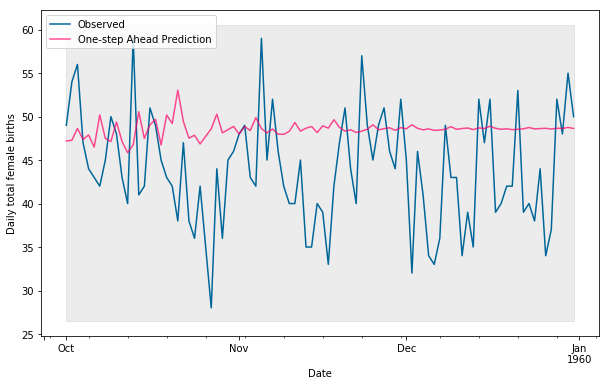

[8.05, 9.0, (7, 0, 0), (1, 1, 1, 7)]
RMSE:  8.048201351832178


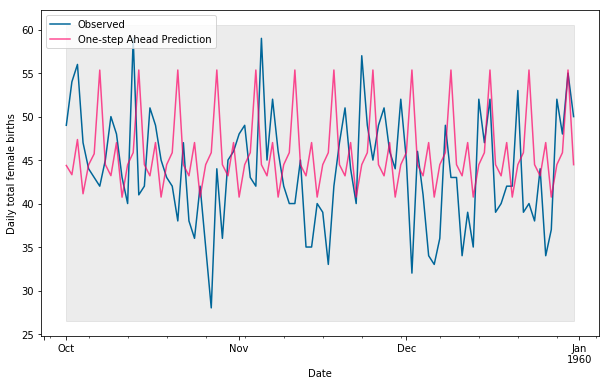

[8.08, 10.82, (7, 0, 0), (7, 1, 0, 14)]
RMSE:  8.076474872059237


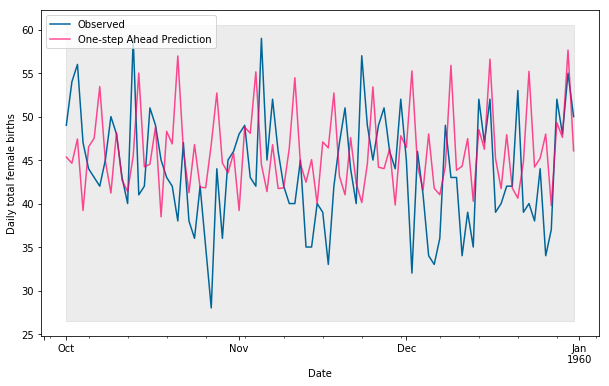

[8.08, 11.16, (7, 0, 0), (7, 1, 1, 14)]
RMSE:  8.078645957246206


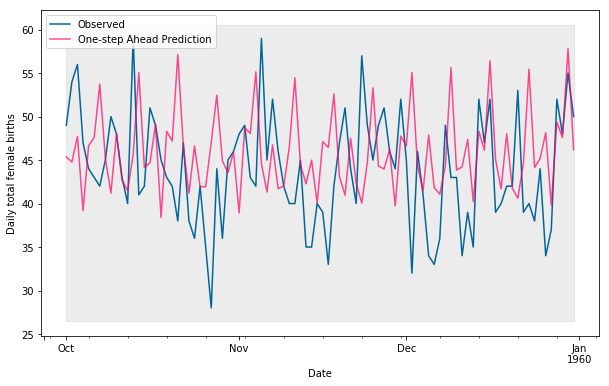

[8.09, 7.84, (1, 1, 1), (7, 0, 1, 4)]
RMSE:  8.086940152765104


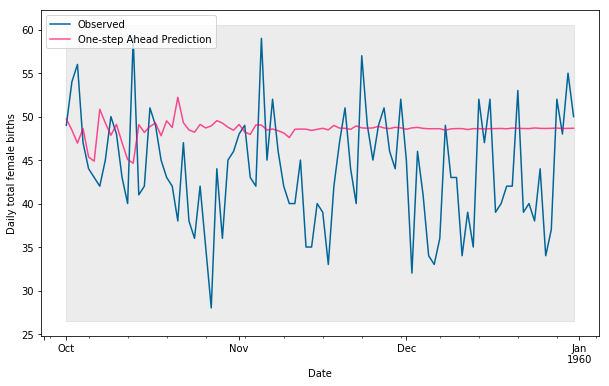

[8.1, 7.58, (2, 0, 1), (1, 0, 0, 7)]
RMSE:  8.095315623210915


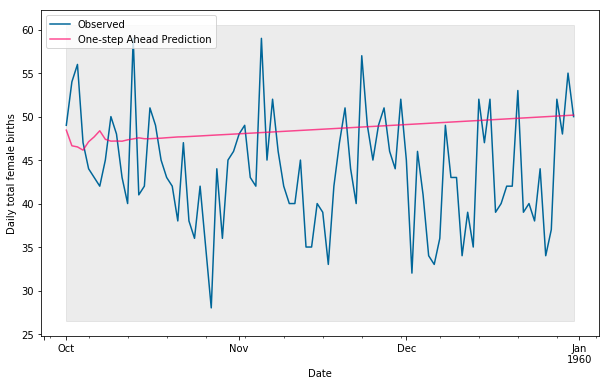

[8.11, 9.02, (7, 0, 0), (7, 1, 0, 4)]
RMSE:  8.11149235353724


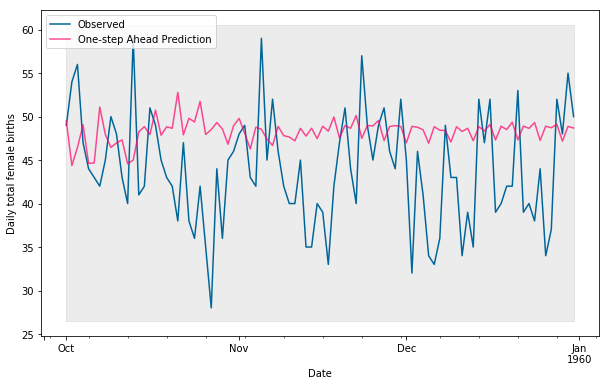

[8.11, 9.17, (7, 0, 1), (7, 1, 0, 4)]
RMSE:  8.108854611640654


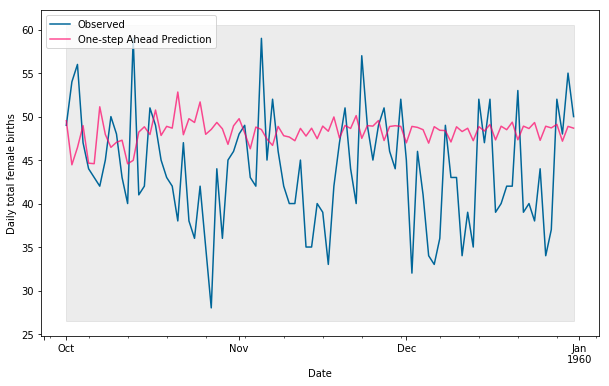

[8.12, 7.67, (7, 1, 1), (7, 0, 0, 4)]
RMSE:  8.121877766049188


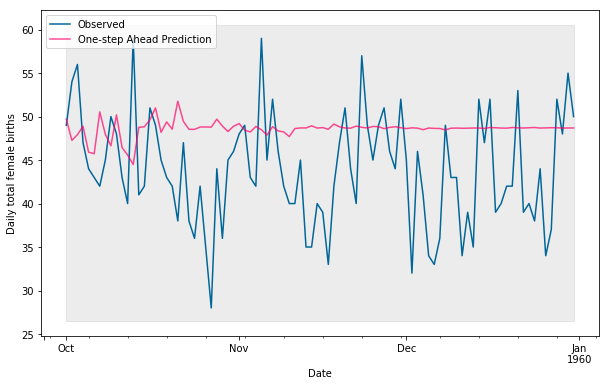

[8.12, 10.46, (7, 0, 1), (7, 1, 1, 4)]
RMSE:  8.12486917621654


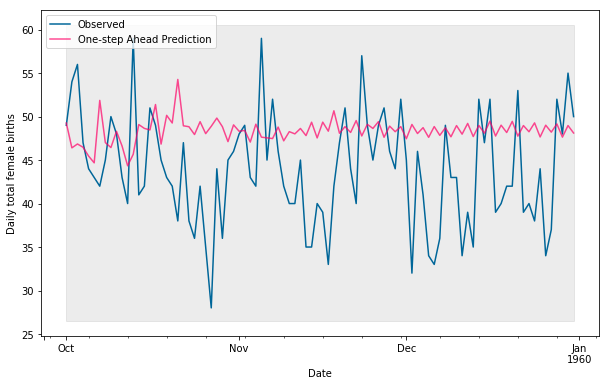

[8.15, 7.57, (7, 1, 0), (7, 0, 0, 4)]
RMSE:  8.150843928300674


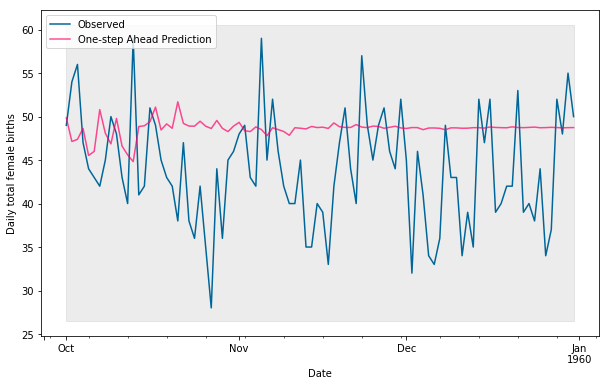

[8.16, 7.71, (2, 0, 1), (2, 0, 0, 7)]
RMSE:  8.16364563182095


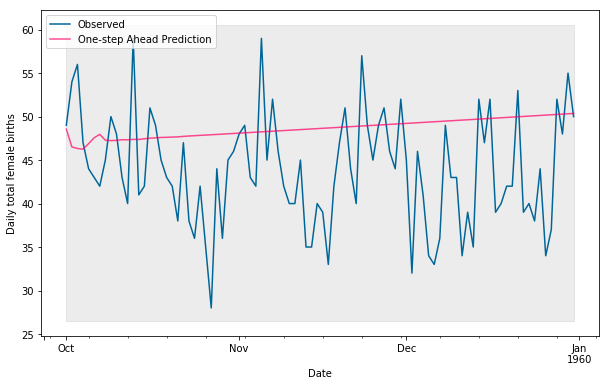

[8.2, 7.44, (7, 1, 1), (2, 0, 1, 7)]
RMSE:  8.203917652514269


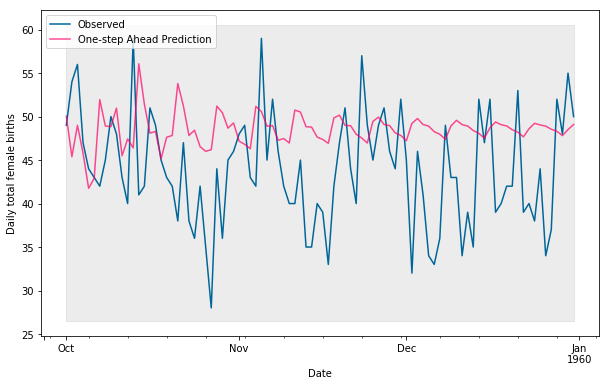

[8.21, 7.59, (2, 0, 1), (0, 0, 1, 4)]
RMSE:  8.209337799133646


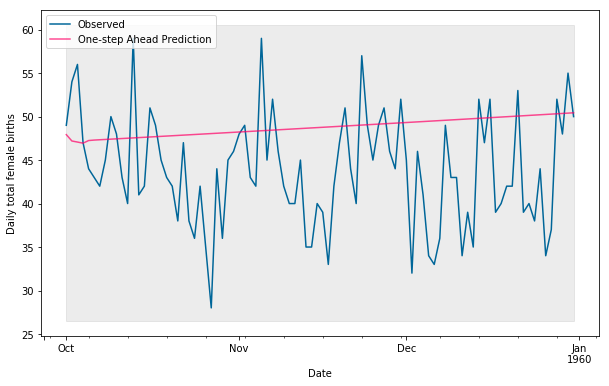

[8.21, 9.05, (2, 0, 0), (7, 1, 0, 4)]
RMSE:  8.212996188795627


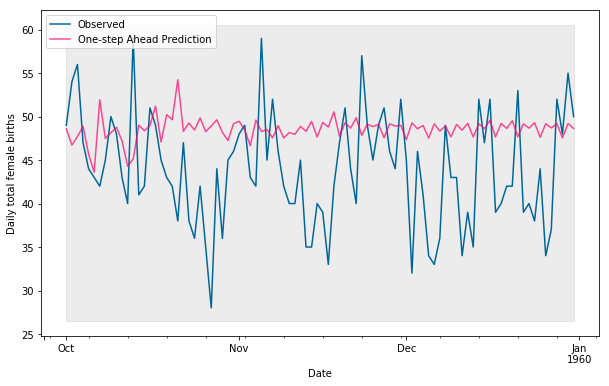

[8.22, 7.44, (7, 1, 0), (2, 0, 1, 7)]
RMSE:  8.219040456484242


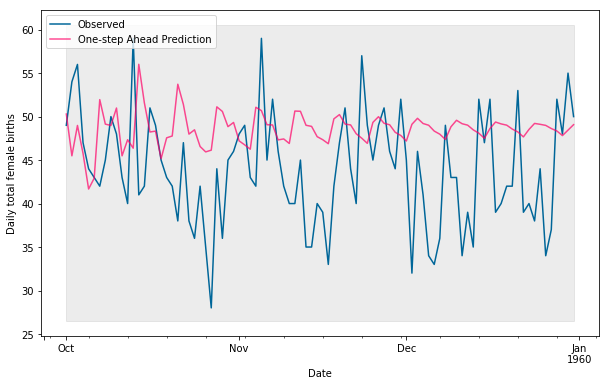

[8.22, 9.05, (1, 0, 0), (7, 1, 0, 4)]
RMSE:  8.22197160162095


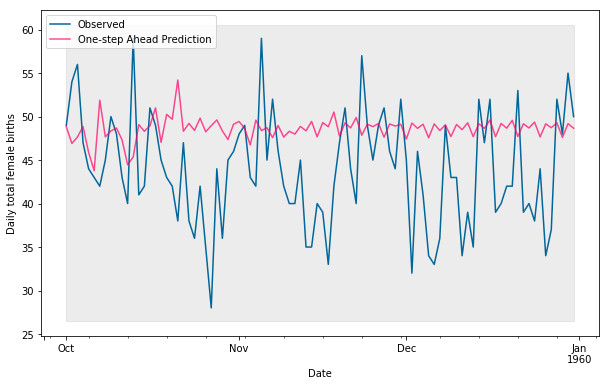

[8.22, 9.07, (1, 0, 1), (7, 1, 0, 4)]
RMSE:  8.22195737631802


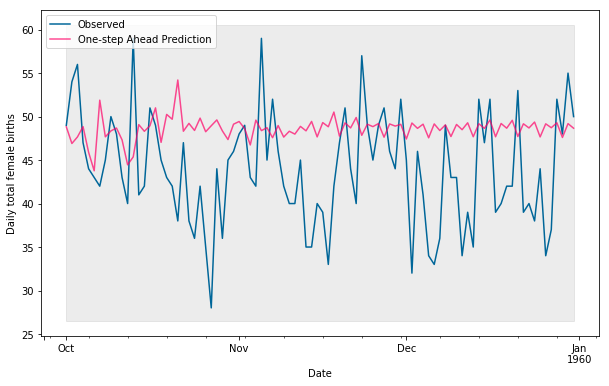

[8.22, 11.46, (1, 0, 0), (1, 1, 1, 14)]
RMSE:  8.221111600169234


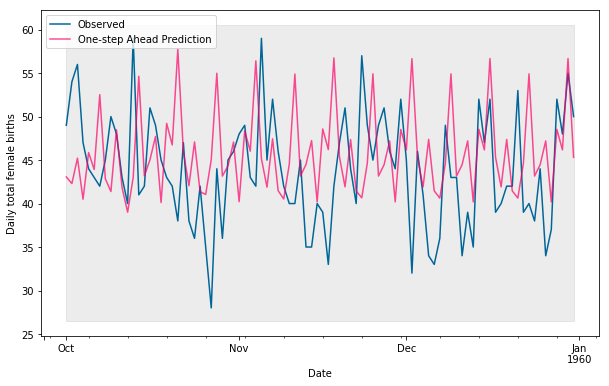

[8.23, 9.59, (7, 0, 1), (1, 1, 1, 7)]
RMSE:  8.23110582633605


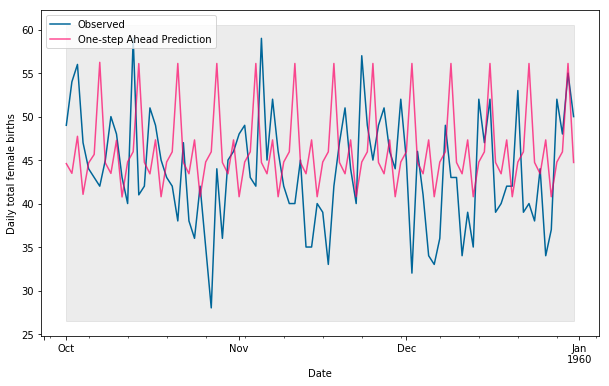

[8.27, 7.72, (2, 0, 1), (1, 0, 0, 14)]
RMSE:  8.273626275208242


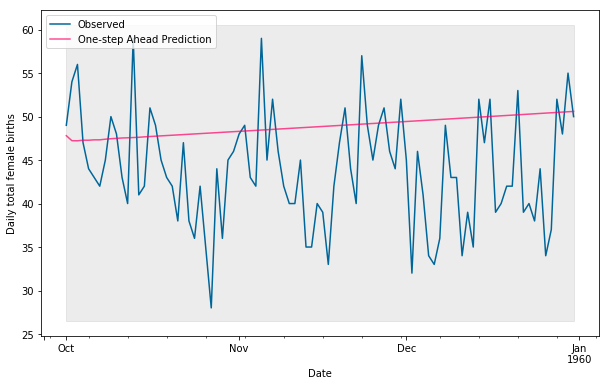

[8.33, 11.83, (1, 0, 0), (7, 1, 0, 14)]
RMSE:  8.333475429145507


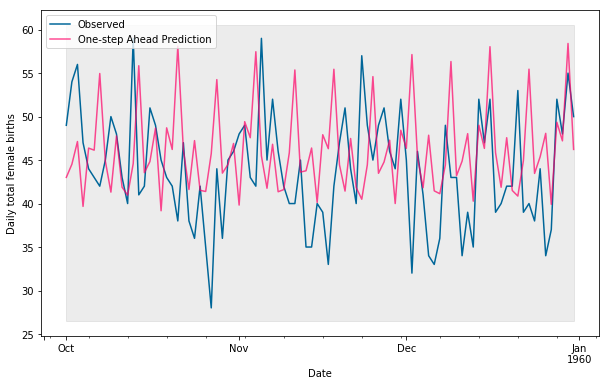

[8.33, 11.83, (1, 0, 0), (7, 1, 1, 14)]
RMSE:  8.333542589505468


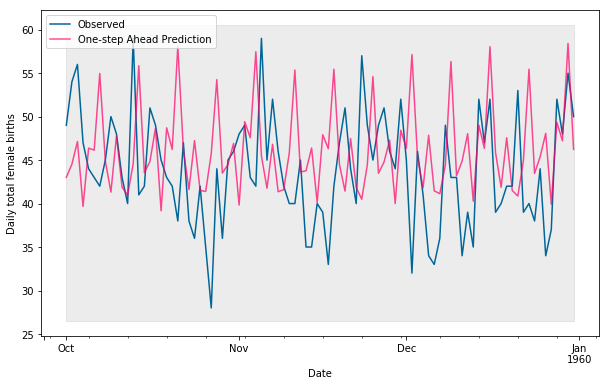

[8.34, 7.67, (7, 1, 0), (2, 0, 1, 14)]
RMSE:  8.341858119920923


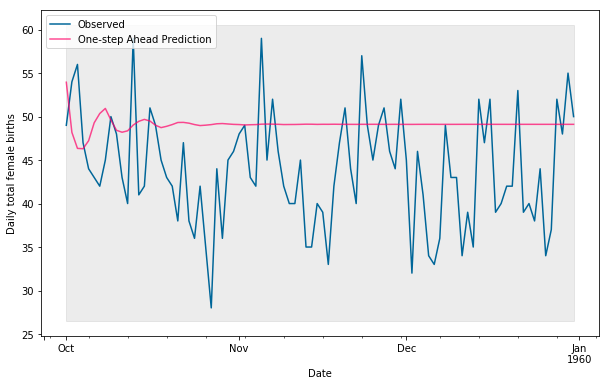

[8.35, 7.68, (7, 1, 0), (1, 0, 0, 14)]
RMSE:  8.350072898625397


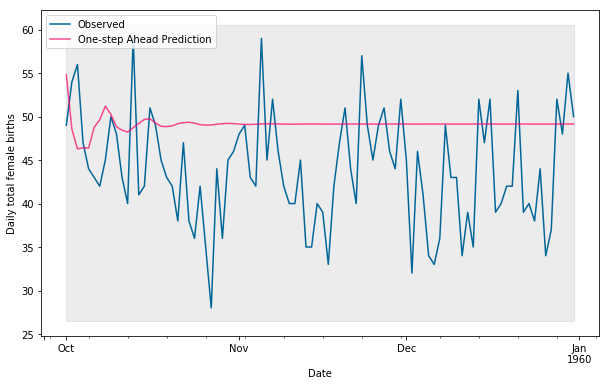

[8.36, 7.68, (7, 1, 0), (1, 0, 1, 14)]
RMSE:  8.357916777042906


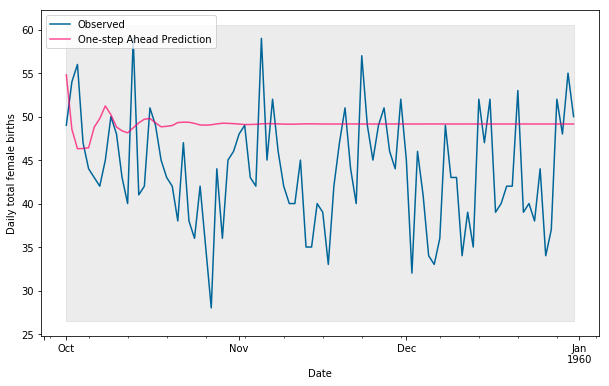

[8.36, 9.8, (7, 0, 1), (7, 1, 1, 14)]
RMSE:  8.358500697944715


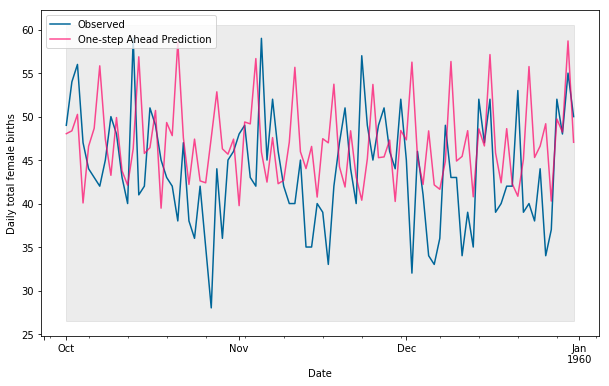

[8.37, 11.64, (2, 0, 0), (7, 1, 0, 14)]
RMSE:  8.366233993925952


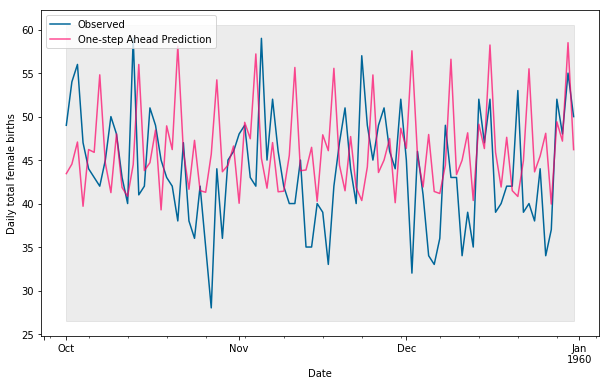

[8.38, 7.55, (1, 0, 1), (0, 0, 1, 7)]
RMSE:  8.376612433504206


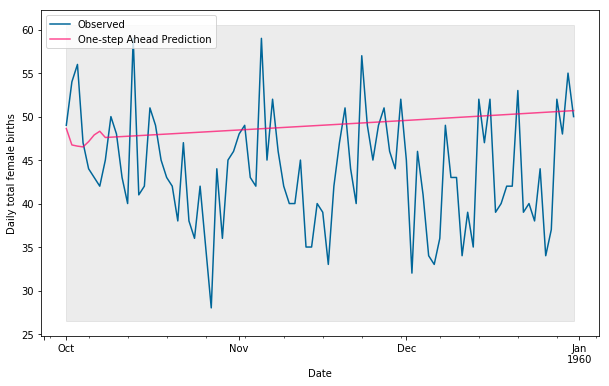

[8.38, 7.68, (7, 1, 0), (0, 0, 1, 14)]
RMSE:  8.375115149841612


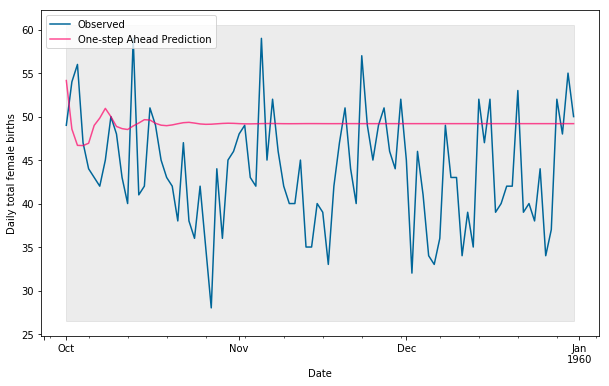

[8.41, 8.68, (7, 0, 1), (2, 0, 1, 7)]
RMSE:  8.408384102336155


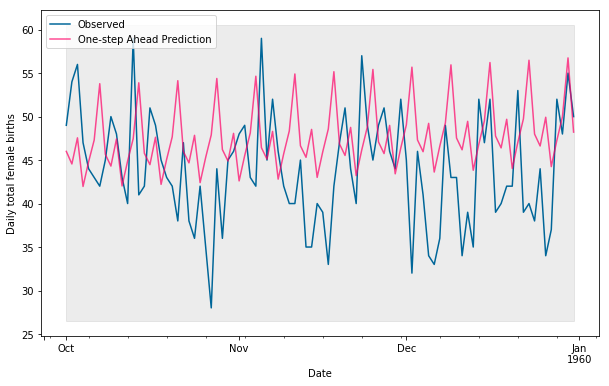

[8.43, 7.78, (7, 1, 1), (2, 0, 0, 14)]
RMSE:  8.426779979082342


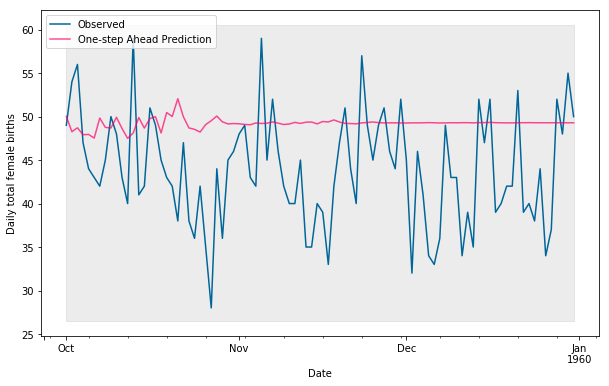

[8.45, 7.66, (1, 0, 1), (2, 0, 0, 7)]
RMSE:  8.452964156883882


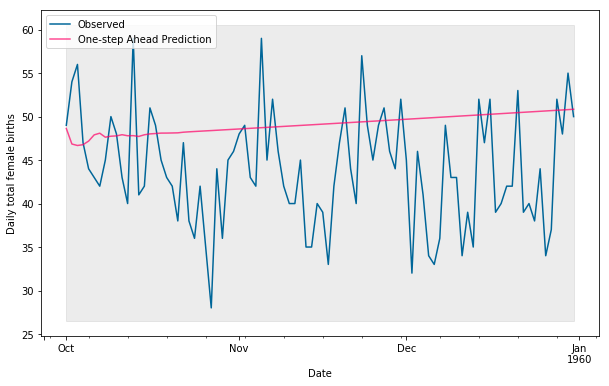

[8.46, 11.8, (2, 0, 0), (7, 1, 1, 14)]
RMSE:  8.458942886082268


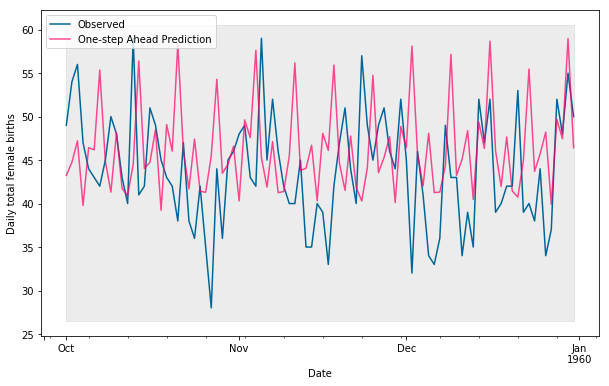

[8.47, 8.18, (7, 0, 0), (0, 0, 0, 4)]
RMSE:  8.474311200502553


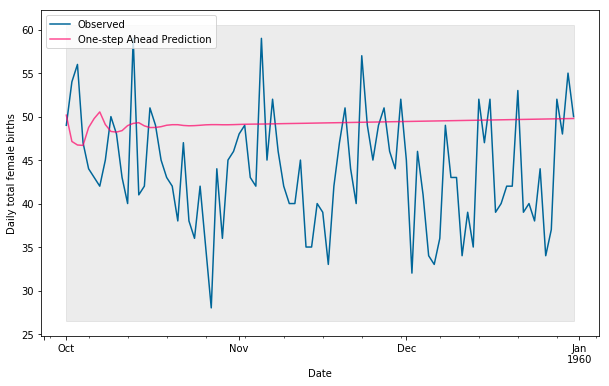

[8.47, 8.18, (7, 0, 0), (0, 0, 0, 7)]
RMSE:  8.474311200502553


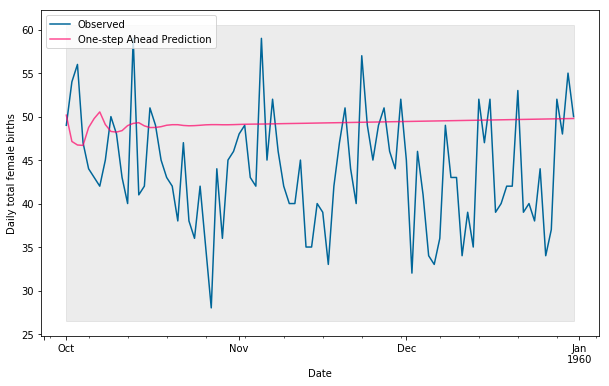

[8.47, 8.18, (7, 0, 0), (0, 0, 0, 14)]
RMSE:  8.474311200502553


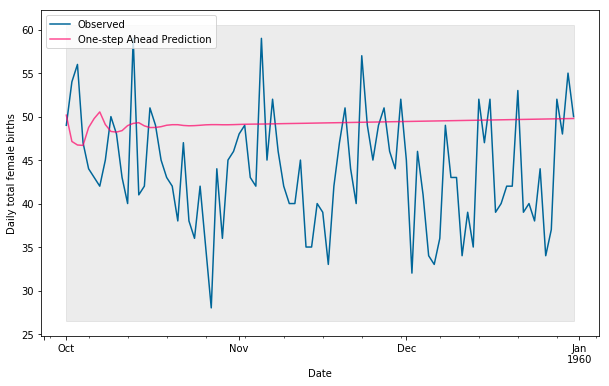

[8.48, 10.71, (1, 0, 0), (1, 0, 0, 7)]
RMSE:  8.479693254637146


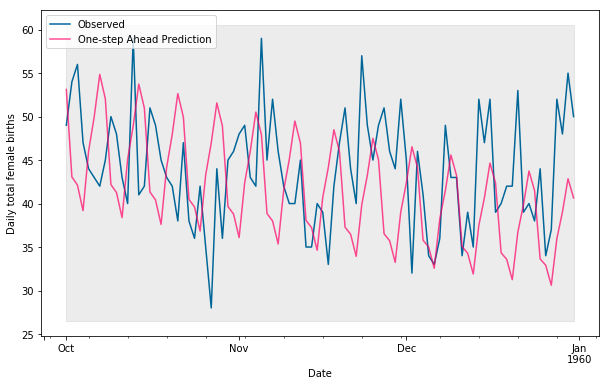

[8.49, 7.85, (1, 0, 1), (2, 0, 1, 4)]
RMSE:  8.490641108725754


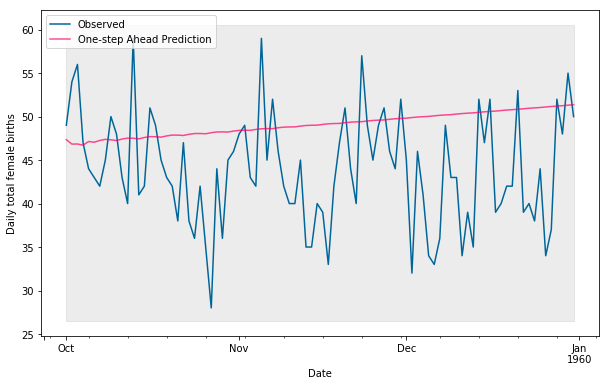

[8.49, 8.72, (2, 0, 1), (2, 0, 0, 4)]
RMSE:  8.490116590737298


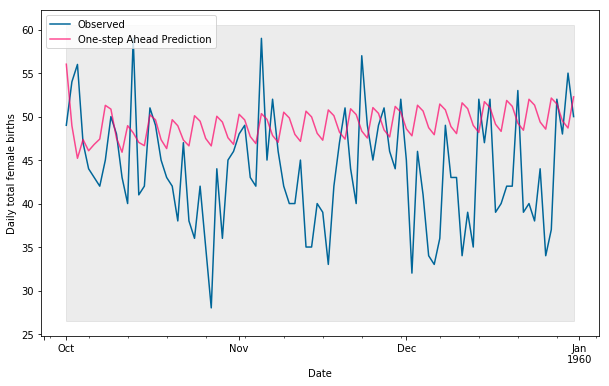

[8.5, 7.68, (7, 1, 0), (0, 0, 0, 4)]
RMSE:  8.499558669237759


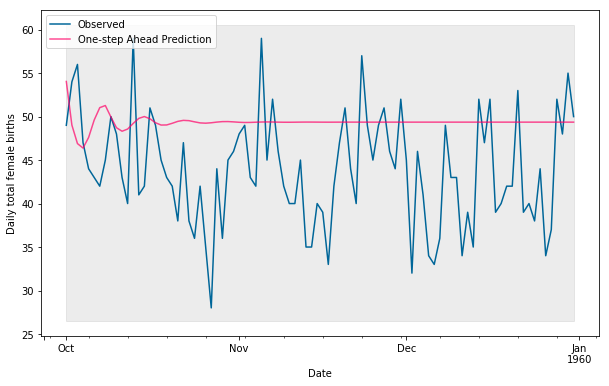

[8.5, 7.68, (7, 1, 0), (0, 0, 0, 7)]
RMSE:  8.499558669237759


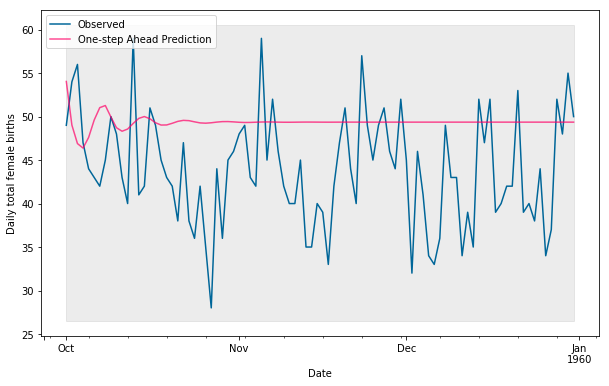

[8.5, 7.68, (7, 1, 0), (0, 0, 0, 14)]
RMSE:  8.499558669237759


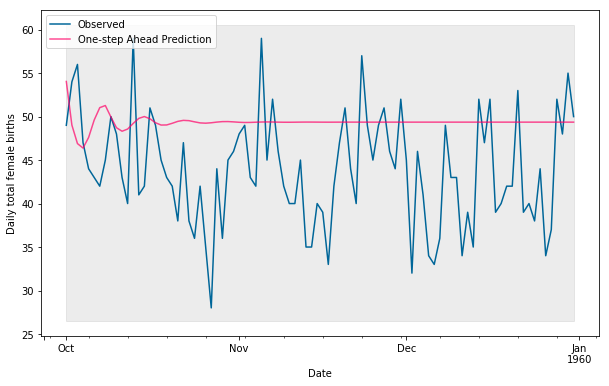

[8.53, 7.66, (7, 1, 0), (2, 0, 0, 14)]
RMSE:  8.534946338496978


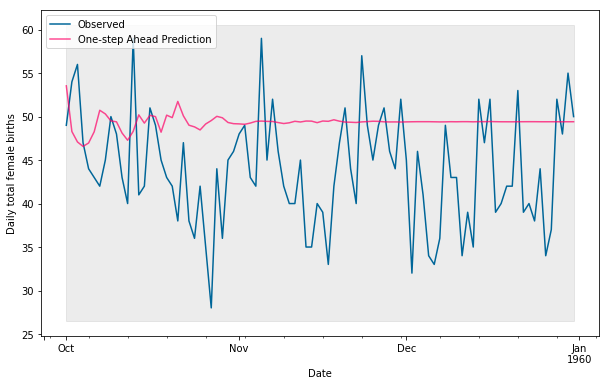

[8.57, 7.95, (2, 0, 1), (1, 0, 1, 7)]
RMSE:  8.574126315444829


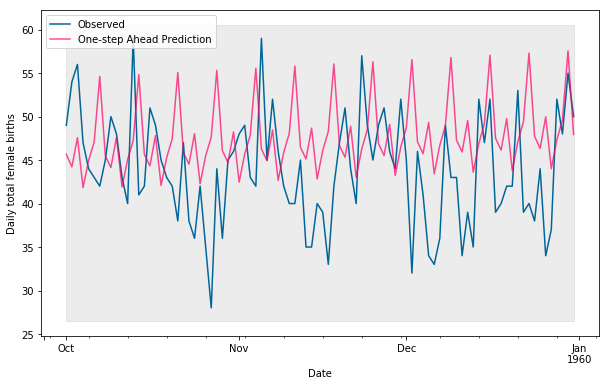

[8.59, 7.71, (2, 0, 1), (0, 0, 1, 14)]
RMSE:  8.590868580001068


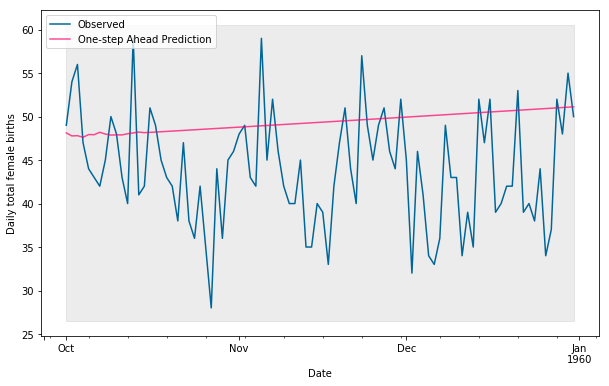

[8.6, 7.47, (7, 1, 0), (2, 0, 0, 7)]
RMSE:  8.600354312527354


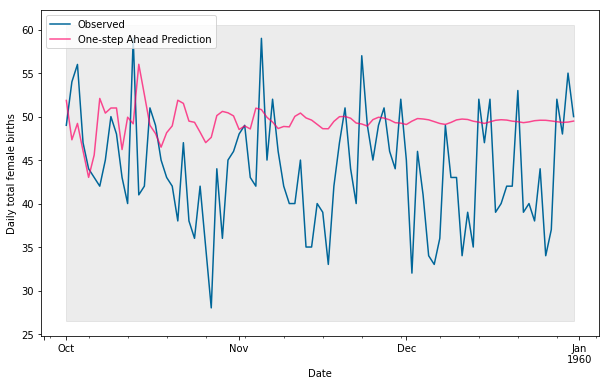

[8.6, 7.47, (7, 1, 1), (2, 0, 0, 7)]
RMSE:  8.601827818723384


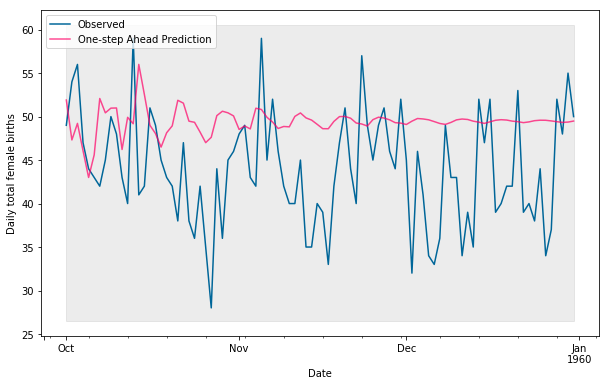

[8.6, 7.95, (1, 0, 1), (1, 0, 1, 7)]
RMSE:  8.596563790190507


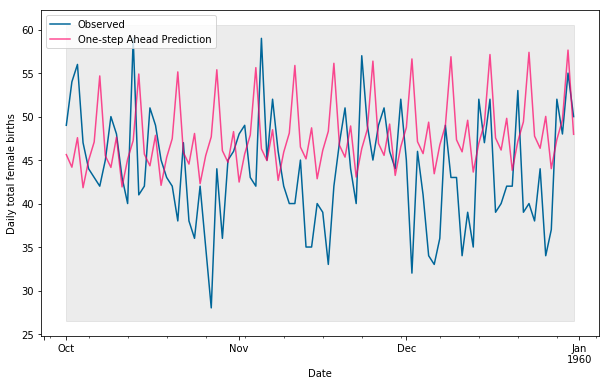

[8.63, 7.56, (7, 1, 0), (7, 0, 1, 7)]
RMSE:  8.632170579663706


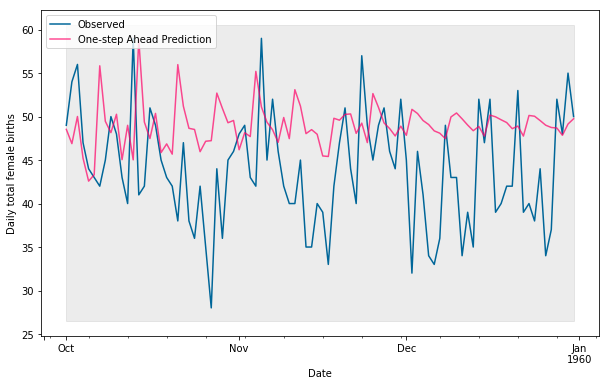

[8.63, 9.49, (7, 0, 1), (7, 1, 0, 14)]
RMSE:  8.627534181781472


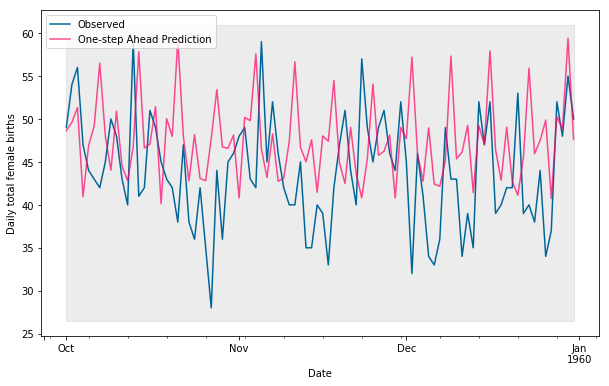

[8.63, 11.06, (2, 0, 0), (2, 0, 1, 14)]
RMSE:  8.625463240344978


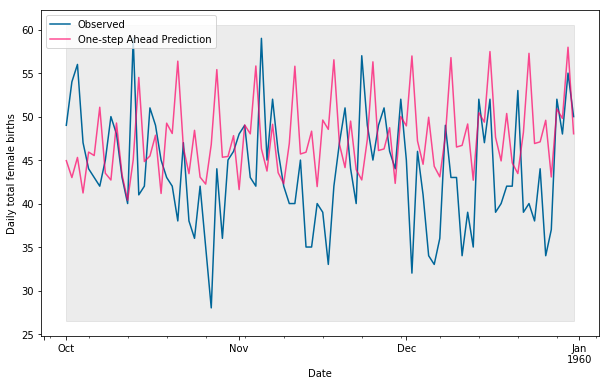

[8.64, 10.34, (7, 0, 1), (2, 1, 1, 14)]
RMSE:  8.640288859224327


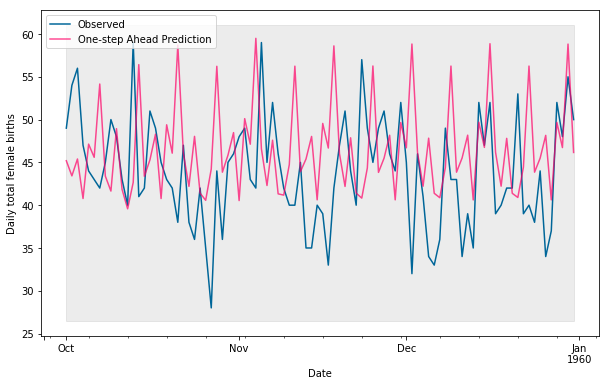

[8.65, 7.54, (7, 1, 1), (0, 0, 1, 4)]
RMSE:  8.64583449693839


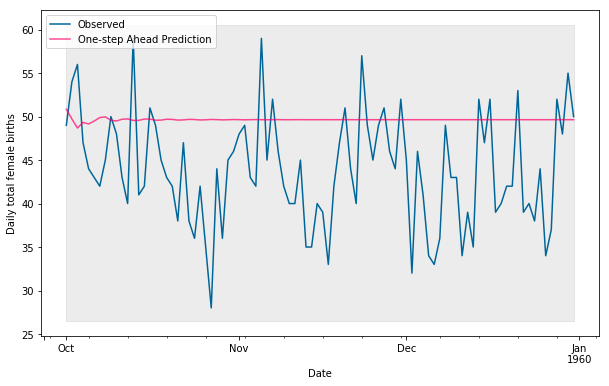

[8.66, 7.59, (7, 1, 0), (0, 0, 1, 4)]
RMSE:  8.65941878667381


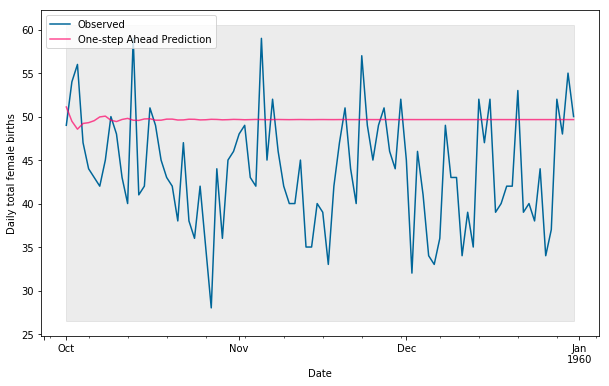

[8.66, 7.6, (1, 0, 1), (2, 0, 0, 4)]
RMSE:  8.660611975403521


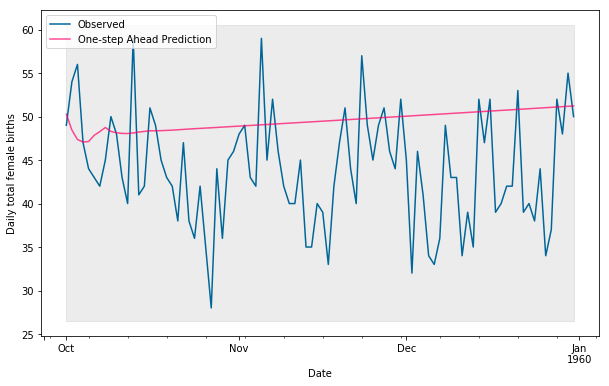

[8.66, 8.81, (2, 0, 0), (1, 0, 1, 7)]
RMSE:  8.664110178290471


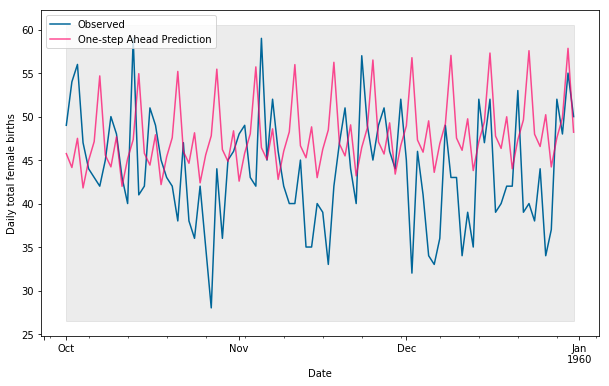

[8.67, 8.63, (1, 0, 1), (2, 0, 1, 14)]
RMSE:  8.666748744655255


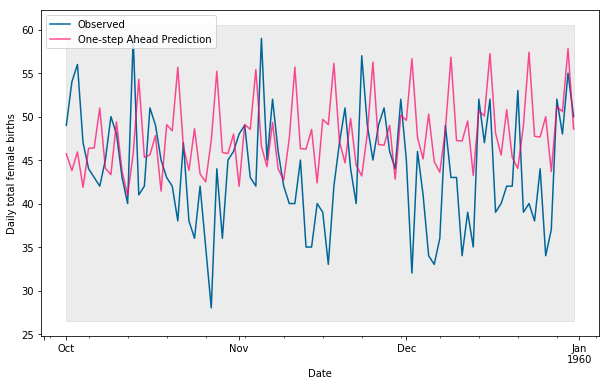

[8.69, 8.86, (2, 1, 0), (2, 1, 0, 7)]
RMSE:  8.692166350328826


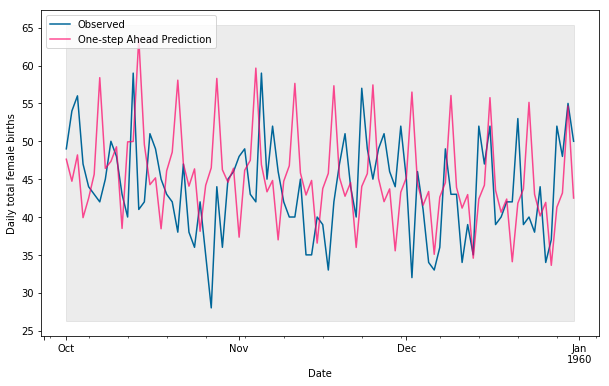

[8.71, 7.67, (7, 1, 0), (1, 0, 0, 4)]
RMSE:  8.706558386070252


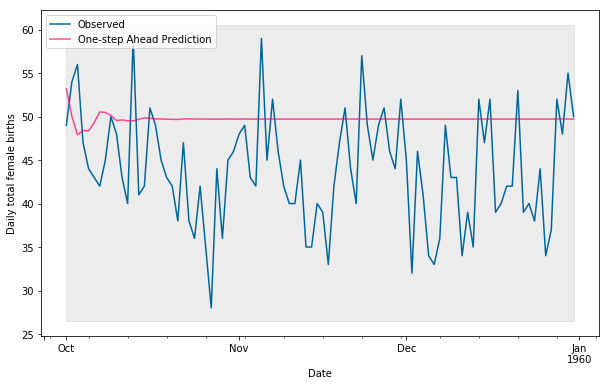

[8.71, 8.86, (7, 0, 0), (2, 0, 1, 7)]
RMSE:  8.71106111848999


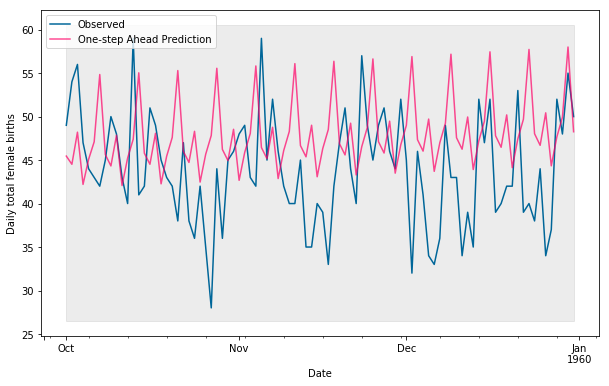

[8.72, 9.77, (7, 0, 1), (0, 1, 0, 4)]
RMSE:  8.724090655475365


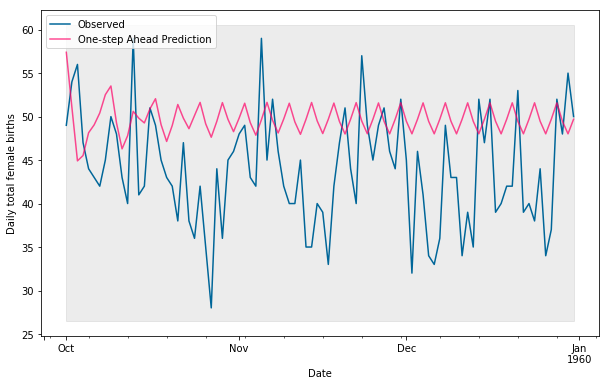

[8.72, 11.32, (7, 0, 0), (2, 1, 1, 14)]
RMSE:  8.723595267251108


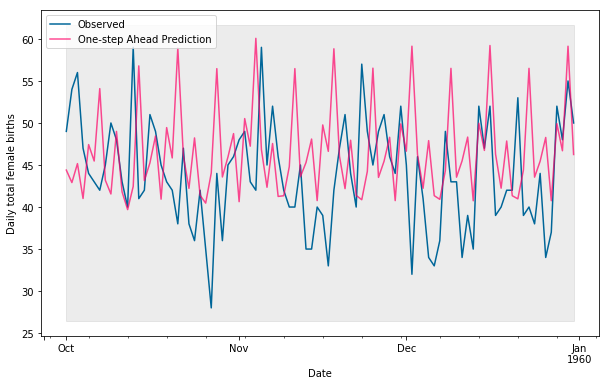

[8.73, 8.77, (7, 0, 1), (0, 0, 1, 7)]
RMSE:  8.72568227102998


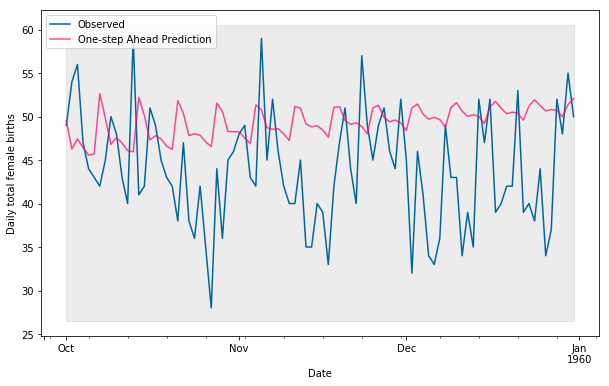

[8.74, 8.66, (2, 0, 1), (2, 0, 1, 14)]
RMSE:  8.74492423949629


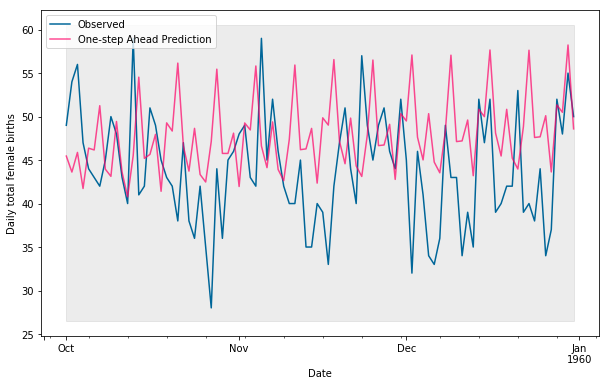

[8.75, 11.41, (1, 0, 0), (2, 0, 1, 14)]
RMSE:  8.747191168756403


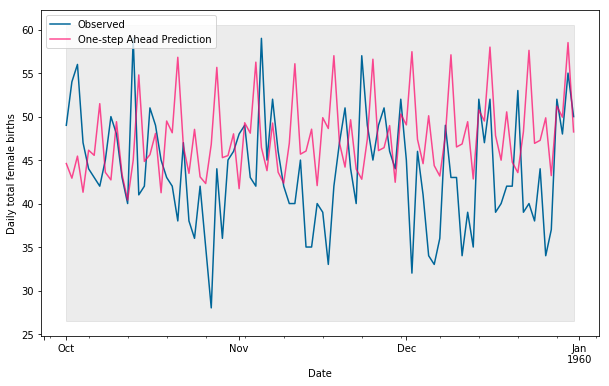

[8.76, 8.2, (7, 0, 0), (2, 0, 0, 14)]
RMSE:  8.756490173970715


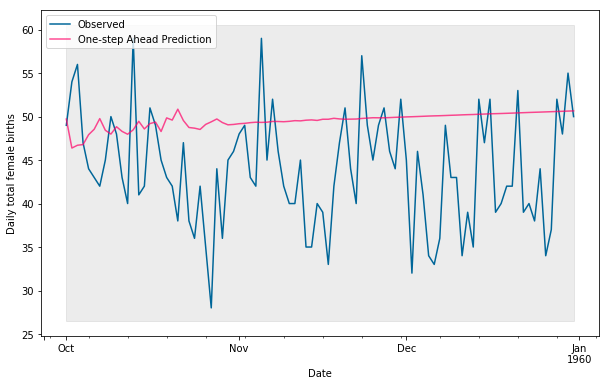

[8.77, 8.98, (1, 0, 0), (1, 0, 1, 7)]
RMSE:  8.767693658081756


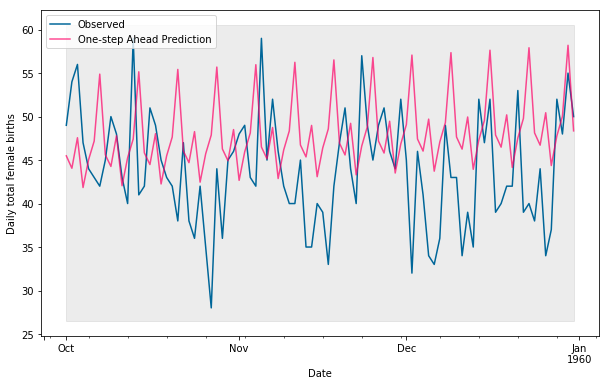

[8.78, 9.18, (1, 1, 0), (2, 1, 0, 7)]
RMSE:  8.775578643515312


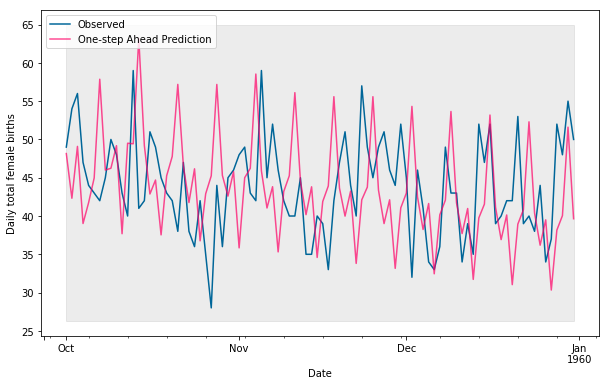

[8.79, 7.87, (1, 1, 1), (1, 1, 1, 4)]
RMSE:  8.785940018728116


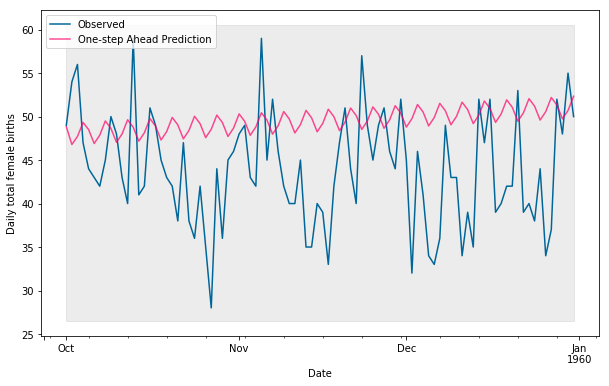

[8.8, 7.87, (2, 1, 1), (0, 1, 1, 4)]
RMSE:  8.799648605067356


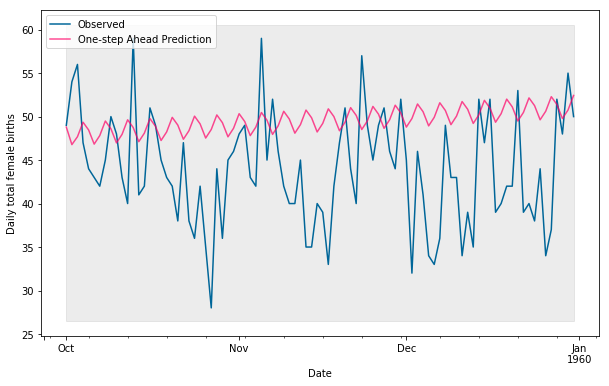

[8.82, 7.88, (2, 1, 1), (1, 1, 1, 4)]
RMSE:  8.823290129780302


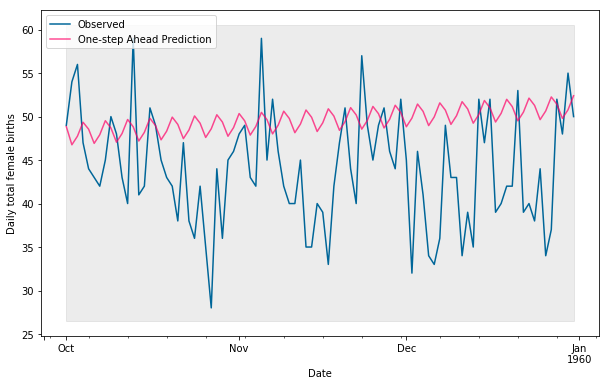

[8.84, 7.87, (1, 1, 1), (0, 1, 1, 4)]
RMSE:  8.83719796281489


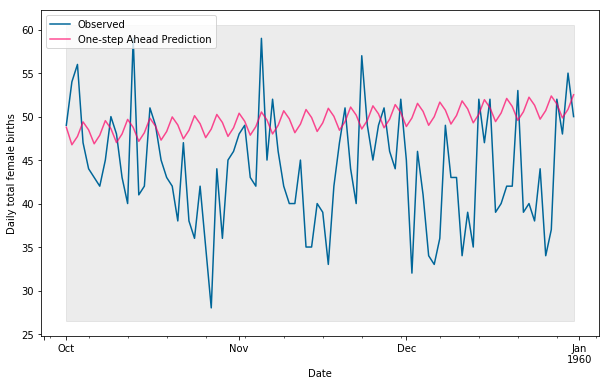

[8.84, 8.76, (7, 0, 0), (0, 0, 1, 7)]
RMSE:  8.84488137030654


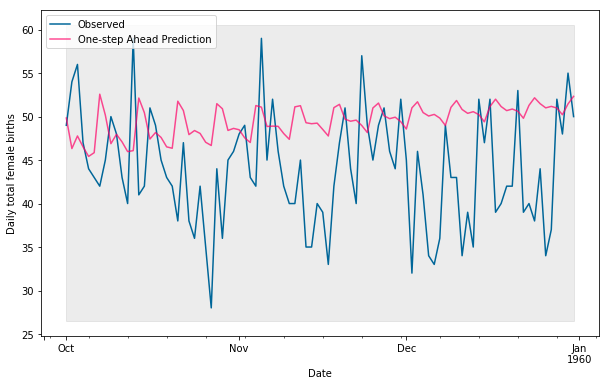

[8.86, 7.4, (7, 1, 0), (7, 0, 0, 7)]
RMSE:  8.857169986247962


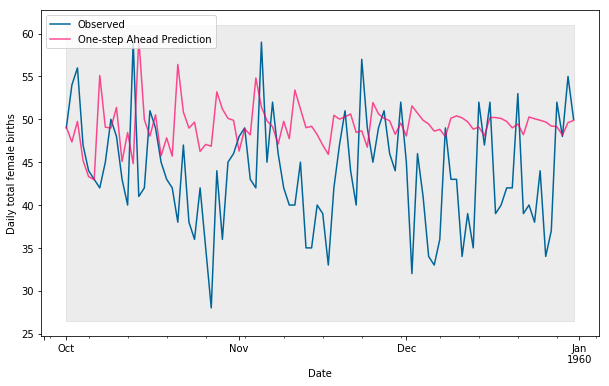

[8.88, 7.52, (1, 0, 1), (0, 0, 0, 4)]
RMSE:  8.877495388195431


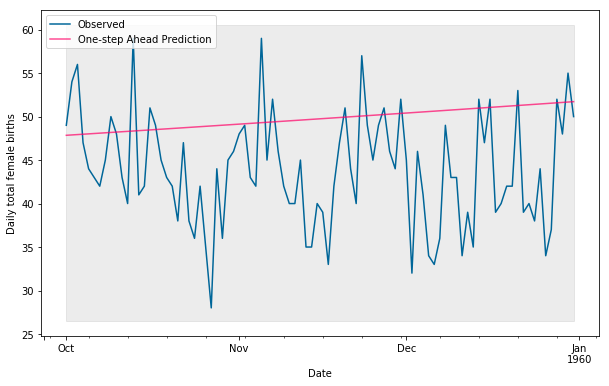

[8.88, 7.52, (1, 0, 1), (0, 0, 0, 7)]
RMSE:  8.877495388195431


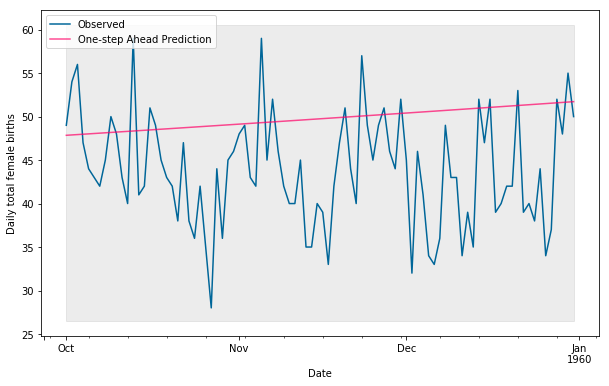

[8.88, 7.52, (1, 0, 1), (0, 0, 0, 14)]
RMSE:  8.877495388195431


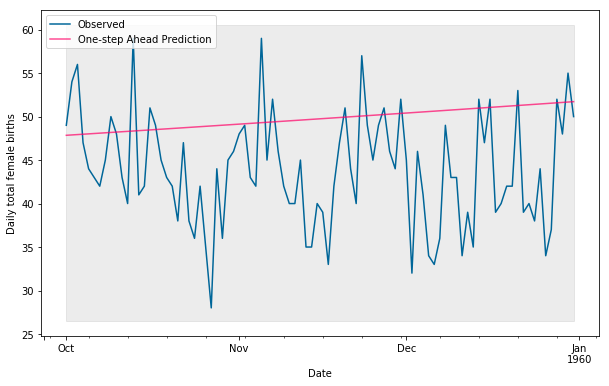

[8.91, 7.58, (1, 0, 1), (0, 0, 1, 4)]
RMSE:  8.910489538098696


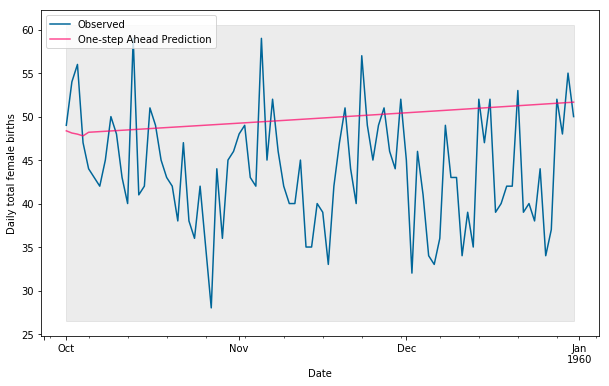

[8.92, 7.54, (1, 0, 1), (1, 0, 0, 4)]
RMSE:  8.918606840734101


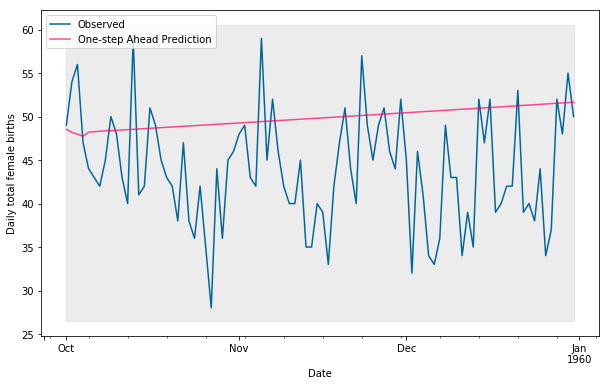

[8.93, 7.97, (1, 1, 1), (2, 1, 1, 4)]
RMSE:  8.931785905410745


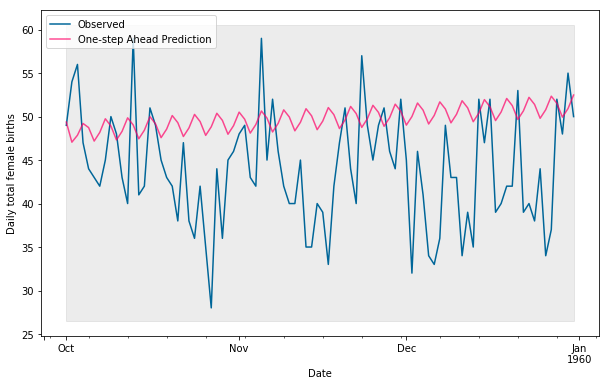

[8.94, 7.97, (7, 1, 1), (1, 1, 1, 4)]
RMSE:  8.938350990597533


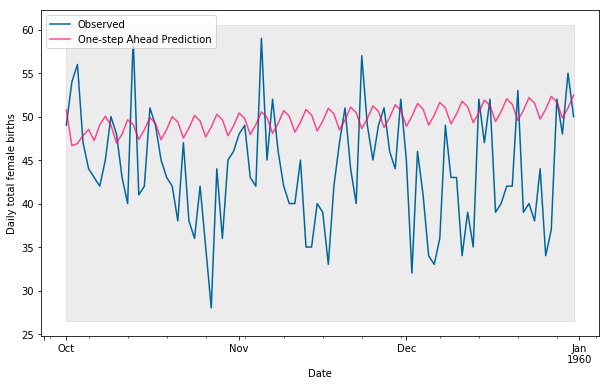

[8.97, 8.23, (2, 0, 1), (2, 0, 1, 7)]
RMSE:  8.965389290811796


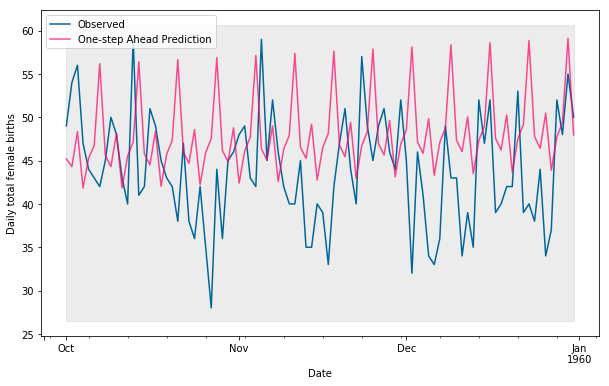

[8.98, 8.88, (2, 0, 0), (2, 0, 1, 7)]
RMSE:  8.980973872509027


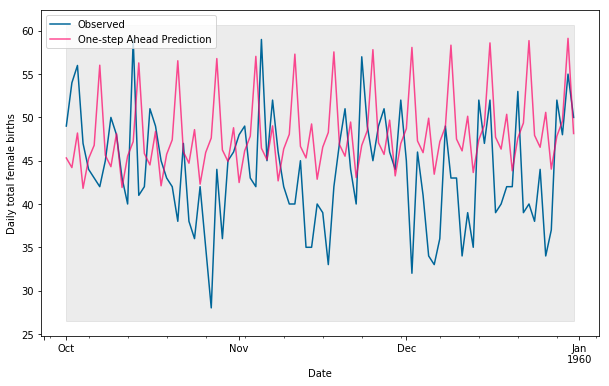

[8.98, 9.37, (7, 0, 0), (0, 1, 0, 4)]
RMSE:  8.981769172846471


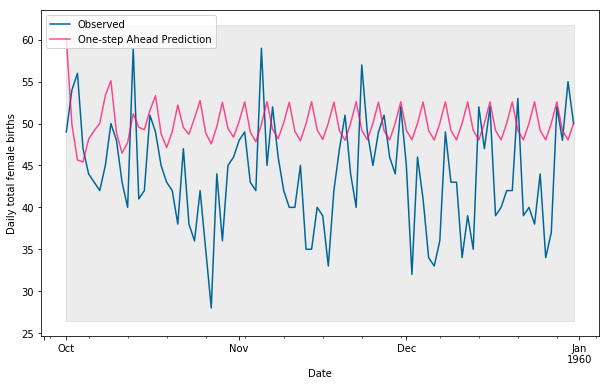

[8.99, 7.67, (7, 1, 0), (2, 0, 0, 4)]
RMSE:  8.986549708686166


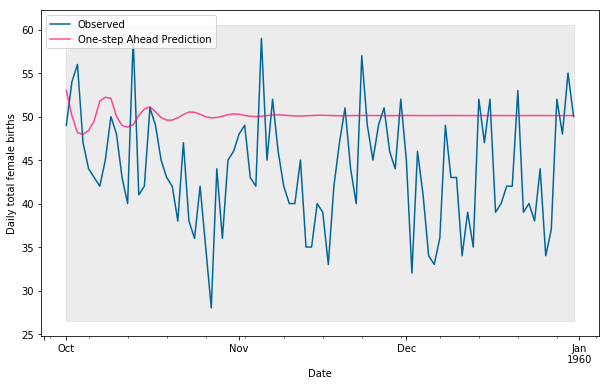

[8.99, 8.22, (7, 1, 0), (2, 1, 0, 7)]
RMSE:  8.993651467437319


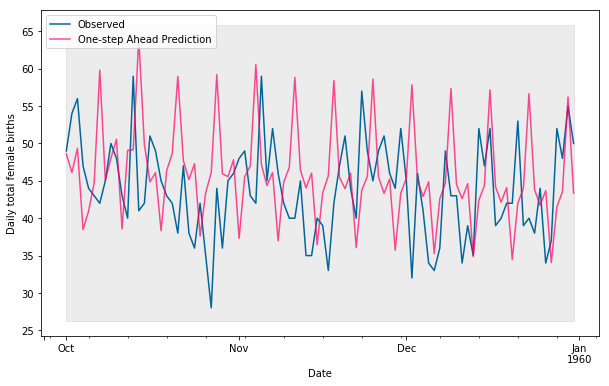

[8.99, 8.52, (1, 1, 1), (7, 0, 1, 14)]
RMSE:  8.98769041951001


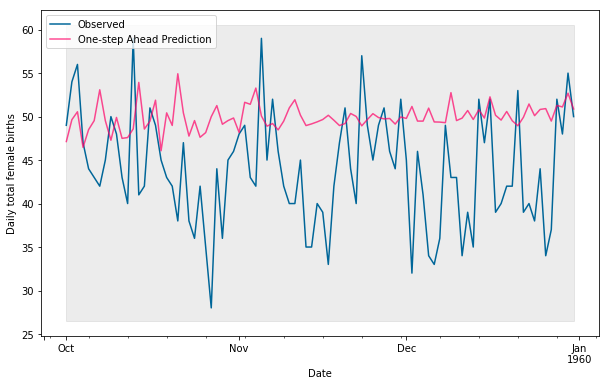

[9.0, 8.54, (1, 1, 1), (7, 0, 0, 14)]
RMSE:  9.000225936636129


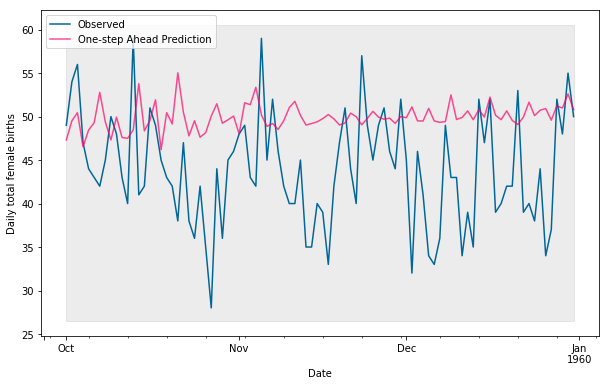

[9.01, 8.18, (1, 0, 1), (2, 0, 1, 7)]
RMSE:  9.010042294447578


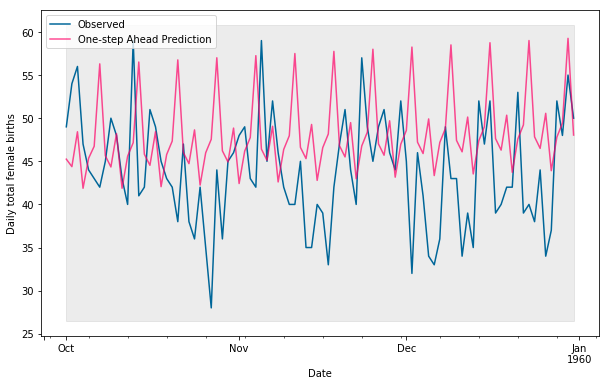

[9.04, 7.67, (7, 1, 0), (1, 0, 0, 7)]
RMSE:  9.035110613497723


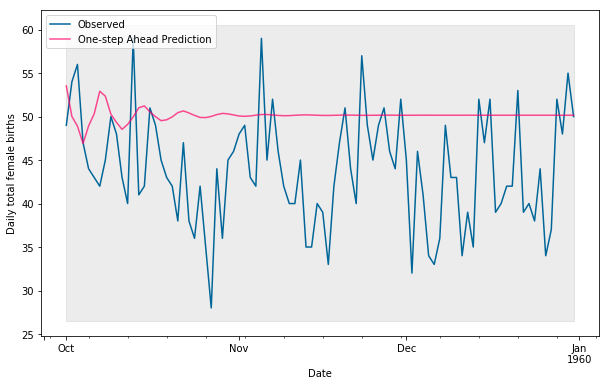

[9.04, 9.13, (7, 0, 0), (2, 1, 1, 7)]
RMSE:  9.041480722366805


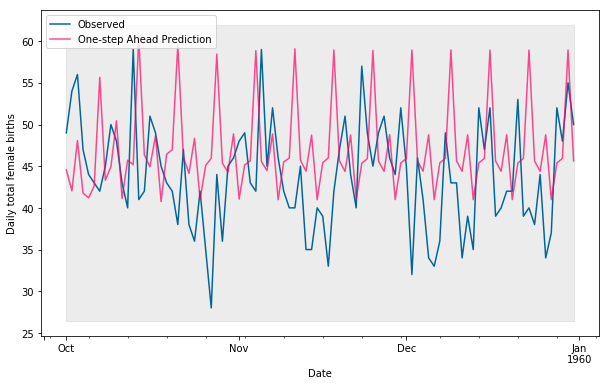

[9.06, 9.03, (1, 0, 0), (2, 0, 1, 7)]
RMSE:  9.06080704007516


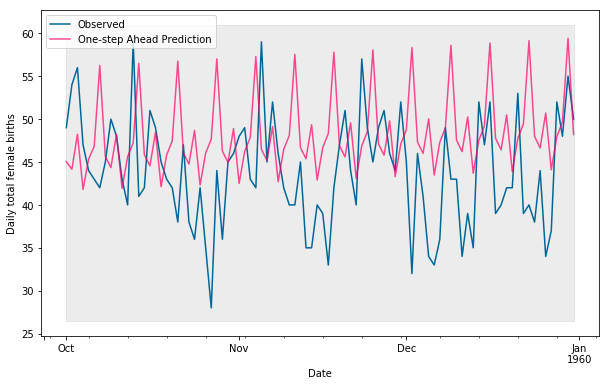

[9.07, 8.4, (7, 0, 0), (2, 0, 1, 14)]
RMSE:  9.071690212977801


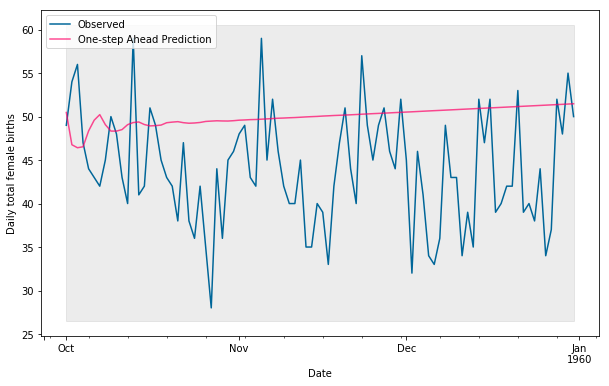

[9.08, 9.81, (7, 0, 1), (1, 1, 0, 4)]
RMSE:  9.082699838702553


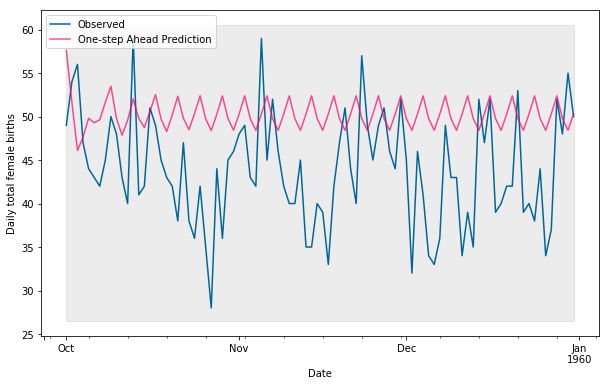

[9.1, 8.05, (2, 1, 1), (7, 0, 0, 7)]
RMSE:  9.100418516387883


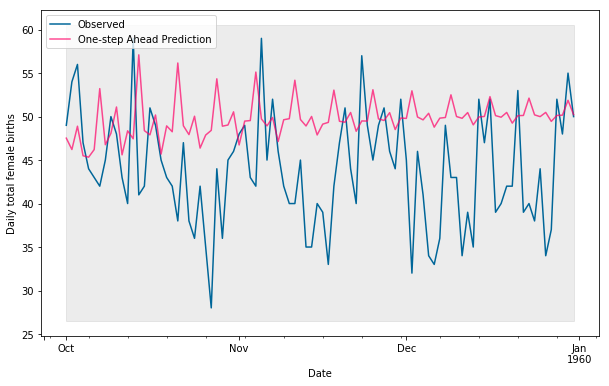

[9.13, 8.0, (1, 1, 1), (7, 0, 0, 7)]
RMSE:  9.128570055838175


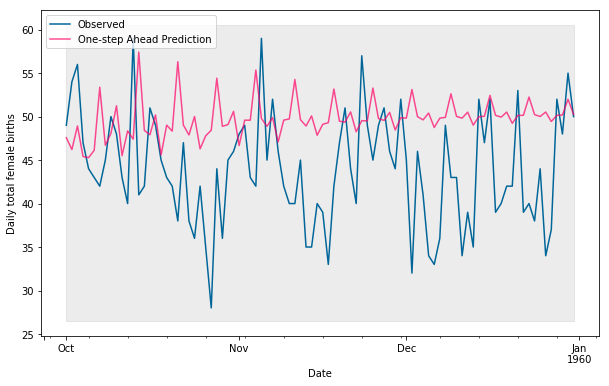

[9.14, 8.0, (2, 1, 1), (2, 1, 1, 4)]
RMSE:  9.143896561793294


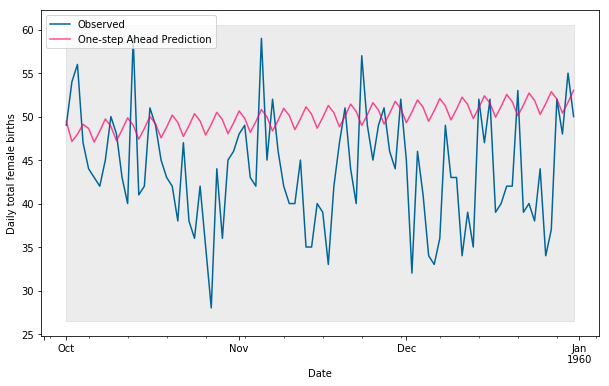

[9.14, 9.11, (2, 0, 0), (2, 1, 1, 7)]
RMSE:  9.14058891242159


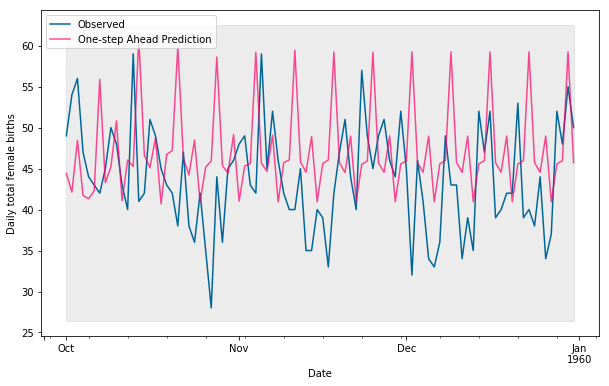

[9.15, 9.45, (2, 0, 1), (2, 1, 1, 7)]
RMSE:  9.150551248948585


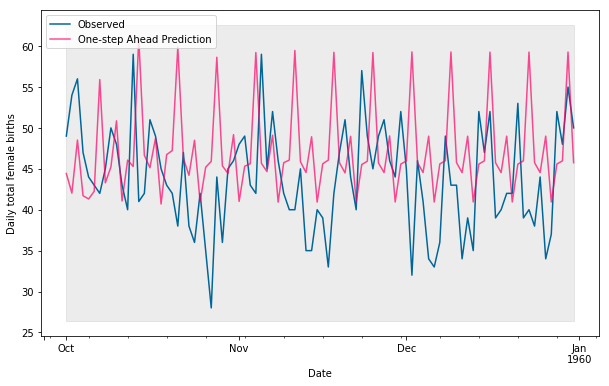

[9.16, 8.75, (1, 0, 1), (2, 1, 1, 7)]
RMSE:  9.157210365698498


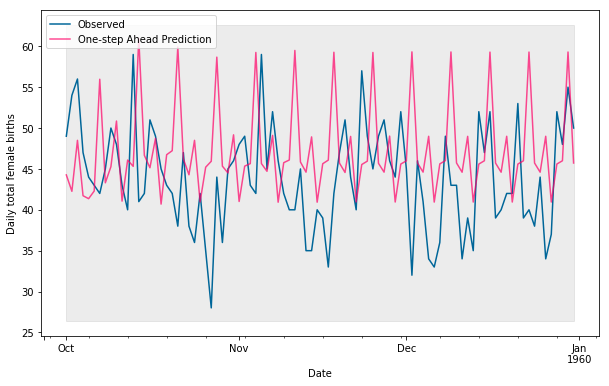

[9.18, 9.19, (1, 0, 0), (2, 1, 1, 7)]
RMSE:  9.177902279804412


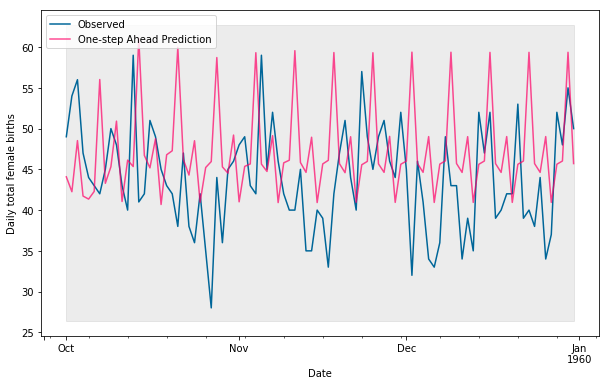

[9.19, 8.05, (1, 1, 1), (7, 0, 1, 7)]
RMSE:  9.186483297099251


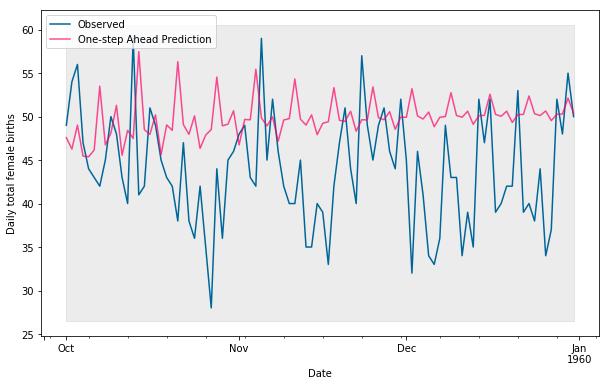

[9.19, 10.63, (1, 0, 1), (0, 1, 0, 7)]
RMSE:  9.188485087856344


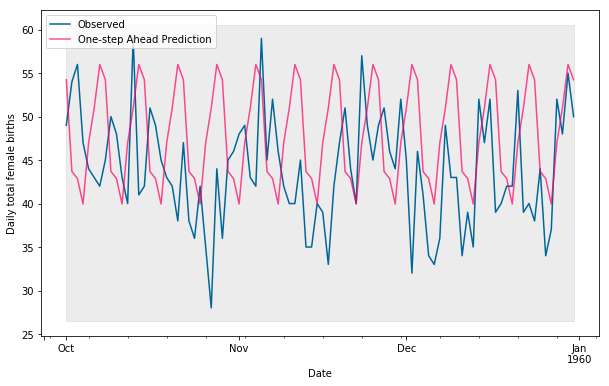

[9.21, 7.61, (7, 0, 1), (0, 0, 0, 4)]
RMSE:  9.209577389425915


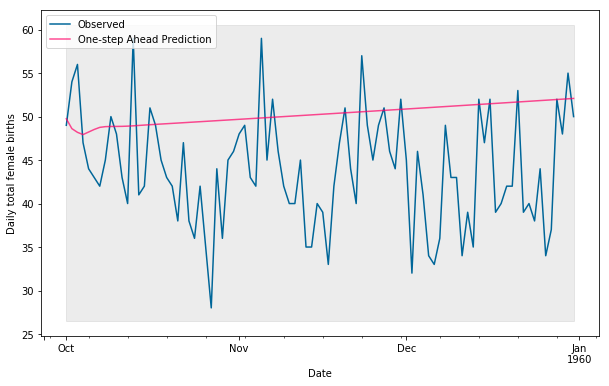

[9.21, 7.61, (7, 0, 1), (0, 0, 0, 7)]
RMSE:  9.209577389425915


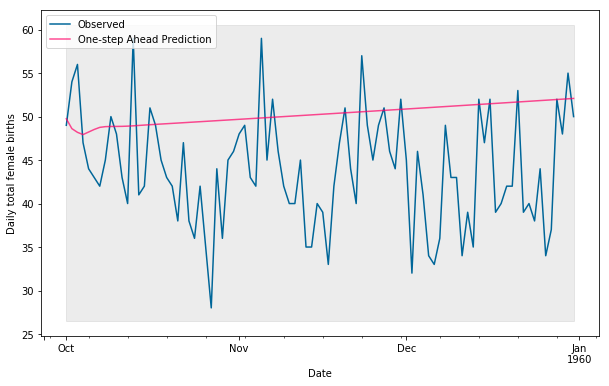

[9.21, 7.61, (7, 0, 1), (0, 0, 0, 14)]
RMSE:  9.209577389425915


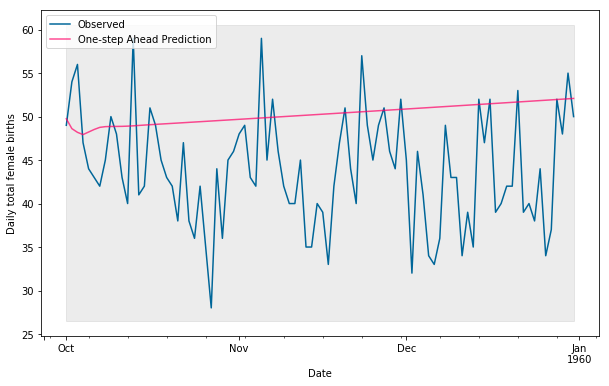

[9.21, 10.83, (2, 0, 0), (0, 1, 0, 7)]
RMSE:  9.208167496361252


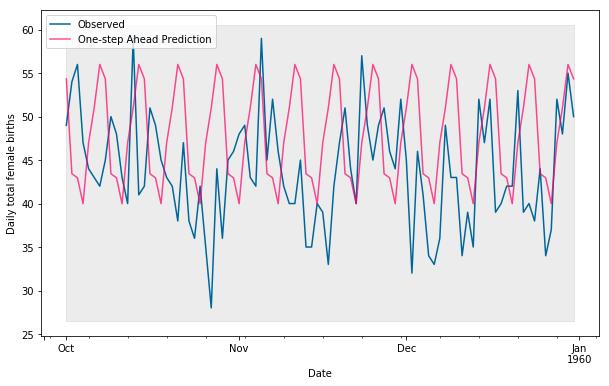

[9.21, 10.83, (2, 0, 1), (0, 1, 0, 7)]
RMSE:  9.207900032339506


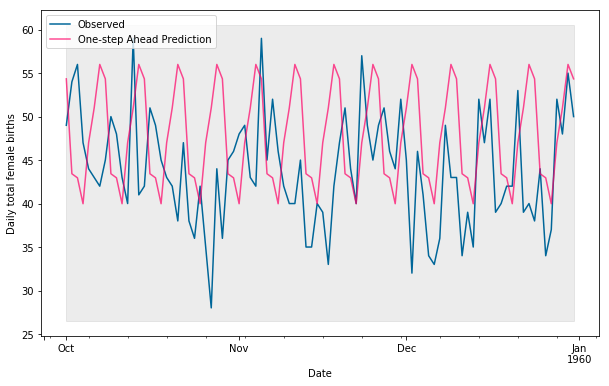

[9.21, 10.85, (1, 0, 0), (0, 1, 0, 7)]
RMSE:  9.212363016690523


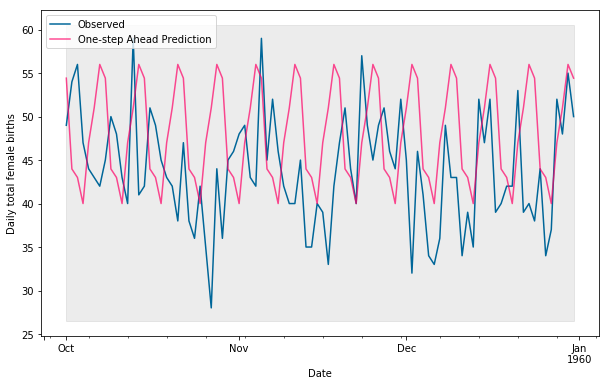

[9.22, 7.72, (7, 0, 1), (0, 0, 1, 14)]
RMSE:  9.22111735085376


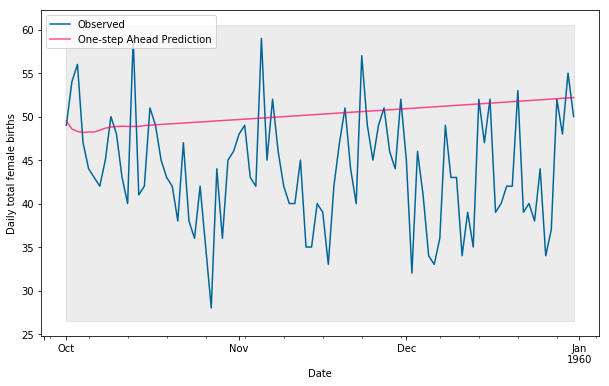

[9.24, 8.14, (2, 1, 1), (7, 0, 1, 7)]
RMSE:  9.243393989319069


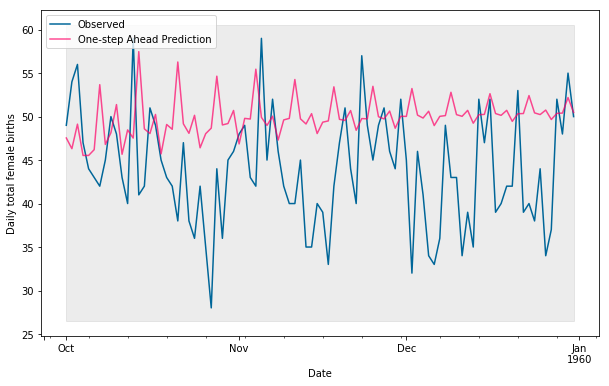

[9.26, 9.26, (7, 0, 0), (1, 1, 0, 4)]
RMSE:  9.262349637636794


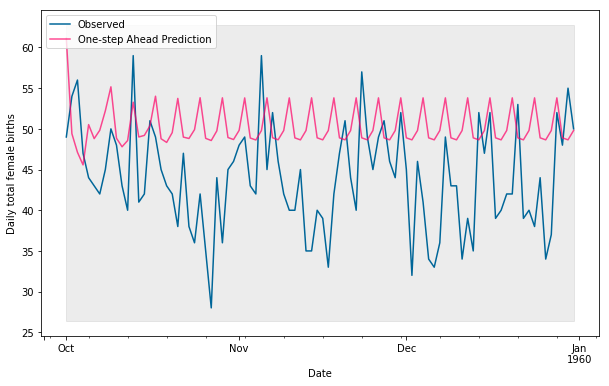

[9.26, 11.68, (1, 0, 0), (2, 1, 1, 14)]
RMSE:  9.256551518444994


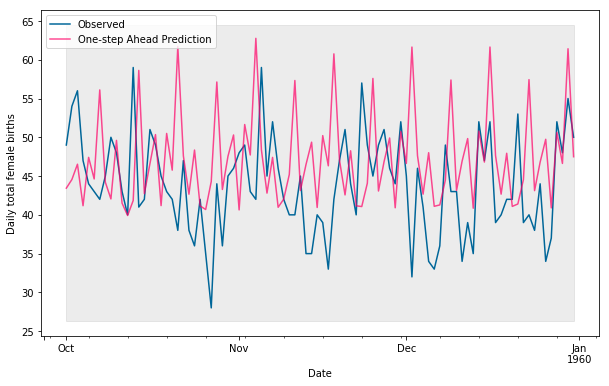

[9.27, 9.35, (1, 0, 1), (1, 1, 0, 4)]
RMSE:  9.27485899837945


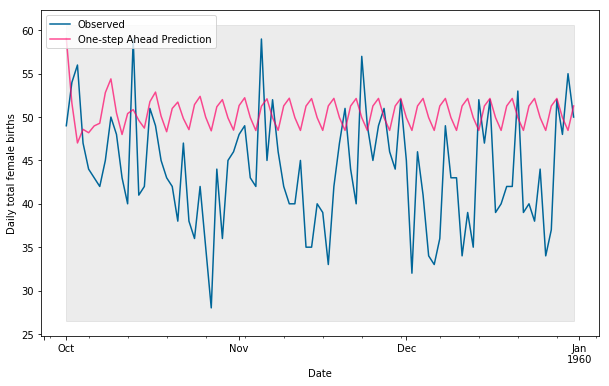

[9.27, 9.45, (1, 0, 0), (1, 1, 0, 4)]
RMSE:  9.27045481592464


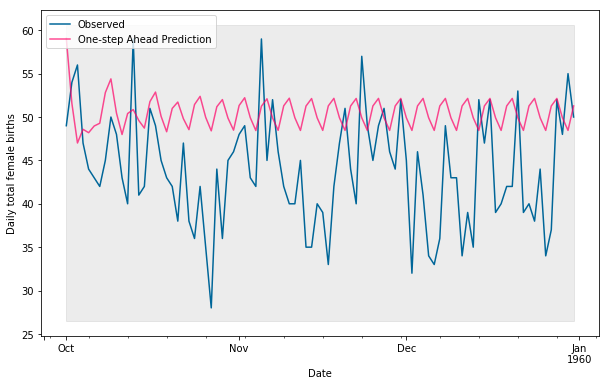

[9.27, 11.53, (2, 0, 0), (2, 1, 1, 14)]
RMSE:  9.269860294764399


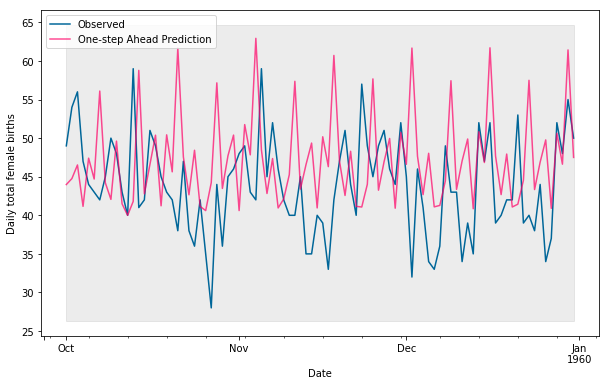

[9.28, 9.43, (2, 0, 0), (1, 1, 0, 4)]
RMSE:  9.284306552951557


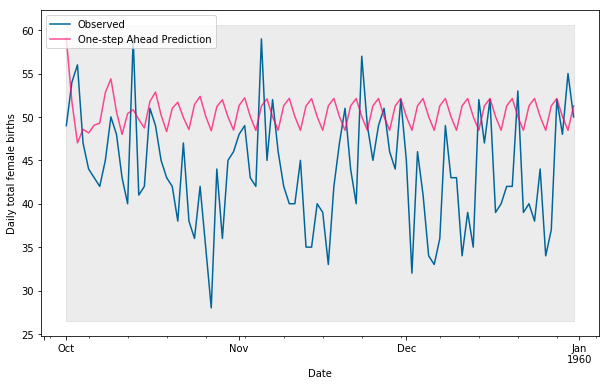

[9.3, 9.78, (7, 0, 1), (2, 1, 1, 7)]
RMSE:  9.304585532296867


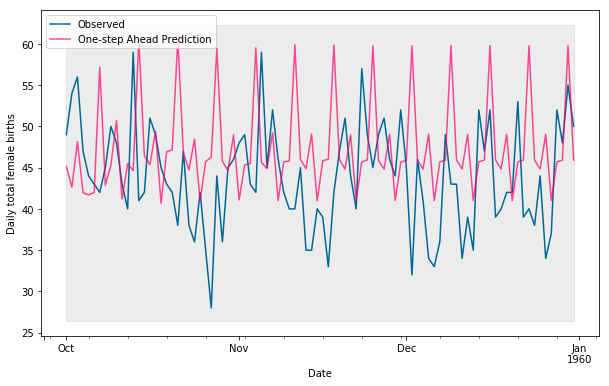

[9.33, 7.89, (7, 1, 1), (0, 1, 1, 4)]
RMSE:  9.328404240483833


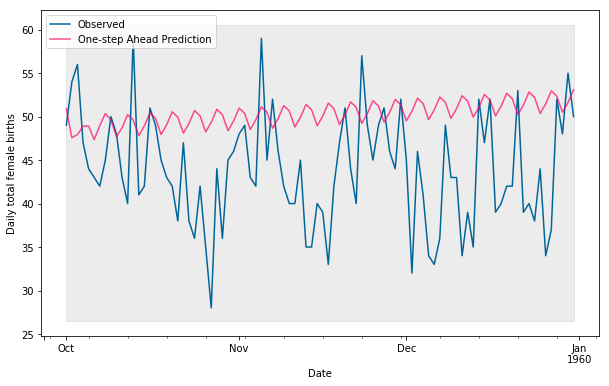

[9.33, 9.89, (7, 0, 1), (2, 1, 0, 4)]
RMSE:  9.328518330615287


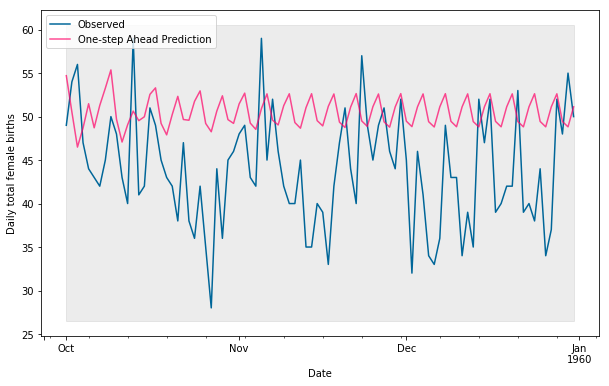

[9.34, 8.63, (2, 1, 1), (7, 0, 0, 14)]
RMSE:  9.339008108425707


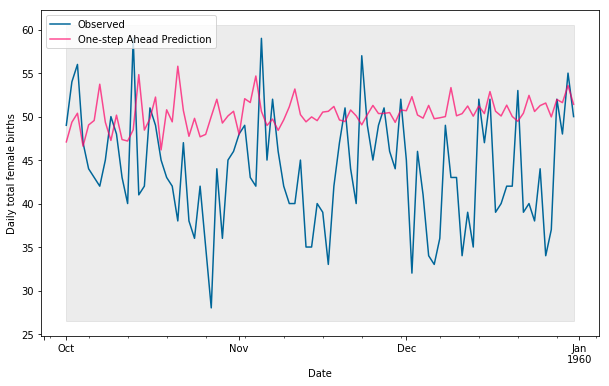

[9.34, 8.67, (2, 1, 1), (7, 0, 1, 14)]
RMSE:  9.34234594732193


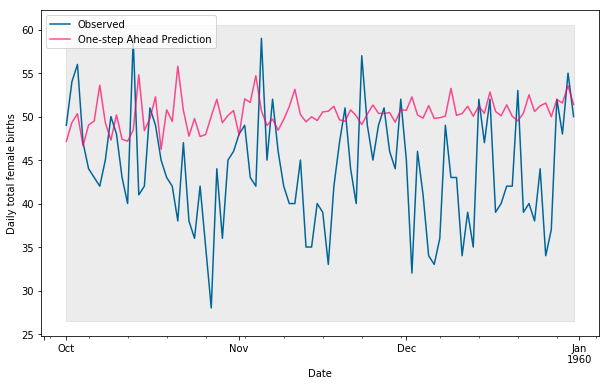

[9.37, 8.7, (7, 0, 0), (1, 0, 1, 7)]
RMSE:  9.36595433725246


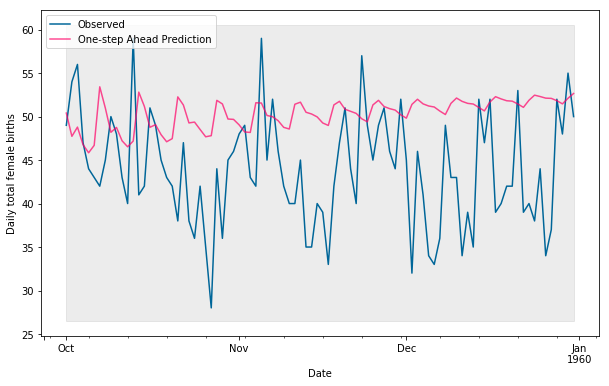

[9.43, 10.24, (1, 0, 0), (2, 0, 0, 7)]
RMSE:  9.426840824460193


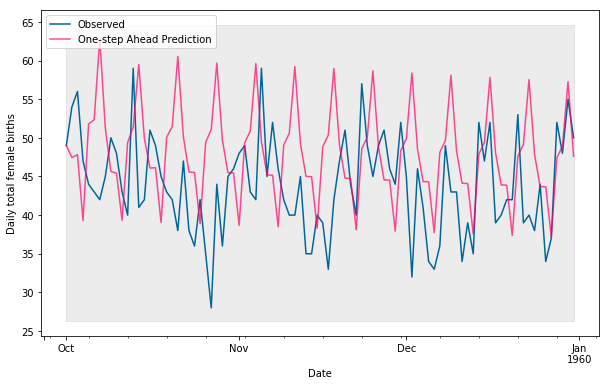

[9.48, 8.36, (2, 1, 0), (1, 0, 1, 7)]
RMSE:  9.481129144345925


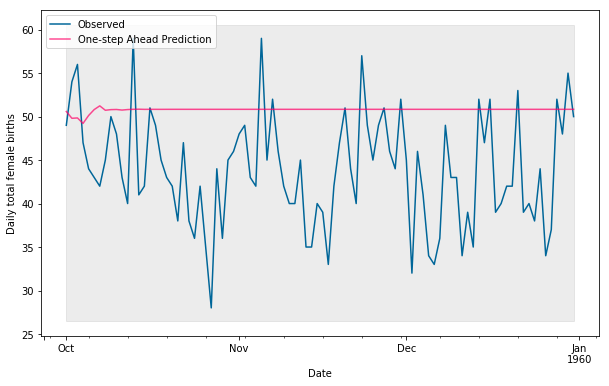

[9.5, 8.07, (7, 0, 0), (2, 0, 1, 4)]
RMSE:  9.496014659924882


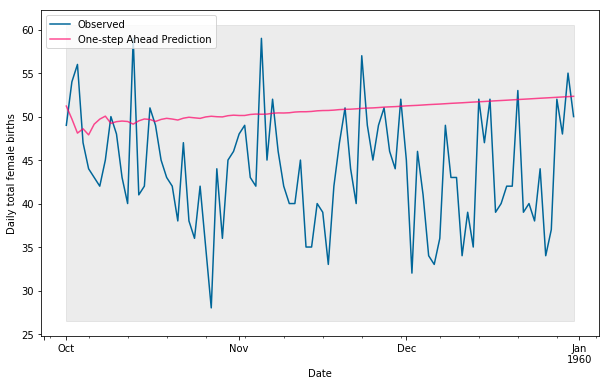

[9.51, 8.36, (2, 1, 0), (0, 0, 1, 7)]
RMSE:  9.510666044112309


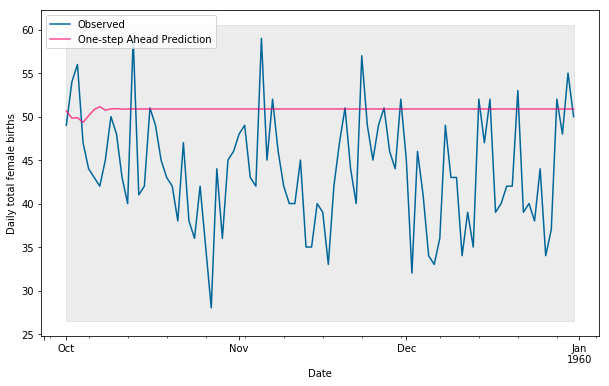

[9.54, 7.84, (7, 0, 1), (1, 0, 1, 4)]
RMSE:  9.53881843039956


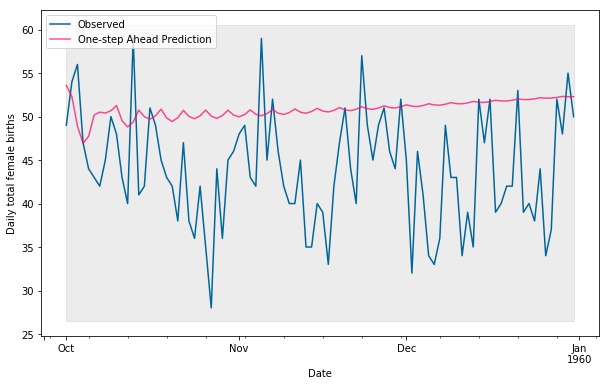

[9.56, 8.85, (1, 0, 0), (7, 0, 1, 4)]
RMSE:  9.555386365622791


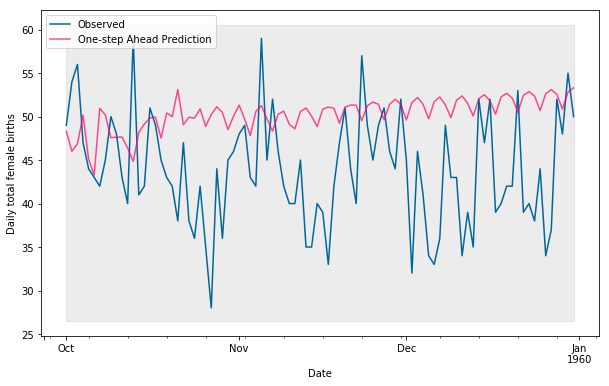

[9.56, 9.05, (7, 0, 0), (2, 1, 0, 4)]
RMSE:  9.562517290453181


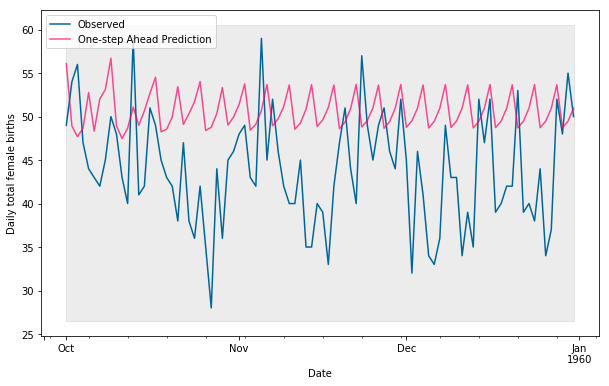

[9.58, 7.71, (7, 0, 1), (2, 0, 1, 4)]
RMSE:  9.582922993184432


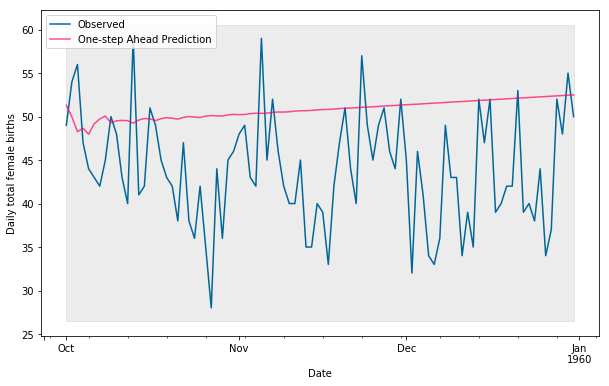

[9.61, 8.37, (2, 1, 0), (2, 0, 0, 7)]
RMSE:  9.612957894084948


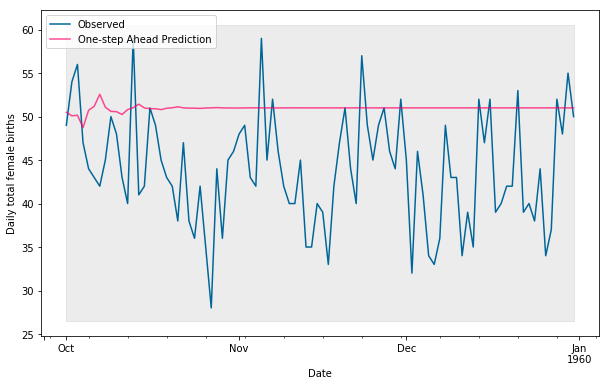

[9.63, 8.93, (2, 0, 0), (7, 0, 1, 4)]
RMSE:  9.628786907691323


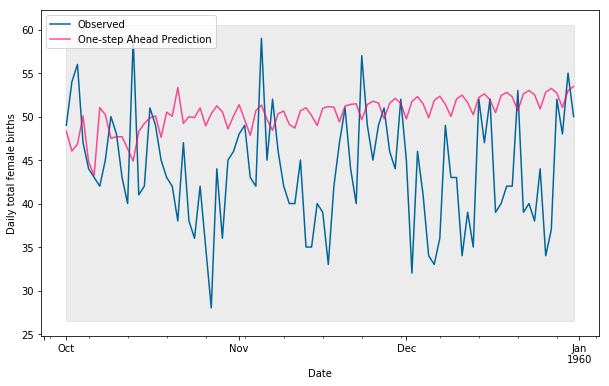

[9.64, 7.6, (7, 1, 0), (7, 0, 1, 14)]
RMSE:  9.643981477714831


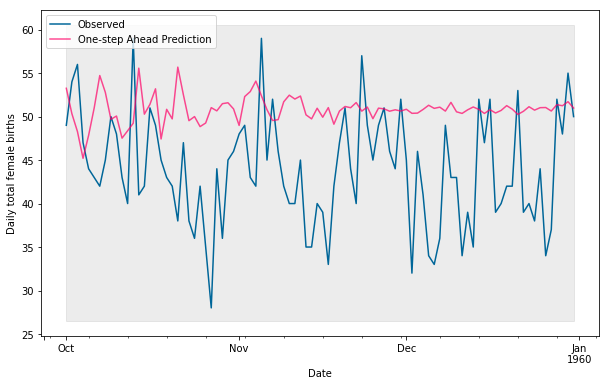

[9.65, 7.61, (7, 1, 0), (7, 0, 0, 14)]
RMSE:  9.64574691921719


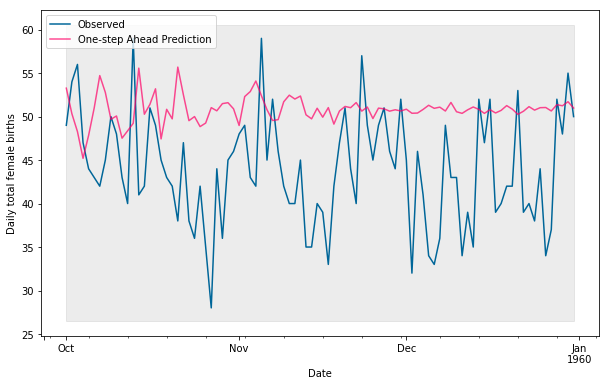

[9.65, 11.96, (7, 0, 0), (7, 0, 1, 14)]
RMSE:  9.651580078608658


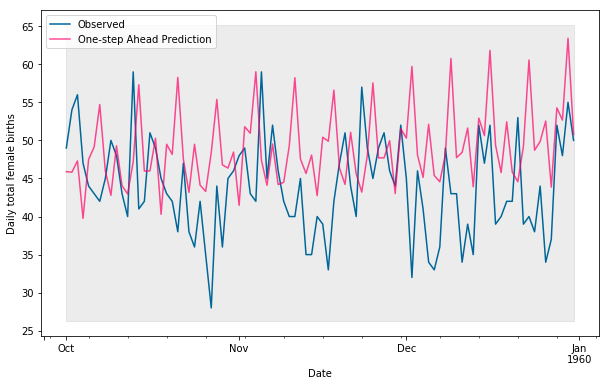

[9.66, 7.88, (7, 0, 1), (7, 0, 1, 4)]
RMSE:  9.657618489285753


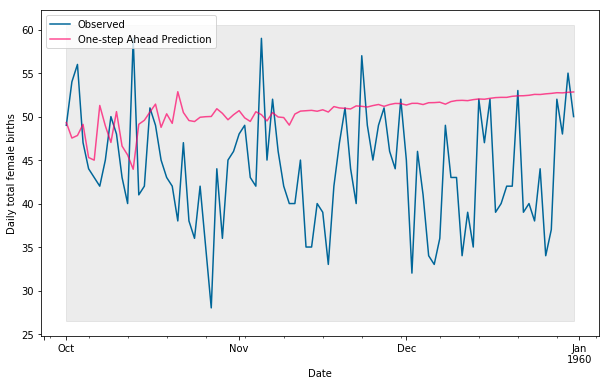

[9.68, 8.37, (2, 1, 0), (1, 0, 0, 7)]
RMSE:  9.681618730713108


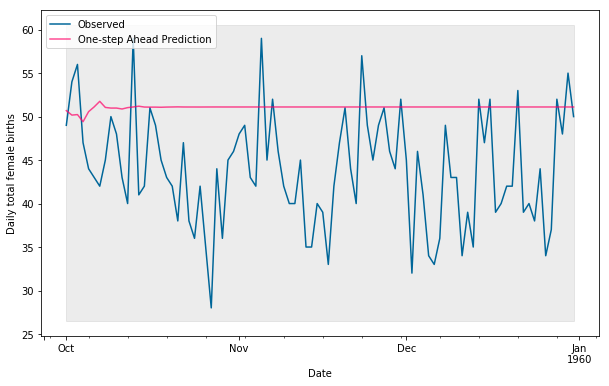

[9.69, 8.68, (1, 0, 1), (2, 1, 0, 4)]
RMSE:  9.686691195812804


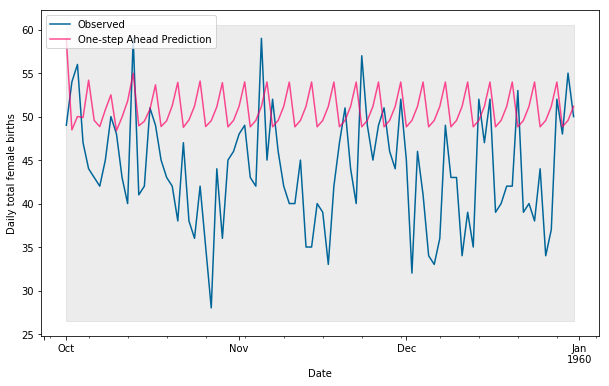

[9.7, 7.98, (1, 0, 1), (7, 0, 1, 4)]
RMSE:  9.702782811202876


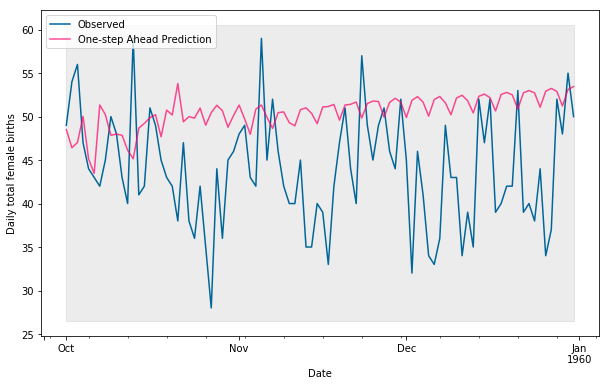

[9.7, 9.24, (2, 0, 0), (2, 1, 0, 4)]
RMSE:  9.699554500099227


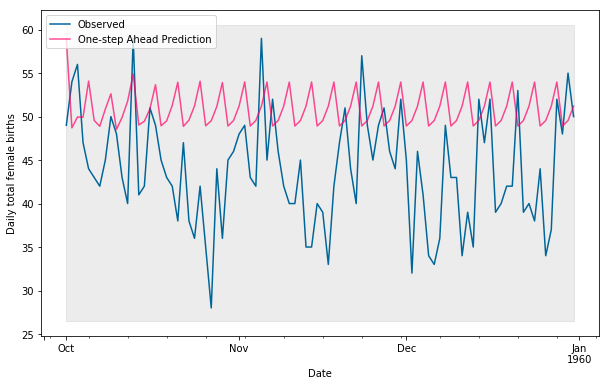

[9.7, 10.84, (1, 0, 0), (7, 0, 0, 4)]
RMSE:  9.698729257158849


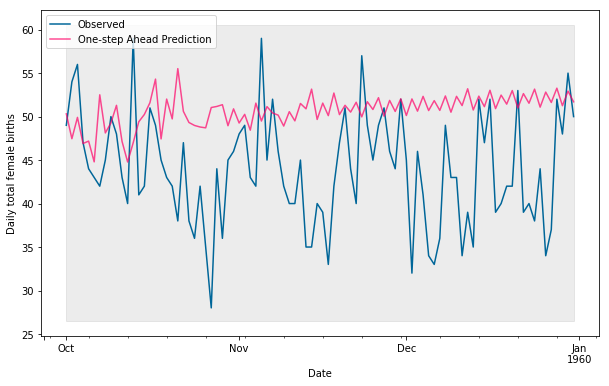

[9.7, 12.77, (2, 0, 0), (7, 0, 1, 14)]
RMSE:  9.70293922667756


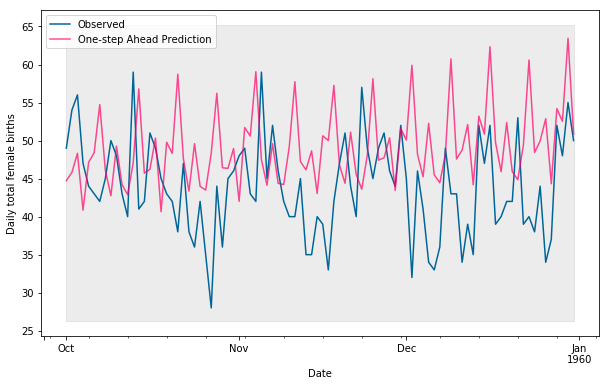

[9.71, 9.25, (1, 0, 0), (2, 1, 0, 4)]
RMSE:  9.706615883131033


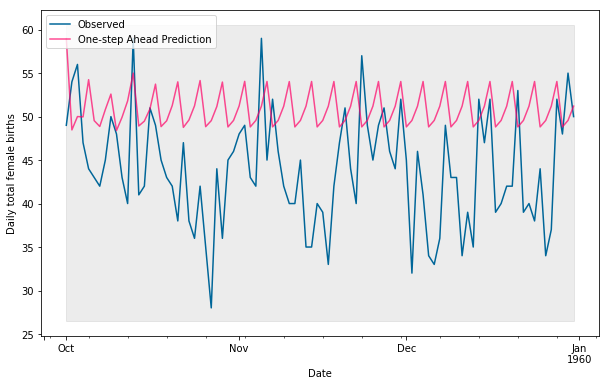

[9.71, 9.68, (1, 0, 0), (7, 1, 0, 7)]
RMSE:  9.710408529682981


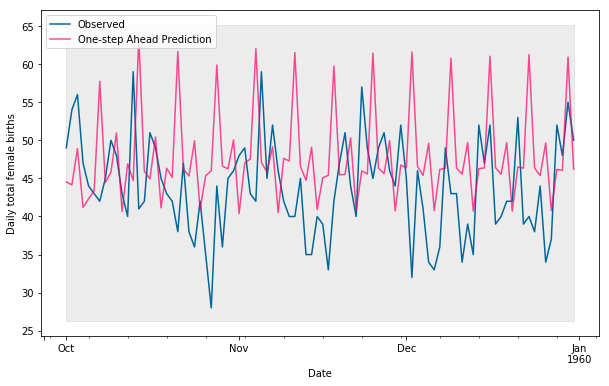

[9.72, 9.75, (1, 0, 1), (7, 1, 0, 7)]
RMSE:  9.717546150507687


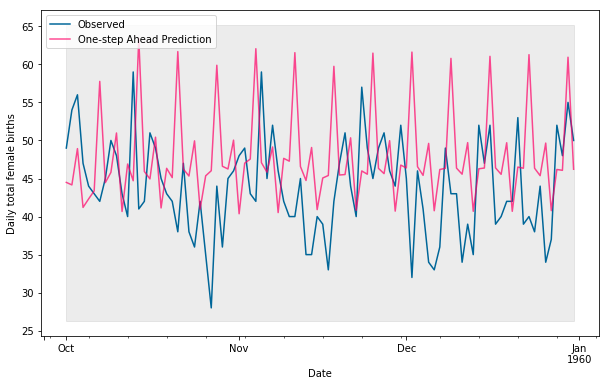

[9.73, 8.86, (2, 0, 1), (2, 1, 1, 14)]
RMSE:  9.727864459754263


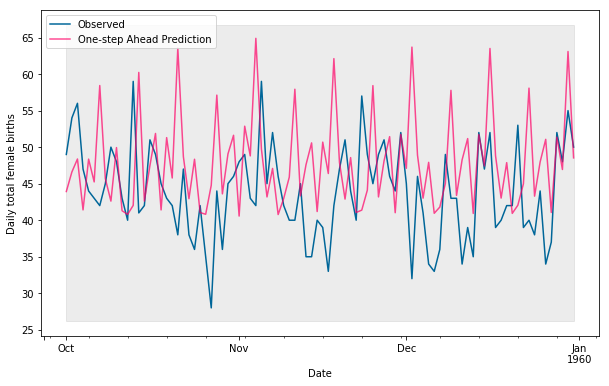

[9.73, 11.85, (2, 0, 0), (2, 1, 0, 14)]
RMSE:  9.726163318554454


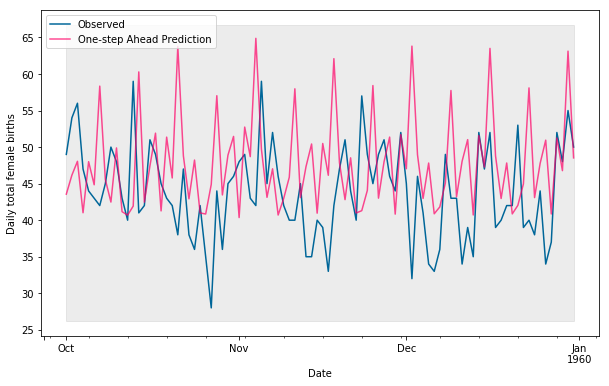

[9.73, 11.92, (1, 0, 0), (2, 1, 0, 14)]
RMSE:  9.733301318012662


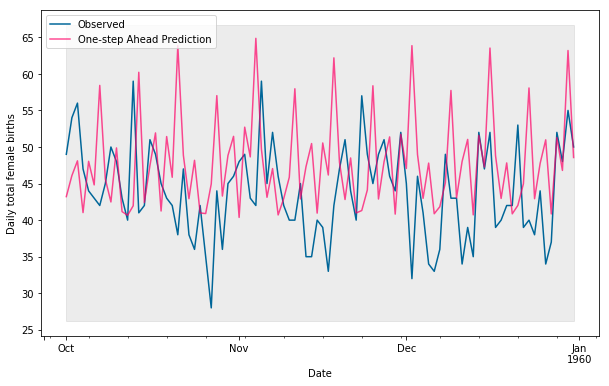

[9.74, 8.46, (7, 0, 0), (7, 0, 1, 4)]
RMSE:  9.740446162454619


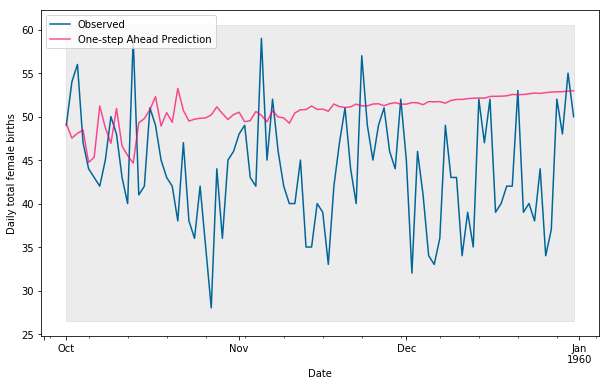

[9.74, 8.77, (1, 0, 1), (2, 1, 1, 14)]
RMSE:  9.7352653510436


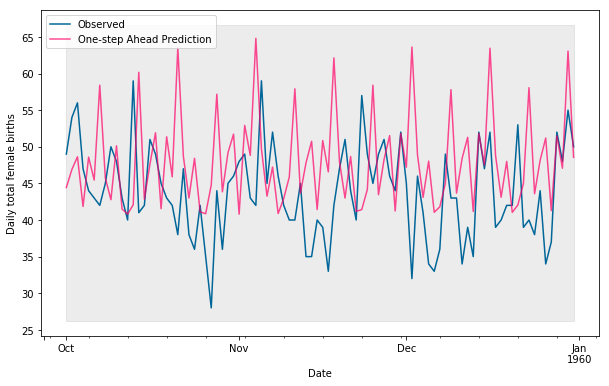

[9.74, 9.7, (2, 0, 0), (7, 1, 0, 7)]
RMSE:  9.739235825707878


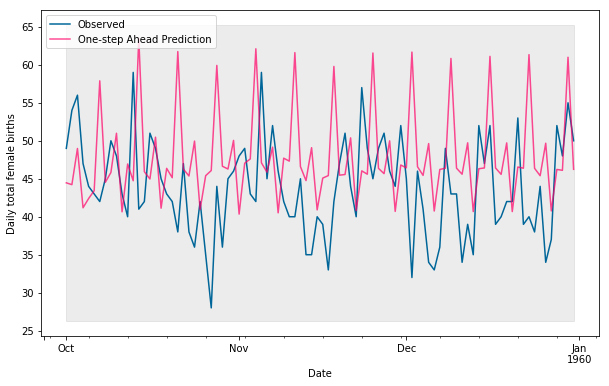

[9.75, 10.87, (2, 0, 0), (7, 0, 0, 4)]
RMSE:  9.75333155996106


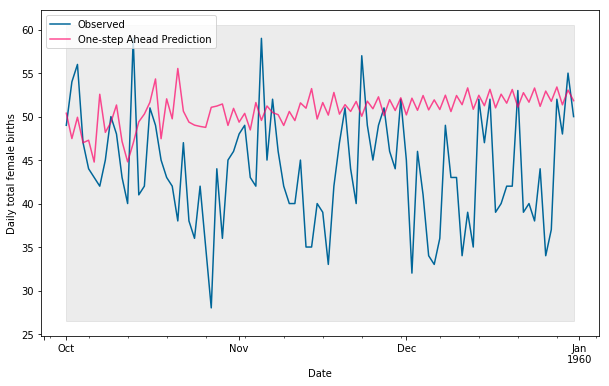

[9.75, 11.83, (7, 0, 0), (2, 1, 0, 14)]
RMSE:  9.75351211755686


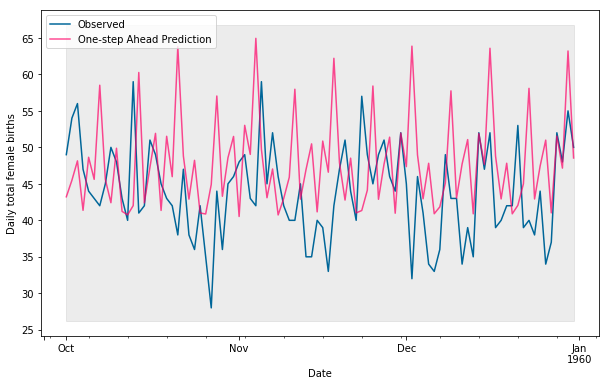

[9.75, 13.02, (1, 0, 1), (7, 0, 0, 14)]
RMSE:  9.752701973923184


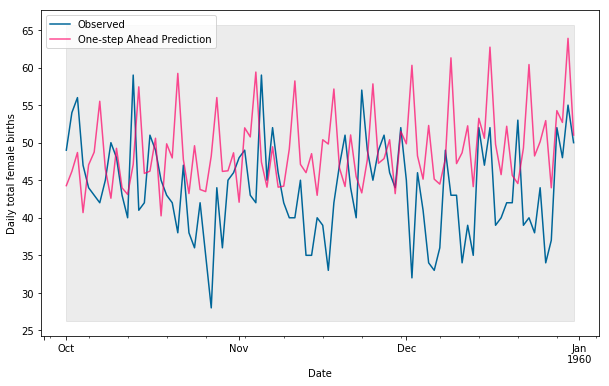

[9.76, 8.46, (7, 0, 0), (2, 0, 0, 4)]
RMSE:  9.758737231963847


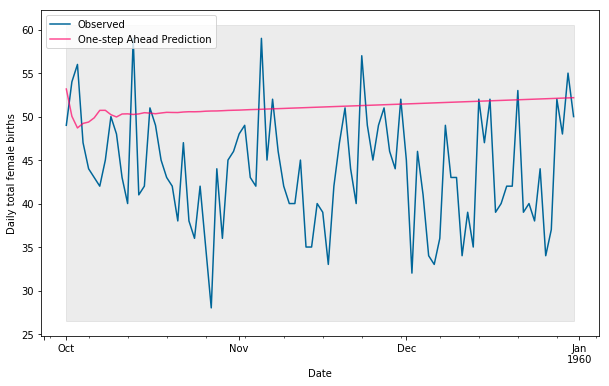

[9.76, 14.0, (1, 0, 0), (7, 0, 0, 14)]
RMSE:  9.758138043692957


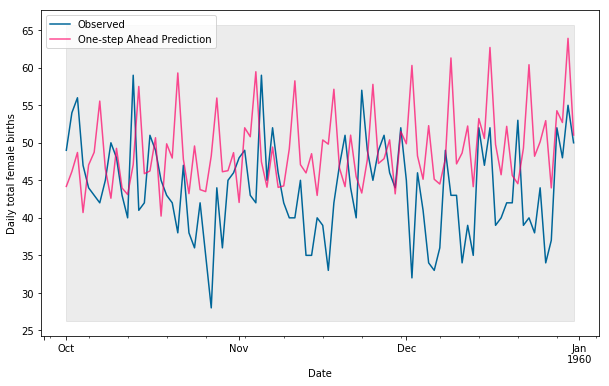

[9.77, 8.08, (2, 0, 1), (7, 0, 1, 4)]
RMSE:  9.771395606057126


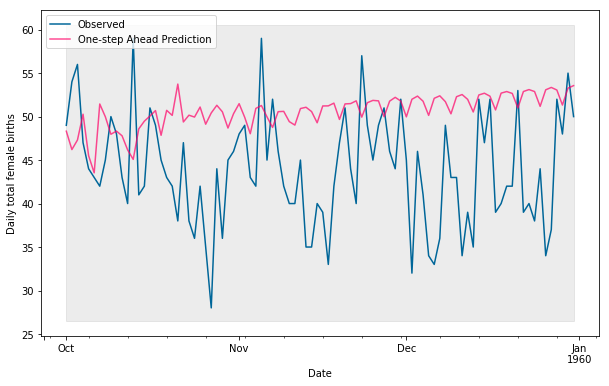

[9.77, 8.86, (2, 0, 1), (2, 1, 0, 14)]
RMSE:  9.769983756681293


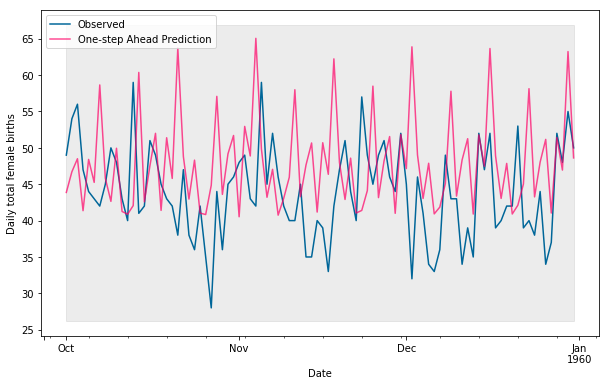

[9.77, 9.11, (2, 0, 1), (7, 1, 0, 7)]
RMSE:  9.767806507877715


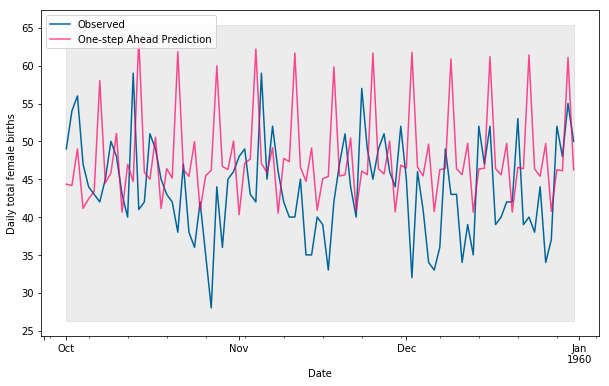

[9.77, 9.97, (2, 0, 1), (7, 1, 1, 7)]
RMSE:  9.770299678420184


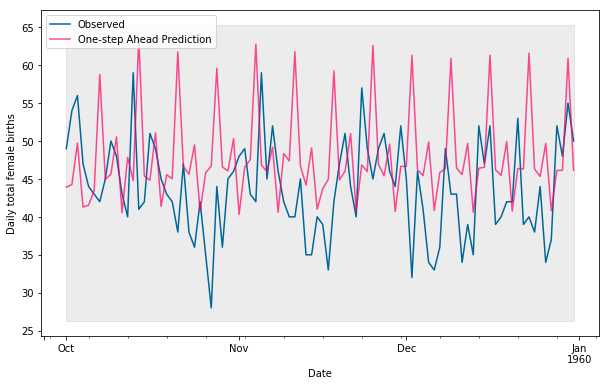

[9.77, 10.51, (7, 0, 1), (7, 1, 0, 7)]
RMSE:  9.770342351010457


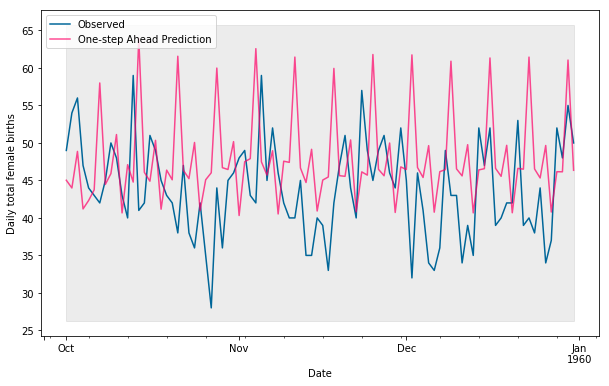

[9.78, 10.47, (1, 0, 0), (7, 1, 1, 7)]
RMSE:  9.780717978582814


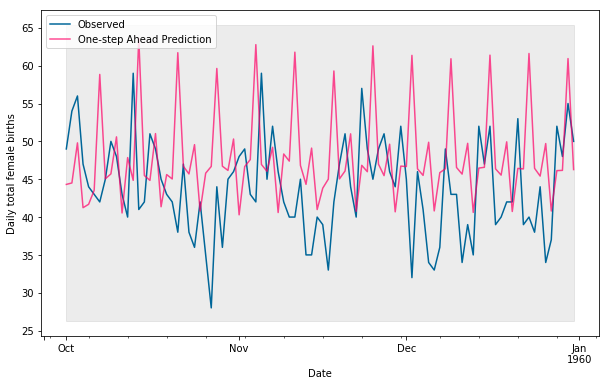

[9.79, 10.55, (2, 0, 0), (7, 1, 1, 7)]
RMSE:  9.792645630771426


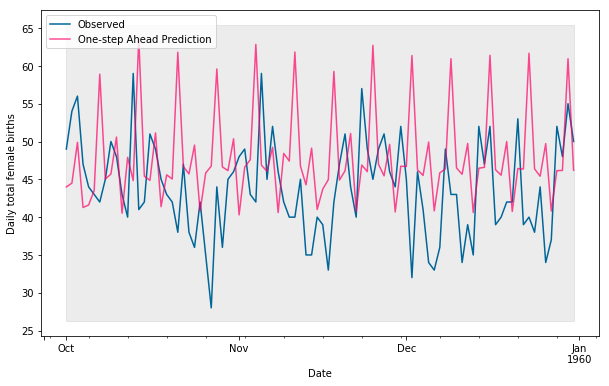

[9.79, 10.61, (1, 0, 1), (7, 1, 1, 7)]
RMSE:  9.794606585667374


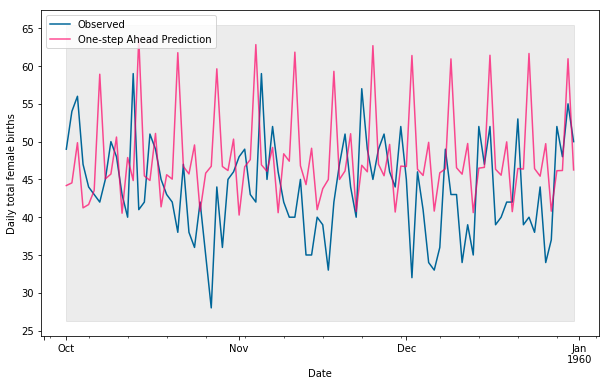

[9.8, 13.55, (1, 0, 1), (7, 0, 1, 14)]
RMSE:  9.801533303023708


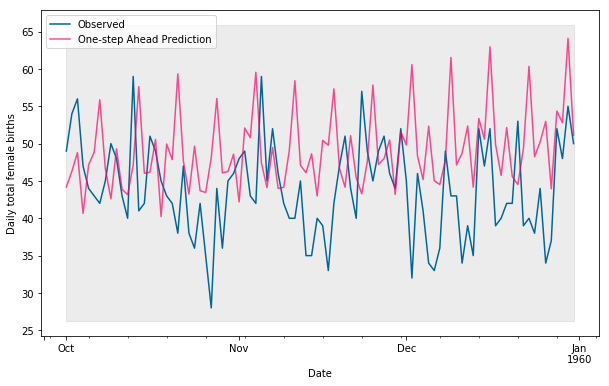

[9.81, 14.52, (1, 0, 0), (7, 0, 1, 14)]
RMSE:  9.80529901678694


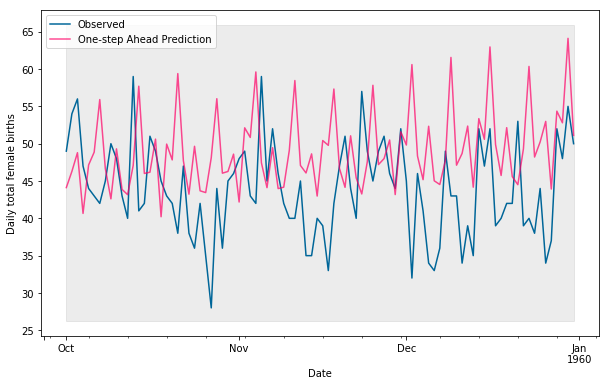

[9.82, 9.85, (7, 0, 0), (2, 1, 0, 7)]
RMSE:  9.823773665834242


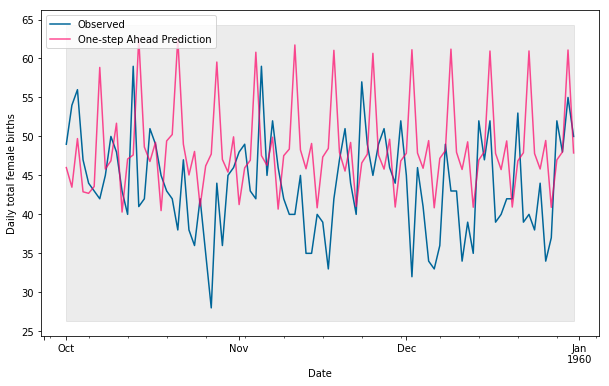

[9.83, 8.77, (1, 0, 1), (2, 1, 0, 14)]
RMSE:  9.825863213734333


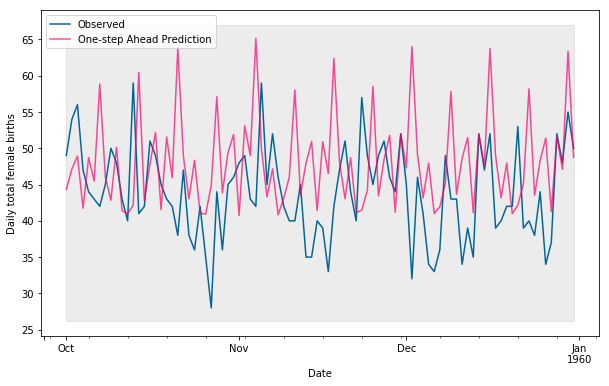

[9.83, 10.06, (7, 0, 1), (2, 1, 0, 7)]
RMSE:  9.831306431718485


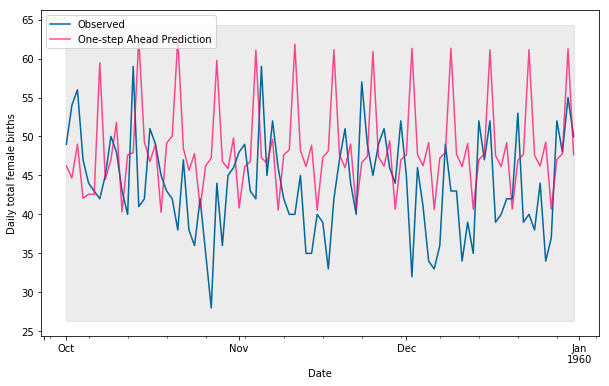

[9.83, 13.01, (7, 0, 0), (7, 0, 0, 14)]
RMSE:  9.834744129550678


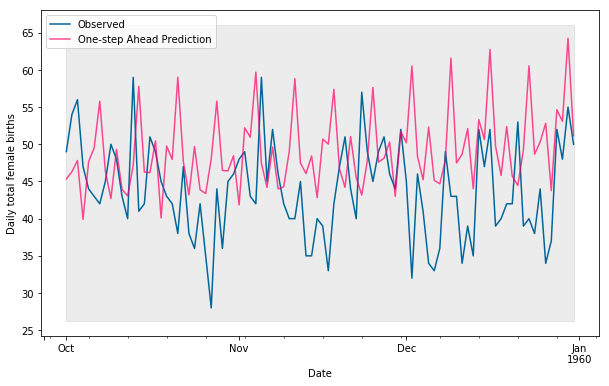

[9.83, 13.79, (2, 0, 0), (7, 0, 0, 14)]
RMSE:  9.831091221271784


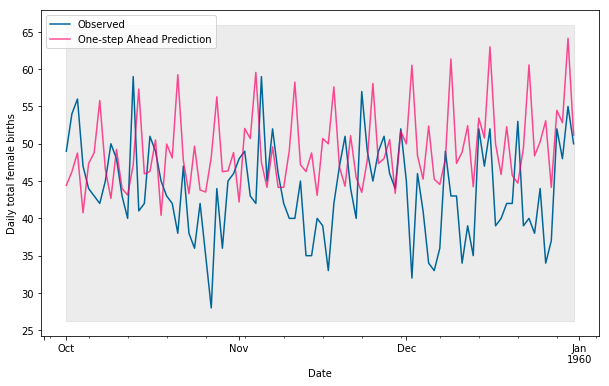

[9.84, 10.51, (2, 0, 1), (7, 0, 1, 14)]
RMSE:  9.844571943387816


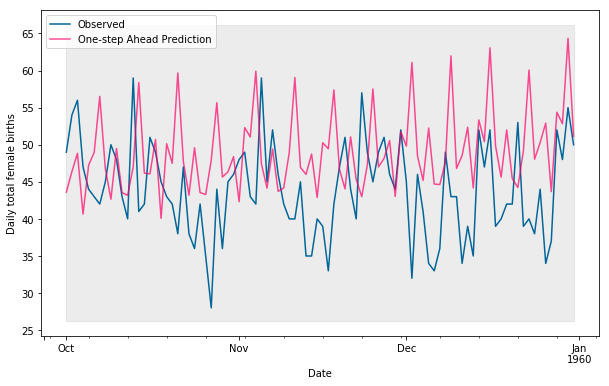

[9.88, 7.85, (7, 0, 1), (1, 0, 1, 7)]
RMSE:  9.883930598725856


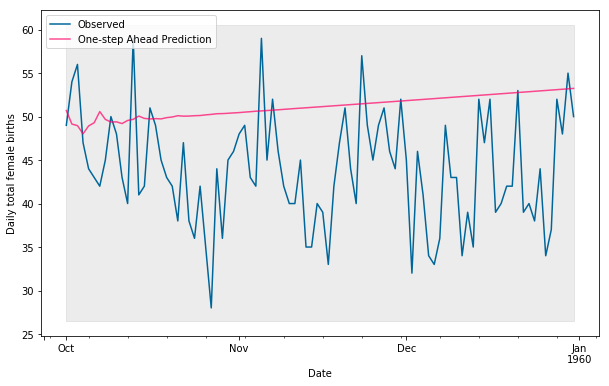

[9.94, 9.45, (7, 0, 1), (2, 1, 0, 14)]
RMSE:  9.942404873565364


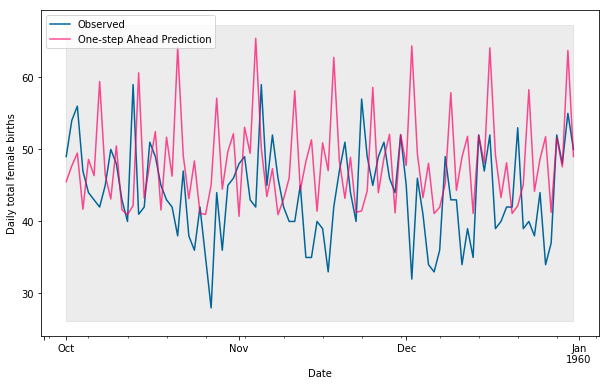

[9.97, 9.7, (1, 0, 0), (2, 1, 0, 7)]
RMSE:  9.96973310555318


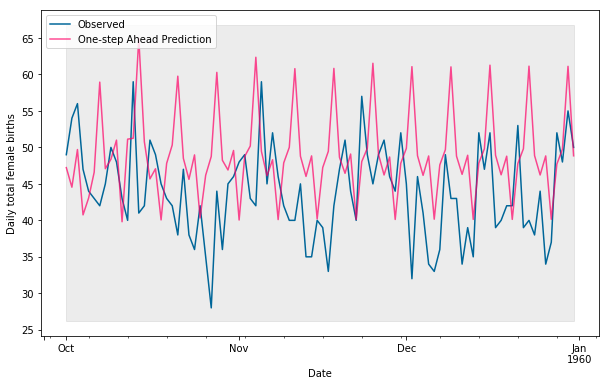

[9.98, 9.16, (1, 0, 1), (2, 1, 0, 7)]
RMSE:  9.975243985187731


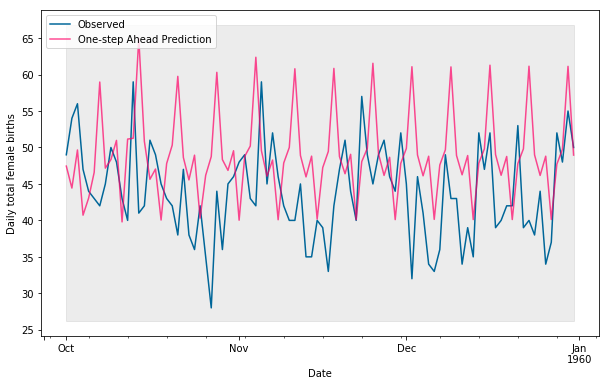

[9.98, 9.61, (2, 0, 0), (2, 1, 0, 7)]
RMSE:  9.977895548808874


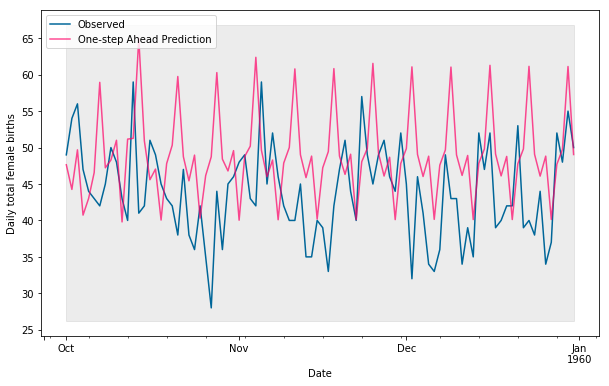

[9.98, 10.09, (2, 0, 1), (2, 1, 0, 7)]
RMSE:  9.982552256250102


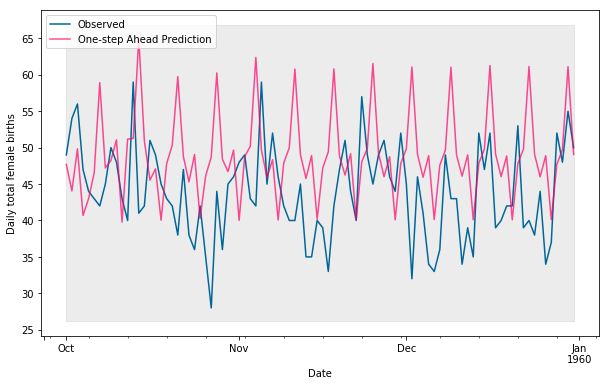

[9.99, 7.92, (7, 1, 0), (0, 1, 1, 4)]
RMSE:  9.989495166334471


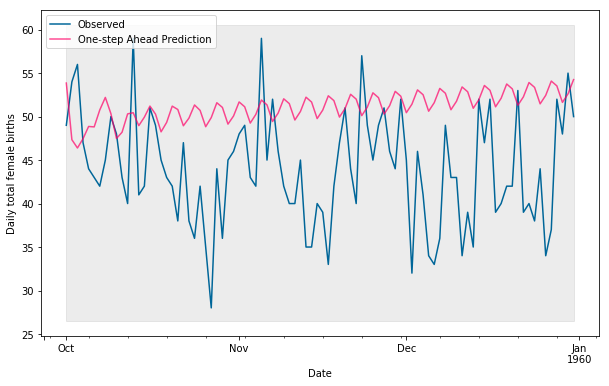

[10.0, 8.45, (2, 1, 1), (0, 1, 1, 14)]
RMSE:  10.002613202181665


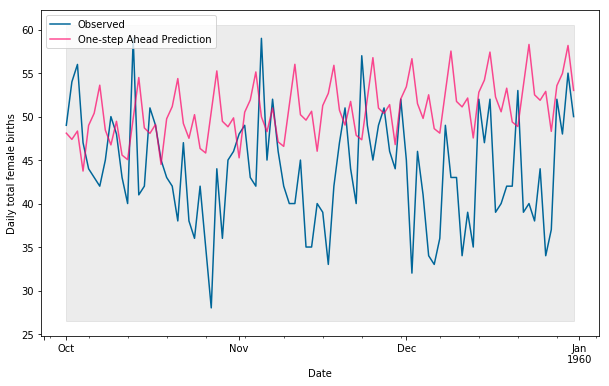

[10.0, 8.45, (2, 1, 1), (1, 1, 1, 14)]
RMSE:  9.996539774458885


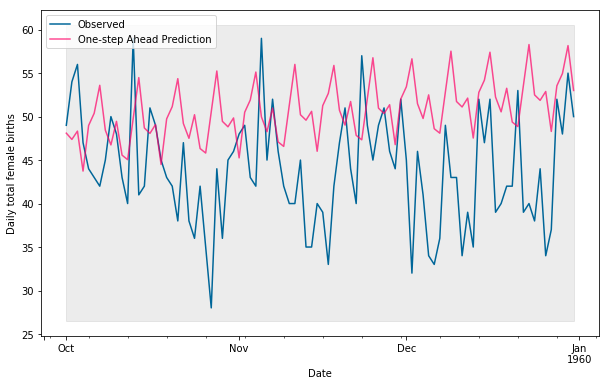

[10.04, 8.42, (7, 1, 1), (0, 1, 1, 14)]
RMSE:  10.036758498791638


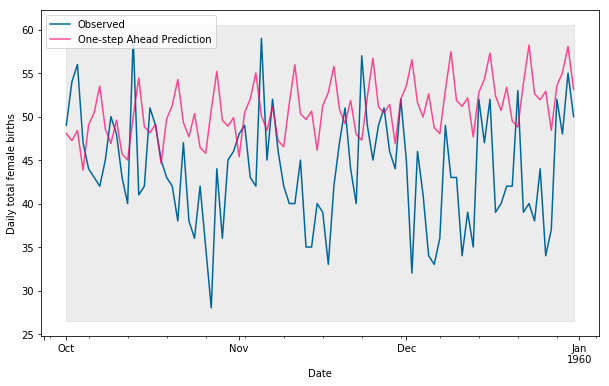

[10.04, 8.43, (1, 1, 1), (0, 1, 1, 14)]
RMSE:  10.04432301991886


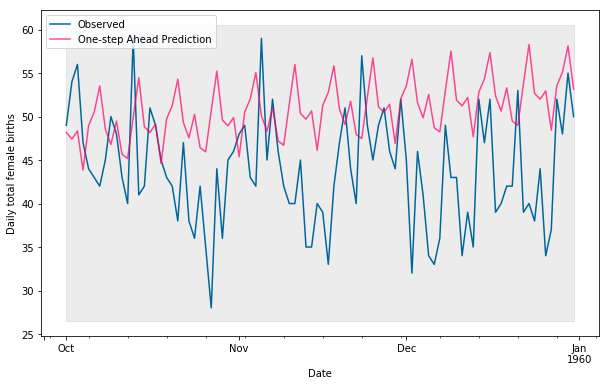

[10.05, 8.43, (1, 1, 1), (1, 1, 1, 14)]
RMSE:  10.046094997362898


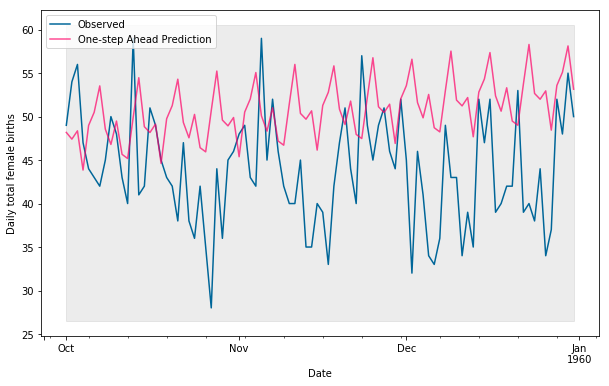

[10.08, 8.68, (7, 1, 1), (7, 0, 1, 14)]
RMSE:  10.081654294128231


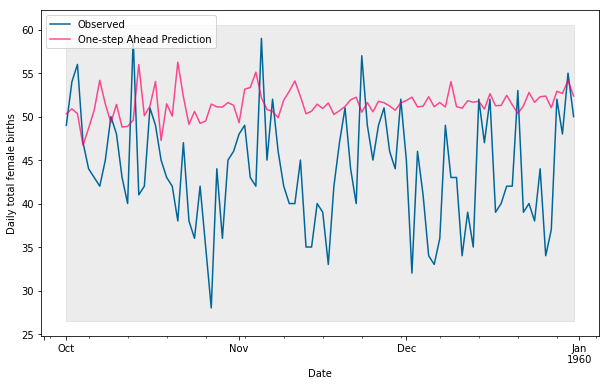

In [79]:
# define SARIMAX model and fit it to the data
for i in range(0,300):
    print(L[i])
    mdl = sm.tsa.statespace.SARIMAX(y_train,
                                    order=L[i][2],
                                    seasonal_order=L[i][3],
                                    enforce_stationarity=False,
                                    enforce_invertibility=True)
    res = mdl.fit()

    # fit model to data
    # in-sample-prediction and confidence bounds
    pred = res.get_prediction(start=pd.to_datetime('1959-10-01'), 
                              end=pd.to_datetime('1959-12-31'),
                              dynamic=False)
    pred_ci = pred.conf_int()


    from sklearn.metrics import mean_squared_error
    print('RMSE: ', np.sqrt(mean_squared_error(y['1959-10-01': ].values, pred.predicted_mean.values)))

    
    # plot in-sample-prediction
    plt.figure(figsize=(10, 6))
    ax = y['1959-10-01':].plot(label='Observed',color='#006699');
    pred.predicted_mean.plot(ax=ax, label='One-step Ahead Prediction', alpha=.7, color='#ff0066');
 
    # style the plot
    ax.fill_betweenx(ax.get_ylim(), pd.to_datetime('1959-10-01'), y.index[-1], alpha=.15, zorder=-1, color='grey');
    ax.set_xlabel('Date')
    ax.set_ylabel('Daily total female births')
    plt.legend(loc='upper left')
    plt.show()

In [34]:
y_train.size

273

In [36]:
tmp_mdl = sm.tsa.statespace.SARIMAX(y_train,
                                                order = (2, 1, 0),
                                                seasonal_order = (2, 1, 0, 7),
                                                enforce_stationarity=False,
                                                enforce_invertibility=False)
res = tmp_mdl.fit(n_jobs=-1)
pred = res.get_prediction(start=pd.to_datetime('1959-01-01'), 
                          end=pd.to_datetime('1959-09-30'),
                          dynamic=False)          
np.sqrt(mean_squared_error(y_train.values, pred.predicted_mean.values))

8.860479959985003